In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

## Loading ratings file

In [2]:
ratings_headers = ['user_id', 'movie_id', 'ratings', 'timestamp']
ratings = pd.read_table('ml-1m/ratings.dat', sep='::', header=None, names=ratings_headers)
ratings.head()

C:\Users\Aman Sharif\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  


,user_id,movie_id,ratings,timestamp
0,1,1193,5,978300760
1,1,661,3,978302109
2,1,914,3,978301968
3,1,3408,4,978300275
4,1,2355,5,978824291


## Loading users file

In [3]:
users_headers = ['user_id','gender','age','occupation','zip-code']
users = pd.read_table('ml-1m/users.dat', sep='::', header=None, names=users_headers)
users.head()

C:\Users\Aman Sharif\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  


,user_id,gender,age,occupation,zip-code
0,1,F,1,10,48067
1,2,M,56,16,70072
2,3,M,25,15,55117
3,4,M,45,7,02460
4,5,M,25,20,55455


## Loading movies file

In [4]:
movies_headers = ['movie_id', 'title', 'genres']
movies = pd.read_table('ml-1m/movies.dat',sep='::', header=None, names=movies_headers)
movies.head()

C:\Users\Aman Sharif\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  


,movie_id,title,genres
0,1,Toy Story (1995),Animation|Children's|Comedy
1,2,Jumanji (1995),Adventure|Children's|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama
4,5,Father of the Bride Part II (1995),Comedy


In [5]:
#movie_titles = movies.title.tolist()

## Joining three dataframes

In [6]:
df = users.join(ratings.set_index('user_id'), on=['user_id']).join(movies.set_index('movie_id'), on=['movie_id'])

In [7]:
df.head()

,user_id,gender,age,occupation,zip-code,movie_id,ratings,timestamp,title,genres
0,1,F,1,10,48067,1193,5,978300760,One Flew Over the Cuckoo's Nest (1975),Drama
0,1,F,1,10,48067,661,3,978302109,James and the Giant Peach (1996),Animation|Children's|Musical
0,1,F,1,10,48067,914,3,978301968,My Fair Lady (1964),Musical|Romance
0,1,F,1,10,48067,3408,4,978300275,Erin Brockovich (2000),Drama
0,1,F,1,10,48067,2355,5,978824291,"Bug's Life, A (1998)",Animation|Children's|Comedy


In [8]:
df.shape

(1000209, 10)

## Creating spreadsheet-style pivot table as a DataFrame

In [9]:
rp = df.pivot_table(columns=['movie_id'],index=['user_id'],values='ratings')
rp.head()

movie_id,1,2,3,4,5,6,7,8,9,10,...,3943,3944,3945,3946,3947,3948,3949,3950,3951,3952
user_id,,,,,,,,,,,,,,,,,,,,,
1,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
rp.tail()

movie_id,1,2,3,4,5,6,7,8,9,10,...,3943,3944,3945,3946,3947,3948,3949,3950,3951,3952
user_id,,,,,,,,,,,,,,,,,,,,,
6036,NaN,NaN,NaN,2.0,NaN,3.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6037,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6038,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6039,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6040,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
rp.shape

(6040, 3706)

## Filling NaN with 0

In [12]:
rp = rp.fillna(0); # Replace NaN
rp.head()

movie_id,1,2,3,4,5,6,7,8,9,10,...,3943,3944,3945,3946,3947,3948,3949,3950,3951,3952
user_id,,,,,,,,,,,,,,,,,,,,,
1,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Extracting values from rp dataframe

In [13]:
Q = rp.values

In [14]:
Q

array([[5., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [3., 0., 0., ..., 0., 0., 0.]])

In [15]:
Q.shape

(6040, 3706)

## Creation of Weighted Matrix

In [16]:
W = Q>0.5
W[W == True] = 1
W[W == False] = 0
# To be consistent with our Q matrix
W = W.astype(np.float64, copy=False)

In [17]:
W

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]])

## Initialization of parameters

In [18]:
lambda_ = 0.1
n_factors = 100
m, n = Q.shape
n_iterations = 20

## Initialization of Factor matrices

In [19]:
#X = 5 * np.random.rand(m, n_factors) 
#Y = 5 * np.random.rand(n_factors, n)

## Defining Error measure

In [20]:
def get_error(Q, X, Y, W):
    return np.sum((W * (Q - np.dot(X, Y)))**2)

## Without weighted matrice training

In [21]:
'''errors = []
for ii in range(n_iterations):
    X = np.linalg.solve(np.dot(Y, Y.T) + lambda_ * np.eye(n_factors), np.dot(Y, Q.T)).T
    Y = np.linalg.solve(np.dot(X.T, X) + lambda_ * np.eye(n_factors),np.dot(X.T, Q))
    if ii % 100 == 0:
        print('{}th iteration is completed'.format(ii))
    errors.append(get_error(Q, X, Y, W))
Q_hat = np.dot(X, Y)
print('Error of rated movies: {}'.format(get_error(Q, X, Y, W)))'''

"errors = []\nfor ii in range(n_iterations):\n    X = np.linalg.solve(np.dot(Y, Y.T) + lambda_ * np.eye(n_factors), np.dot(Y, Q.T)).T\n    Y = np.linalg.solve(np.dot(X.T, X) + lambda_ * np.eye(n_factors),np.dot(X.T, Q))\n    if ii % 100 == 0:\n        print('{}th iteration is completed'.format(ii))\n    errors.append(get_error(Q, X, Y, W))\nQ_hat = np.dot(X, Y)\nprint('Error of rated movies: {}'.format(get_error(Q, X, Y, W)))"

In [22]:
#plt.plot(errors);

## Again Initialization of Factor matrices for next job

In [23]:
X = 5 * np.random.rand(m, n_factors) 
Y = 5 * np.random.rand(n_factors, n)

## ALS

In [24]:
weighted_errors = []
for ii in range(n_iterations):
    for u, Wu in enumerate(W):
        X[u] = np.linalg.solve(np.dot(Y, np.dot(np.diag(Wu), Y.T)) + lambda_ * np.eye(n_factors),np.dot(Y, np.dot(np.diag(Wu), Q[u].T))).T
    for i, Wi in enumerate(W.T):
        Y[:,i] = np.linalg.solve(np.dot(X.T, np.dot(np.diag(Wi), X)) + lambda_ * np.eye(n_factors),np.dot(X.T, np.dot(np.diag(Wi), Q[:, i])))
    weighted_errors.append(get_error(Q, X, Y, W))
    print('{}th iteration is completed'.format(ii))
weighted_Q_hat = np.dot(X,Y)
print('Error of rated movies: {}'.format(get_error(Q, X, Y, W)))

0th iteration is completed
1th iteration is completed
2th iteration is completed
3th iteration is completed
4th iteration is completed
5th iteration is completed
6th iteration is completed
7th iteration is completed
8th iteration is completed
9th iteration is completed
10th iteration is completed
11th iteration is completed
12th iteration is completed
13th iteration is completed
14th iteration is completed
15th iteration is completed
16th iteration is completed
17th iteration is completed
18th iteration is completed
19th iteration is completed
Error of rated movies: 118081.19966561058


## ALS performance visualization

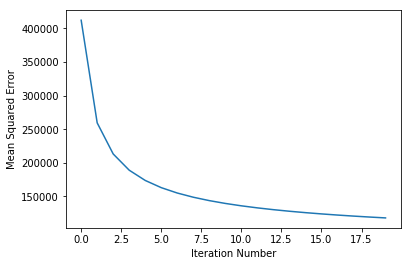

In [25]:
plt.plot(weighted_errors);
plt.xlabel('Iteration Number');
plt.ylabel('Mean Squared Error');

In [31]:
def print_recommendations(Q_hat,W=W, Q=Q, movie_titles=movie_titles):
    #Q_hat -= np.min(Q_hat)
    #Q_hat[Q_hat < 1] *= 5
    Q_hat -= np.min(Q_hat)
    Q_hat *= float(5) / np.max(Q_hat)
    movie_ids = np.argmax(Q_hat - 5 * W, axis=1)
    for jj, movie_id in zip(range(m), movie_ids):
        #if Q_hat[jj, movie_id] < 0.1: continue
        print('User {} liked {}\n'.format(jj + 1, ', '.join([movie_titles[ii] for ii, qq in enumerate(Q[jj]) if qq > 3])))
        print('User {} did not like {}\n'.format(jj + 1, ', '.join([movie_titles[ii] for ii, qq in enumerate(Q[jj]) if qq < 3 and qq != 0])))
        print('\n User {} recommended movie is {} - with predicted rating: {}'.format(
                    jj + 1, movie_titles[movie_id], Q_hat[jj, movie_id]))
        print('\n' + 100 *  '-' + '\n')
#print_recommendations()

In [32]:
print_recommendations(weighted_Q_hat)

User 1 liked Toy Story (1995), Pocahontas (1995), Amazing Panda Adventure, The (1995), Junior (1994), Rising Sun (1993), Romeo Is Bleeding (1993), Hour of the Pig, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Pretty Woman (1990), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), Kansas City (1996), 1-900 (1994), African Queen, The (1951), Something to Sing About (1937), Farewell to Arms, A (1932), Picnic (1955), Unhook the Stars (1996), People vs. Larry Flynt, The (1996), Talking About Sex (1994), Best of the Best 3: No Turning Back (1995), Star Wars: Episode V - The Empire Strikes Back (1980), GoodFellas (1990), Kolya (1996), Donnie Brasco (1997), Peacemaker, The (1997), Harlem River Drive (1996), King of New York (1990), I Love You, Don't Touch Me! (1998), Leather Jacket Love Story (1997), Mulan (1998), Armageddon (1998), Next Stop, Wonderland (1998), Rounders (1998), Lilian's Story (1995), I Stand Al

User 9 liked Toy Story (1995), Casino (1995), Leaving Las Vegas (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Casper (1995), Boys on the Side (1995), Perez Family, The (1995), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Favor, The (1994), House Party 3 (1994), Ref, The (1994), Rising Sun (1993), Robocop 3 (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Delta of Venus (1994), Mouth to Mouth (Boca a boca) (1995), Close Shave, A (1995), Manny & Lo (1996), Ghost and Mrs. Muir, The (1947), D3: The Mighty Ducks (1996), Pete's Dragon (1977), Candidate, The (1972), Monty Python and the Holy Grail (1974), Everything Relative (1996), When We Were Kings (1996), JLG/JLG - autoportrait de décembre (1994), Tie Me Up! Tie Me Down! (1990), Sting, The (1973), Raise the Red Lantern (1991), Batman Returns (1992), Scream (1996), Crash (1996), Commandments (1997), Addicted to Love (1997), To Have, or Not (1995), G.I. Jane (1997), Money T

User 17 liked Shanghai Triad (Yao a yao yao dao waipo qiao) (1995), Twelve Monkeys (1995), Babe (1995), Usual Suspects, The (1995), Big Bully (1996), Catwalk (1995), Casper (1995), Clockers (1995), Congo (1995), Smoke (1995), Boys on the Side (1995), Dumb & Dumber (1994), Gordy (1995), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Perez Family, The (1995), Rent-a-Kid (1995), Stuart Saves His Family (1995), Swan Princess, The (1994), Client, The (1994), Being Human (1993), Color of Night (1994), Even Cowgirls Get the Blues (1993), Favor, The (1994), House Party 3 (1994), Rising Sun (1993), Robocop 3 (1993), Secret Garden, The (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Brady Bunch Movie, The (1995), Wild Bunch, The (1969), Loaded (1994), Windows (1980), Delta of Venus (1994), Of Love and Shadows (1994), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Crude Oasis, The (1995), Celestial Clockwork (1994),

User 25 liked Amazing Panda Adventure, The (1995), Boys on the Side (1995), Junior (1994), House Party 3 (1994), Simple Twist of Fate, A (1994), Bloodsport 2 (1995), Stupids, The (1996), Shall We Dance? (1937), Plutonium Circus (1995), On Golden Pond (1981), Jean de Florette (1986), Monty Python and the Holy Grail (1974), Star Wars: Episode V - The Empire Strikes Back (1980), Ran (1985), Young Frankenstein (1974), Gandhi (1982), Unbearable Lightness of Being, The (1988), Real Genius (1985), Best Men (1997), Love Jones (1997), Romy and Michele's High School Reunion (1997), Addicted to Love (1997), To Have, or Not (1995), Men in Black (1997), Money Talks (1997), Everest (1998), Newton Boys, The (1998), Children of Heaven, The (Bacheha-Ye Aseman) (1997), Dear Jesse (1997), Armageddon (1998), Who's Afraid of Virginia Woolf? (1966), Under Capricorn (1949), King Kong vs. Godzilla (Kingukongu tai Gojira) (1962), View to a Kill, A (1985), Lifeforce (1985), Violets Are Blue... (1986), Fantastic

User 33 liked Dead Man Walking (1995), Seven (Se7en) (1995), Headless Body in Topless Bar (1995), Amazing Panda Adventure, The (1995), Junior (1994), Stuart Saves His Family (1995), While You Were Sleeping (1995), Baby-Sitters Club, The (1995), Paper, The (1994), Black Beauty (1994), Even Cowgirls Get the Blues (1993), Hard Target (1993), House Party 3 (1994), Mr. Jones (1993), Harlem (1993), Wedding Gift, The (1994), Fausto (1993), Scorta, La (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Purple Noon (1960), Magic Hunter (1994), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Wife, The (1995), Kansas City (1996), Killer: A Journal of Murder (1995), Island of Dr. Moreau, The (1996), First Kid (1996), American in Paris, An (1951), Rear Window (1954), Gone with the Wind (1939), Walk in the Sun, A (1945), Something to Sing About (1937), Picnic (1955), Chamber, The (1996), Cool Runnings (1993), Sword in t

User 41 liked Junior (1994), Romeo Is Bleeding (1993), Mutters Courage (1995), Plutonium Circus (1995), Monty Python and the Holy Grail (1974), Ponette (1996), Wedding Bell Blues (1996), Air Bud (1997), Peacemaker, The (1997), Kramer Vs. Kramer (1979), Fantastic Planet, The (La Planète sauvage) (1973), Out-of-Towners, The (1999), Cookie's Fortune (1999), Edge of Seventeen (1998)

User 41 did not like Catwalk (1995), Cure, The (1995), Evil Dead II (Dead By Dawn) (1987), Schizopolis (1996), Number Seventeen (1932), Beauty (1998), British Intelligence (1940)


 User 41 recommended movie is Babe (1995) - with predicted rating: 2.9361655440413776

----------------------------------------------------------------------------------------------------

User 42 liked Heat (1995), Powder (1995), Crimson Tide (1995), First Knight (1995), Show, The (1995), Smoke (1995), Junior (1994), Rent-a-Kid (1995), Relative Fear (1994), Stuart Saves His Family (1995), Swimming with Sharks (1995), Baby-Sitters C


----------------------------------------------------------------------------------------------------

User 59 liked Sense and Sensibility (1995), Dead Man Walking (1995), Richard III (1995), Home for the Holidays (1995), Little Women (1994), Paper, The (1994), Lightning Jack (1994), Mr. Wonderful (1993), North (1994), Secret Garden, The (1993), Princess Caraboo (1994), Pretty Woman (1990), Criminals (1996), Haunted World of Edward D. Wood Jr., The (1995), Spitfire Grill, The (1996), Escape from L.A. (1996), Cyclo (1995), Tin Cup (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Every Other Weekend (1990), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Manny & Lo (1996), Celestial Clockwork (1994), Wife, The (1995), Kansas City (1996), Gone Fishin' (1997), Shadow of Angels (Schatten der Engel) (1976), Bye-Bye (1995), Island of Dr. Moreau, The (1996), 1-900 (1994), Breakfast at Tiffany's (1961), Rear Window (1954), Gaslight (1944), Some Like I

User 73 liked Friday (1995), Catwalk (1995), Braveheart (1995), Living in Oblivion (1995), Smoke (1995), Boys on the Side (1995), Client, The (1994), Red Rock West (1992), Richie Rich (1994), Favor, The (1994), Fresh (1994), Scorta, La (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Ghost (1990), Mutters Courage (1995), World of Apu, The (Apur Sansar) (1959), Delta of Venus (1994), Truth About Cats & Dogs, The (1996), Vermont Is For Lovers (1992), Power 98 (1995), Something to Sing About (1937), Madagascar Skin (1995), Pompatus of Love, The (1996), Candidate, The (1972), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Jean de Florette (1986), Monty Python and the Holy Grail (1974), Hoogste tijd (1995), Wrong Trousers, The (1993), Two or Three Things I Know About Her (1966), Sex, Lies, and Videotape (1989), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Good, The Bad and The Ugly,

User 83 liked Confessional, The (Le Confessionnal) (1995), Gordy (1995), Junior (1994), Celestial Clockwork (1994), Shaggy Dog, The (1959), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Plutonium Circus (1995), Star Wars: Episode V - The Empire Strikes Back (1980), Best Men (1997), Borrowers, The (1997), Kurt & Courtney (1998), Six Days Seven Nights (1998), Child's Play 3 (1992), Disturbing Behavior (1998), Saving Private Ryan (1998), $1,000,000 Duck (1971), Happiest Millionaire, The (1967), Governess, The (1998), Little Mermaid, The (1989), Man Who Knew Too Much, The (1934), Rounders (1998), Butcher's Wife, The (1991), One True Thing (1998), Producers, The (1968), American History X (1998), Lifeforce (1985), Violets Are Blue... (1986), Spanish Fly (1998), Fantastic Planet, The (La Planète sauvage) (1973), Blast from the Past (1999), I Stand Alone (Seul contre tous) (1998), Out-of-Towners, The (1999), Go (1999), Clubland (1998), Pushing Tin (1999), Edge of Seventeen 

User 97 liked Usual Suspects, The (1995), Headless Body in Topless Bar (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Magic Hunter (1994), Spitfire Grill, The (1996), Escape from L.A. (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Every Other Weekend (1990), Mille bolle blu (1993), Crows and Sparrows (1949), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Manny & Lo (1996), Celestial Clockwork (1994), Bound (1996), Death in Brunswick (1991), Kansas City (1996), Gone Fishin' (1997), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Bye-Bye (1995), Island of Dr. Moreau, The (1996), Talk of Angels (1998), Halloween: The Curse of Michael Myers (1995), Mother Night (1996), Liebelei (1933), Venice/Venice (1992), Wild Reeds (1994), For Whom the Bell Tolls (1943), Philadelphia Story, The (1940), Funny Face (1957), Break

User 121 liked Toy Story (1995), Junior (1994), Swimming with Sharks (1995), Client, The (1994), River Wild, The (1994), Fresh (1994), Secret Garden, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Wild Bunch, The (1969), Love and a .45 (1994), Mutters Courage (1995), Billy's Holiday (1995), Killer: A Journal of Murder (1995), That Darn Cat! (1965), Unhook the Stars (1996), Plutonium Circus (1995), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Hoogste tijd (1995), When We Were Kings (1996), Enchanted April (1991), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Once Upon a Time in America (1984), Rosencrantz and Guildenstern Are Dead (1990), Young Frankenstein (1974), Gandhi (1982), Unbearable Lightness of Being, The (1988), Room with a View, A (1986), Real Genius (1985), Love Jones (1997), Crash (1996), Men in Black (1997), Child's Play 3 (1992), Exorcist I

User 137 liked Grumpier Old Men (1995), American President, The (1995), Babe (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Happy Gilmore (1996), Catwalk (1995), Amazing Panda Adventure, The (1995), Apollo 13 (1995), Under Siege 2: Dark Territory (1995), Death and the Maiden (1994), Dumb & Dumber (1994), Eat Drink Man Woman (1994), Far From Home: The Adventures of Yellow Dog (1995), Glass Shield, The (1994), Houseguest (1994), Little Women (1994), Little Princess, A (1995), Nell (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Relative Fear (1994), Stuart Saves His Family (1995), Swimming with Sharks (1995), Baby-Sitters Club, The (1995), Client, The (1994), Corrina, Corrina (1994), Paper, The (1994), Speed (1994), Calendar Girl (1993), Favor, The (1994), House Party 3 (1994), Much Ado About Nothing (1993), Mr. Wonderful (1993), Rising Sun (1993), Blade Runner (1982), So I Married an Axe Murderer (1993), Andre (1994), Scorta, La (1993), 



 User 153 recommended movie is Flatliners (1990) - with predicted rating: 2.949553264820902

----------------------------------------------------------------------------------------------------

User 154 liked Breakfast at Tiffany's (1961), Freeway (1996), Cinema Paradiso (1988), Cook the Thief His Wife & Her Lover, The (1989), U.S. Marshalls (1998), Man Who Knew Too Much, The (1934), Peggy Sue Got Married (1986), Go (1999), Howling II: Your Sister Is a Werewolf (1985), Ideal Husband, An (1999), Inspector Gadget (1999), Aces: Iron Eagle III (1992), Don't Look in the Basement! (1973), Dogma (1999), Soft Fruit (1999)

User 154 did not like Aladdin and the King of Thieves (1996), Sabotage (1936), Love Is the Devil (1998), Inheritors, The (Die Siebtelbauern) (1998), Airport (1970), Wing Commander (1999), Village of the Damned (1960), Out-of-Towners, The (1999), Trippin' (1999), Mummy's Curse, The (1944), Slaughterhouse 2 (1988), Map of the World, A (1999), Two Moon Juction (1988)


 User

User 193 liked Toy Story (1995), Get Shorty (1995), Persuasion (1995), Babe (1995), Dead Man Walking (1995), Clueless (1995), Usual Suspects, The (1995), Things to Do in Denver when You're Dead (1995), Johnny Mnemonic (1995), Browning Version, The (1994), Boys on the Side (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Muriel's Wedding (1994), Corrina, Corrina (1994), Paper, The (1994), Favor, The (1994), No Escape (1994), Wedding Gift, The (1994), Hour of the Pig, The (1993), Pretty Woman (1990), Denise Calls Up (1995), Delta of Venus (1994), Mouth to Mouth (Boca a boca) (1995), Haunted World of Edward D. Wood Jr., The (1995), Escape from L.A. (1996), Dingo (1992), Godfather, The (1972), Manny & Lo (1996), Celestial Clockwork (1994), Death in Brunswick (1991), Kansas City (1996), Aiqing wansui (1994), Police Story 4: Project S (Chao ji ji hua) (1993), Bye-Bye (1995), First Kid (1996), Mother Night (1996), Vertigo (1958), Gone with the Wind (1939), Blue Angel, The (B


User 212 did not like Just Cause (1995), Sleepover (1995), Cyrano de Bergerac (1990), Slums of Beverly Hills, The (1998), One True Thing (1998)


 User 212 recommended movie is Great Expectations (1998) - with predicted rating: 3.8838814458279307

----------------------------------------------------------------------------------------------------

User 213 liked Toy Story (1995), American President, The (1995), Catwalk (1995), Cure, The (1995), Junior (1994), Calendar Girl (1993), Hour of the Pig, The (1993), Fled (1996), Gone Fishin' (1997), Schlafes Bruder (Brother of Sleep) (1995), Monty Python and the Holy Grail (1974), Love Jones (1997), Brother's Kiss, A (1997), Contact (1997), Firelight (1997), Rounders (1998), One Tough Cop (1998), Spanish Fly (1998), Bad Seed, The (1956)

User 213 did not like 


 User 213 recommended movie is Air Bud (1997) - with predicted rating: 2.845980966047601

--------------------------------------------------------------------------------------------


User 222 did not like Little Princess, A (1995), Parallel Sons (1995), Minus Man, The (1999), Perils of Pauline, The (1947), American Gigolo (1980)


 User 222 recommended movie is Fury, The (1978) - with predicted rating: 3.4721897962625388

----------------------------------------------------------------------------------------------------

User 223 liked Toy Story (1995), Jumanji (1995), Grumpier Old Men (1995), Powder (1995), Babe (1995), Beautiful Girls (1996), Jade (1995), Amazing Panda Adventure, The (1995), Devil in a Blue Dress (1995), Doom Generation, The (1995), Nadja (1994), Under Siege 2: Dark Territory (1995), Drop Zone (1994), Immortal Beloved (1994), Nemesis 2: Nebula (1995), Bitter Moon (1992), Client, The (1994), Higher Learning (1995), Paper, The (1994), Brother Minister: The Assassination of Malcolm X (1994), House Party 3 (1994), Malice (1993), Serial Mom (1994), Son in Law (1993), So I Married an Axe Murderer (1993), Fausto (1993), Andre (1994), Scorta, La (1993)

User 235 did not like Catwalk (1995), Awfully Big Adventure, An (1995), Two Crimes (1995), Modern Affair, A (1995), Condition Red (1995), Land and Freedom (Tierra y libertad) (1995), Happy Weekend (1996), American Buffalo (1996), Death in Brunswick (1991), Fog, The (1980), Underworld (1997), FairyTale: A True Story (1997), High Art (1998), Prom Night (1980), Needful Things (1993), Waltzes from Vienna (1933), Mona Lisa (1986), Rambo: First Blood Part II (1985), Day of the Beast, The (El Día de la bestia) (1995), Fantastic Planet, The (La Planète sauvage) (1973), Breakfast of Champions (1999), Breaks, The (1999), Star Wars: Episode I - The Phantom Menace (1999), Dog of Flanders, A (1999), Happy, Texas (1999), Chushingura (1962), Odessa File, The (1974), Final Destination (2000), Romeo Must Die (2000), Regret to Inform (1998), For a Few Dollars More (1965)


 User 235 recommended movie is Jurassic Park (1993) - with predicted rating: 3.121734563583748

------------------------------------


User 256 did not like Under Siege 2: Dark Territory (1995), Until the End of the World (Bis ans Ende der Welt) (1991), Liar Liar (1997), Inventing the Abbotts (1997), Halloween (1978), Native Son (1986), Bachelor Party (1984), Held Up (2000)


 User 256 recommended movie is Turbo: A Power Rangers Movie (1997) - with predicted rating: 4.139597515065205

----------------------------------------------------------------------------------------------------

User 257 liked Powder (1995), Twelve Monkeys (1995), Seven (Se7en) (1995), Unforgettable (1996), Catwalk (1995), Basketball Diaries, The (1995), Little Princess, A (1995), Milk Money (1994), Nina Takes a Lover (1994), Client, The (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Rising Sun (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Fox and the Hound, The (1981), Unhook the Stars (1996), Groundhog Day (1993), Raise the Red Lantern (1991), Amityville II: The


User 271 did not like Babe (1995), Amateur (1994), Belle de jour (1967), Blue in the Face (1995), Free Willy 2: The Adventure Home (1995), Moonlight and Valentino (1995), Jefferson in Paris (1995), Paper, The (1994), Little Rascals, The (1994), Careful (1992), Month by the Lake, A (1995), Amityville 3-D (1983), Portrait of a Lady, The (1996), Unforgotten: Twenty-Five Years After Willowbrook (1996), B*A*P*S (1997), Love Serenade (1996), Air Bud (1997), Herbie Goes Bananas (1980), Hot Lead and Cold Feet (1978), Native Son (1986), Bay of Blood (Reazione a catena) (1971), Blood Spattered Bride, The (La Novia Ensangrentada) (1972)


 User 271 recommended movie is Universal Soldier: The Return (1999) - with predicted rating: 3.064058319634424

----------------------------------------------------------------------------------------------------

User 272 liked Toy Story (1995), Heat (1995), GoldenEye (1995), Casino (1995), Get Shorty (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Ba

User 281 liked City of Lost Children, The (1995), Twelve Monkeys (1995), Babe (1995), To Die For (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Last Summer in the Hamptons (1995), Catwalk (1995), Casper (1995), Boys on the Side (1995), Dumb & Dumber (1994), Farinelli: il castrato (1994), Gordy (1995), Little Women (1994), Once Were Warriors (1994), Specialist, The (1994), Tom & Viv (1994), While You Were Sleeping (1995), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Close Shave, A (1995), Manny & Lo (1996), Breakfast at Tiffany's (1961), Ghost and Mrs. Muir, The (1947), Victor/Victoria (1982), Loser (1991), Sleepover (1995), People vs. Larry Flynt, The (1996), Drop Dead Fred (1991), Clockwork Orange, A (1971), Amityville: A New Generation (1993), Preacher's Wife, The (1996), Romy and Michele's High School Reunion (1997), Commandments (1997), She's So Lovely (1997), Thousand Acres, A (1997), Nénette et Boni (1996), Jackie 

User 299 did not like Four Rooms (1995), Vermont Is For Lovers (1992), Apocalypse Now (1979), Grandview, U.S.A. (1984), Mod Squad, The (1999)


 User 299 recommended movie is Henry V (1989) - with predicted rating: 3.4119720305796353

----------------------------------------------------------------------------------------------------

User 300 liked Toy Story (1995), GoldenEye (1995), Sense and Sensibility (1995), Babe (1995), Seven (Se7en) (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Clockers (1995), Crimson Tide (1995), Nemesis 2: Nebula (1995), Stuart Saves His Family (1995), Paper, The (1994), Richie Rich (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Lassie (1994), North (1994), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), Flipper (1996), Stupids, The (1996), Magic Hunter (1994), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko)

User 313 liked Blade Runner (1982), Halloween: The Curse of Michael Myers (1995), Monty Python and the Holy Grail (1974), Cinema Paradiso (1988), One Flew Over the Cuckoo's Nest (1975), Batman Returns (1992), I Love You, Don't Touch Me! (1998), Tron (1982), Towering Inferno, The (1974), SLC Punk! (1998), Howling II: Your Sister Is a Werewolf (1985), Inspector Gadget (1999), Love Stinks (1999), Penitentiary (1979), Face in the Crowd, A (1957), Wonder Boys (2000), Soft Fruit (1999), Two Moon Juction (1988), Slipper and the Rose, The (1976), Hollywood Knights, The (1980)

User 313 did not like Tess of the Storm Country (1922)


 User 313 recommended movie is Three Colors: White (1994) - with predicted rating: 3.0438852390085973

----------------------------------------------------------------------------------------------------

User 314 liked Toy Story (1995), Clueless (1995), Usual Suspects, The (1995), Eye for an Eye (1996), Kicking and Screaming (1995), Neon Bible, The (1995), Amazing

User 337 liked Toy Story (1995), Jumanji (1995), Powder (1995), Twelve Monkeys (1995), When Night Is Falling (1995), Friday (1995), Big Bully (1996), Catwalk (1995), Braveheart (1995), Birdcage, The (1996), Doom Generation, The (1995), First Knight (1995), Show, The (1995), Smoke (1995), Under Siege 2: Dark Territory (1995), Immortal Beloved (1994), I.Q. (1994), My Crazy Life (Mi vida loca) (1993), Nell (1994), Beyond Bedlam (1993), Nemesis 2: Nebula (1995), Panther (1995), Quick and the Dead, The (1995), Strawberry and Chocolate (Fresa y chocolate) (1993), Bitter Moon (1992), Client, The (1994), It Could Happen to You (1994), Richie Rich (1994), River Wild, The (1994), Blue Sky (1994), City Slickers II: The Legend of Curly's Gold (1994), House Party 3 (1994), King of the Hill (1993), Rising Sun (1993), Secret Garden, The (1993), Scorta, La (1993), Princess Caraboo (1994), Brady Bunch Movie, The (1995), Wild Bunch, The (1969), Land and Freedom (Tierra y libertad) (1995), Angus (1995), 

User 358 did not like Amazing Panda Adventure, The (1995), It Could Happen to You (1994), Last Man Standing (1996), Paris Is Burning (1990), Kramer Vs. Kramer (1979)


 User 358 recommended movie is Smoke Signals (1998) - with predicted rating: 3.2879578813293473

----------------------------------------------------------------------------------------------------

User 359 liked Twelve Monkeys (1995), Junior (1994), Secret Garden, The (1993), Scorta, La (1993), Something to Sing About (1937), Unhook the Stars (1996), Shall We Dance? (1937), Plutonium Circus (1995), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Star Wars: Episode V - The Empire Strikes Back (1980), Underworld (1997), To Have, or Not (1995), Men With Guns (1997), Kissing a Fool (1998), You Can't Take It With You (1938), Goonies, The (1985), Dune (1984), Blue Velvet (1986), Rambo: First Blood Part II (1985), Playing by Heart (1998), Breakfast of Champions (1999), Wing Commander (1



 User 375 recommended movie is Preacher's Wife, The (1996) - with predicted rating: 2.9749786434200325

----------------------------------------------------------------------------------------------------

User 376 liked Toy Story (1995), Usual Suspects, The (1995), Catwalk (1995), Junior (1994), Just Cause (1995), Three Colors: White (1994), Stuart Saves His Family (1995), Muriel's Wedding (1994), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Magic Hunter (1994), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Mille bolle blu (1993), Celestial Clockwork (1994), Killer: A Journal of Murder (1995), That Darn Cat! (1965), Freeway (1996), Sleepers (1996), Aladdin and the King of Thieves (1996), Loser (1991), On Golden Pond (1981), Escape from New York (1981), Everything Relative (1996), Invitation, The (Zaproszenie) (1986), Tie Me Up! Tie Me Down! (1990), Lawrence of Arabia (1962)



 User 396 recommended movie is Nell (1994) - with predicted rating: 3.4923064863366746

----------------------------------------------------------------------------------------------------

User 397 liked Kicking and Screaming (1995), Junior (1994), Favor, The (1994), Rising Sun (1993), Scorta, La (1993), Gone with the Wind (1939), Madagascar Skin (1995), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Entertaining Angels: The Dorothy Day Story (1996), Love in Bloom (1935), Mina Tannenbaum (1994), Two or Three Things I Know About Her (1966), Star Wars: Episode V - The Empire Strikes Back (1980), Alien (1979), Sting, The (1973), Hercules (1997), Money Talks (1997), Armageddon (1998), Mighty Ducks, The (1992), Playing by Heart (1998), Inspector Gadget (1999), Heaven Can Wait (1978), Bad Seed, The (1956)

User 397 did not like Reckless (1995), Last Temptation of Christ, The (1988)


 User 397 recommended movie is Edge of Seventeen (199

User 417 liked Toy Story (1995), Junior (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Wizard of Oz, The (1939), Madagascar Skin (1995), Candidate, The (1972), Aliens (1986), Mafia! (1998), Haunting, The (1999), Heaven Can Wait (1978), Minus Man, The (1999), Gulliver's Travels (1939), Bad Seed, The (1956), Two Moon Juction (1988)

User 417 did not like 


 User 417 recommended movie is Love Is All There Is (1996) - with predicted rating: 2.9726082101413622

----------------------------------------------------------------------------------------------------

User 418 liked Toy Story (1995), Seven (Se7en) (1995), Stuart Saves His Family (1995), Naked Gun 33 1/3: The Final Insult (1994), Favor, The (1994), House Party 3 (1994), Andre (1994), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Flipper (1996), Rear Window (1954), Gone with the Wind (1939), That Thing You Do! (1996), Wrong Trousers, The (1993), Star Wars: Episode V - The Empire 


User 431 did not like Jumanji (1995), Powder (1995), Free Willy 2: The Adventure Home (1995), Window to Paris (1994), Yankee Zulu (1994), Kim (1950), Penny Serenade (1941), Female Perversions (1996), Leave It to Beaver (1997), Towering Inferno, The (1974), Out-of-Towners, The (1999), Best Laid Plans (1999), Five Wives, Three Secretaries and Me (1998), Next Best Thing, The (2000), She's Gotta Have It (1986)


 User 431 recommended movie is Time of the Gypsies (Dom za vesanje) (1989) - with predicted rating: 3.597129744629612

----------------------------------------------------------------------------------------------------

User 432 liked American President, The (1995), Clueless (1995), Cure, The (1995), Eat Drink Man Woman (1994), Houseguest (1994), Client, The (1994), Paper, The (1994), Geronimo: An American Legend (1993), Lightning Jack (1994), Ghost (1990), Aparajito (1956), Flipper (1996), Very Natural Thing, A (1974), Ballad of Narayama, The (Narayama Bushiko) (1958), Sound of 



 User 447 recommended movie is Julien Donkey-Boy (1999) - with predicted rating: 2.9271602002590824

----------------------------------------------------------------------------------------------------

User 448 liked Calendar Girl (1993), Unhook the Stars (1996), Peacemaker, The (1997), Armageddon (1998), One True Thing (1998), Boy Who Could Fly, The (1986), Tinseltown (1998), Village of the Damned (1960), Endurance (1998), Summer of Sam (1999), Bowfinger (1999), Aces: Iron Eagle III (1992)

User 448 did not like Portrait of a Lady, The (1996), How to Be a Player (1997), Metroland (1997), Life (1999), Wonder Boys (2000)


 User 448 recommended movie is Everest (1998) - with predicted rating: 2.8907179456199876

----------------------------------------------------------------------------------------------------

User 449 liked Catwalk (1995), Junior (1994), Walk in the Sun, A (1945), Shaggy Dog, The (1959), Unhook the Stars (1996), Entertaining Angels: The Dorothy Day Story (1996), H



 User 465 recommended movie is Solo (1996) - with predicted rating: 2.910414851837601

----------------------------------------------------------------------------------------------------

User 466 liked Shanghai Triad (Yao a yao yao dao waipo qiao) (1995), Clueless (1995), Richard III (1995), Fair Game (1995), City Hall (1996), Unforgettable (1996), Headless Body in Topless Bar (1995), Boomerang (1992), Apollo 13 (1995), Congo (1995), Johnny Mnemonic (1995), Destiny Turns on the Radio (1995), Dumb & Dumber (1994), Gordy (1995), Junior (1994), Quiz Show (1994), Queen Margot (La Reine Margot) (1994), Shallow Grave (1994), While You Were Sleeping (1995), Muriel's Wedding (1994), Corrina, Corrina (1994), Fall Time (1995), Carlito's Way (1993), Lightning Jack (1994), Secret Garden, The (1993), Blade Runner (1982), Chasers (1994), Hour of the Pig, The (1993), Dear Diary (Caro Diario) (1994), Haunted World of Edward D. Wood Jr., The (1995), Vermont Is For Lovers (1992), Magic Hunter (1994)



 User 482 recommended movie is Without Limits (1998) - with predicted rating: 2.9364700044236614

----------------------------------------------------------------------------------------------------

User 483 liked Once Were Warriors (1994), Dear Diary (Caro Diario) (1994), They Bite (1996), Killer: A Journal of Murder (1995), Wrong Trousers, The (1993), Tie Me Up! Tie Me Down! (1990), Why Do Fools Fall In Love? (1998), Black Mask (Hak hap) (1996), Edge of Seventeen (1998), Aces: Iron Eagle III (1992), Two Moon Juction (1988)

User 483 did not like Little Princess, A (1995), Naked Gun 33 1/3: The Final Insult (1994), Rising Sun (1993), Pete's Dragon (1977), Snowriders (1996), Bob Roberts (1992), Blues Brothers, The (1980), Peacemaker, The (1997), I Love You, Don't Touch Me! (1998), Fantastic Planet, The (La Planète sauvage) (1973), Penitentiary (1979)


 User 483 recommended movie is Stage Fright (1950) - with predicted rating: 2.9107001456653987

------------------------------------

User 497 liked Get Shorty (1995), Catwalk (1995), Bitter Moon (1992), Wonderful, Horrible Life of Leni Riefenstahl, The (Die Macht der Bilder) (1993), Unhook the Stars (1996), Devil's Own, The (1997), Kurt & Courtney (1998), Poltergeist III (1988), Saving Private Ryan (1998), Little Mermaid, The (1989), Go (1999), It Came from Outer Space (1953), Drunken Master (Zui quan) (1979), Room at the Top (1959), Happy Go Lovely (1951), Dreamscape (1984)

User 497 did not like B. Monkey (1998), Violets Are Blue... (1986), My Man Godfrey (1957)


 User 497 recommended movie is Blood Feast (1963) - with predicted rating: 2.8154259113976927

----------------------------------------------------------------------------------------------------

User 498 liked Casino (1995), Usual Suspects, The (1995), Amazing Panda Adventure, The (1995), Junior (1994), Little Women (1994), New York Cop (1996), Once Were Warriors (1994), Three Colors: White (1994), Stuart Saves His Family (1995), Rising Sun (1993), Dea



 User 513 recommended movie is Empty Mirror, The (1999) - with predicted rating: 3.4336078775995107

----------------------------------------------------------------------------------------------------

User 514 liked Powder (1995), City of Lost Children, The (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), Boys on the Side (1995), Junior (1994), Three Colors: White (1994), Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Delta of Venus (1994), Pete's Dragon (1977), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Return of the Pink Panther, The (1974), Drop Dead Fred (1991), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Hoogste tijd (1995), Portrait of a Lady, The (1996), Love Jones (1997), Commandments (1997), To Have, or Not (1995), How to Be a Player (1997), Kissing a Fool (1998), Resurrect



 User 542 recommended movie is Paulie (1998) - with predicted rating: 2.866126316702288

----------------------------------------------------------------------------------------------------

User 543 liked Toy Story (1995), Grumpier Old Men (1995), Heat (1995), GoldenEye (1995), Dracula: Dead and Loving It (1995), Get Shorty (1995), Copycat (1995), Dangerous Minds (1995), Twelve Monkeys (1995), Dead Man Walking (1995), Clueless (1995), Mortal Kombat (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Confessional, The (Le Confessionnal) (1995), Mr. Holland's Opus (1995), Bio-Dome (1996), French Twist (Gazon maudit) (1995), Friday (1995), Mary Reilly (1996), Vampire in Brooklyn (1995), Beautiful Girls (1996), Unforgettable (1996), Catwalk (1995), Steal Big, Steal Little (1995), Jade (1995), Man of the Year (1995), Neon Bible, The (1995), Birdcage, The (1996), Amateur (1994), Belle de jour (1967), Canadian Bacon (1994), Clockers (1995), Crimson Tide (1995), Devil in a Blue Dress 


User 557 did not like Rent-a-Kid (1995), Fantastic Planet, The (La Planète sauvage) (1973)


 User 557 recommended movie is Cure, The (1995) - with predicted rating: 2.994991374578657

----------------------------------------------------------------------------------------------------

User 558 liked American President, The (1995), Leaving Las Vegas (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Catwalk (1995), Neon Bible, The (1995), Amazing Panda Adventure, The (1995), Junior (1994), Little Women (1994), Professional, The (a.k.a. Leon: The Professional) (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Corrina, Corrina (1994), Favor, The (1994), Heaven & Earth (1993), Mr. Wonderful (1993), North (1994), Rising Sun (1993), Robocop 3 (1993), Andre (1994), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Ghost (1990), All Dogs Go to Heaven 2 (19


User 580 did not like Underground (1995), Rich Man's Wife, The (1996), Jean de Florette (1986), Three Lives and Only One Death (1996), Devil's Own, The (1997), Clay Pigeons (1998), Star Trek: Insurrection (1998), Floating (1997), New Rose Hotel (1998), Jungle Fever (1991), Time Masters (Les Maîtres du Temps) (1982), Center Stage (2000)


 User 580 recommended movie is Picnic (1955) - with predicted rating: 3.119684253518257

----------------------------------------------------------------------------------------------------

User 581 liked American President, The (1995), Get Shorty (1995), Clueless (1995), Devil in a Blue Dress (1995), Client, The (1994), Calendar Girl (1993), Ghost (1990), Truth About Cats & Dogs, The (1996), I Shot Andy Warhol (1996), Fled (1996), Lotto Land (1995), Schlafes Bruder (Brother of Sleep) (1995), On Golden Pond (1981), Tie Me Up! Tie Me Down! (1990), Breathing Room (1996), Peacemaker, The (1997), Nénette et Boni (1996), King of New York (1990), Dream for



 User 601 recommended movie is Top Gun (1986) - with predicted rating: 3.02503122838707

----------------------------------------------------------------------------------------------------

User 602 liked Mighty Morphin Power Rangers: The Movie (1995), Junior (1994), Swimming with Sharks (1995), Bad Girls (1994), House Party 3 (1994), Secret Garden, The (1993), Scorta, La (1993), Billy's Holiday (1995), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Kim (1950), Magic Hunter (1994), Killer: A Journal of Murder (1995), Wizard of Oz, The (1939), Walk in the Sun, A (1945), That Darn Cat! (1965), Unhook the Stars (1996), Plutonium Circus (1995), Drop Dead Fred (1991), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Enchanted April (1991), Star Wars: Episode V - The Empire Strikes Back (1980), Once Upon a Time in America (1984), Boat, The (Das Boot) (1981), Rosencrantz and Gui



 User 633 recommended movie is Smiling Fish and Goat on Fire (1999) - with predicted rating: 2.924540623273794

----------------------------------------------------------------------------------------------------

User 634 liked Toy Story (1995), Jumanji (1995), Junior (1994), Relative Fear (1994), Higher Learning (1995), Blade Runner (1982), Hour of the Pig, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Somebody to Love (1994), Kansas City (1996), Angel on My Shoulder (1946), Night of the Living Dead (1968), African Queen, The (1951), Cat on a Hot Tin Roof (1958), Last Time I Saw Paris, The (1954), Something to Sing About (1937), Nothing Personal (1995), Picnic (1955), Shaggy Dog, The (1959), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Monty Python and the Holy Grail (1974), Koyaanisqatsi (1983), Forbidden Planet (1956), Donnie Brasco (1997), Speed 2: Cruise Control (1997), 


User 658 did not like Amateur (1994), Homage (1995), Two Crimes (1995), Careful (1992), Pink Floyd - The Wall (1982), Amityville 3-D (1983), Unforgotten: Twenty-Five Years After Willowbrook (1996), Dear Jesse (1997), Back to the Future Part III (1990), Clue (1985), Faculty, The (1998), Matrix, The (1999), With Friends Like These... (1998), Grapes of Wrath, The (1940), River, The (1984), Bay of Blood (Reazione a catena) (1971), Big Trees, The (1952), Bull Durham (1988), Daughter of Dr. Jeckyll (1957)


 User 658 recommended movie is Runaway Train (1985) - with predicted rating: 3.2342843594673334

----------------------------------------------------------------------------------------------------

User 659 liked American President, The (1995), Babe (1995), Eye for an Eye (1996), Basketball Diaries, The (1995), Canadian Bacon (1994), Glass Shield, The (1994), Stuart Saves His Family (1995), Rising Sun (1993), Robocop 3 (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Be



 User 679 recommended movie is Talk of Angels (1998) - with predicted rating: 3.204345001979418

----------------------------------------------------------------------------------------------------

User 680 liked Boys on the Side (1995), Junior (1994), Rising Sun (1993), Vermont Is For Lovers (1992), Aladdin and the King of Thieves (1996), Perfect Candidate, A (1996), Ran (1985), Innocent Sleep, The (1995), Gate II: Trespassers, The (1990), Peggy Sue Got Married (1986), Wing Commander (1999), Village of the Damned (1960), Walk on the Moon, A (1999), Go (1999), Edge of Seventeen (1998), Broken Vessels (1998), Inspector Gadget (1999), Slaughterhouse 2 (1988), Soft Fruit (1999)

User 680 did not like Hero (1992), Lifeforce (1985), Jumpin' Jack Flash (1986), Summer of Sam (1999), Don't Look in the Basement! (1973), Love Bewitched, A (El Amor Brujo) (1986), Straight Story, The (1999)


 User 680 recommended movie is Two or Three Things I Know About Her (1966) - with predicted rating: 2.9


User 703 did not like On Golden Pond (1981)


 User 703 recommended movie is Second Jungle Book: Mowgli & Baloo, The (1997) - with predicted rating: 2.9847127913665155

----------------------------------------------------------------------------------------------------

User 704 liked Bronx Tale, A (1993), Celestial Clockwork (1994), Wizard of Oz, The (1939), Raiders of the Lost Ark (1981), Young and Innocent (1937), Man Who Knew Too Much, The (1934), Civil Action, A (1998), Peggy Sue Got Married (1986), Spanish Fly (1998), Concorde: Airport '79, The (1979), Beyond the Poseidon Adventure (1979), Wing Commander (1999), Out-of-Towners, The (1999), Goodbye, Lover (1999), Pushing Tin (1999), Endurance (1998), Ideal Husband, An (1999), Legend of 1900, The (Leggenda del pianista sull'oceano) (1998), Broken Vessels (1998), Native Son (1986), Aces: Iron Eagle III (1992), Fitzcarraldo (1982), Little Big Man (1970), Dogma (1999), Paper Chase, The (1973), Dreamscape (1984)

User 704 did not like


User 724 did not like Go Fish (1994), Loser (1991), Bird of Prey (1996), Trial and Error (1997), How to Be a Player (1997), Newton Boys, The (1998), Beetlejuice (1988), Mortal Thoughts (1991), Lifeforce (1985), Body Heat (1981), Taming of the Shrew, The (1967)


 User 724 recommended movie is Gaslight (1944) - with predicted rating: 3.011288793470385

----------------------------------------------------------------------------------------------------

User 725 liked Home for the Holidays (1995), White Man's Burden (1995), Boys on the Side (1995), Destiny Turns on the Radio (1995), Little Women (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), While You Were Sleeping (1995), Rising Sun (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Criminals (1996), Magic Hunter (1994), Escape from L.A. (1996), Manny & Lo (1996), Gone with the Wind (1939), Ghost and Mrs. Muir, The (1947), Grace of My Heart (1996), Sword in the Stone, The (1963), Pete's Dragon (1977), Unh



 User 747 recommended movie is Clockers (1995) - with predicted rating: 2.9131618706334095

----------------------------------------------------------------------------------------------------

User 748 liked Othello (1995), Twelve Monkeys (1995), Friday (1995), Catwalk (1995), Junior (1994), Once Were Warriors (1994), Blade Runner (1982), Scorta, La (1993), Pretty Woman (1990), Mouth to Mouth (Boca a boca) (1995), Magic Hunter (1994), Celestial Clockwork (1994), Kansas City (1996), Funny Face (1957), Angels in the Outfield (1994), Pete's Dragon (1977), Unhook the Stars (1996), Shall We Dance? (1937), Sexual Life of the Belgians, The (1994), Candidate, The (1972), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), On Golden Pond (1981), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Hoogste tijd (1995), Snowriders (1996), When We Were Kings (1996), JLG/JLG - autoportrait de décembre (1994), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982),


User 765 did not like Gordy (1995), Suture (1993), Wes Craven's New Nightmare (1994), Blade Runner (1982), Captives (1994), Striptease (1996), Wend Kuuni (God's Gift) (1982), Willy Wonka and the Chocolate Factory (1971), Return of the Pink Panther, The (1974), Devil's Own, The (1997), B*A*P*S (1997), How to Be a Player (1997), Big Lebowski, The (1998), Kurt & Courtney (1998), I Went Down (1997), You Can't Take It With You (1938), Friday the 13th Part 3: 3D (1982), Child's Play 3 (1992), Cat from Outer Space, The (1978), Happiest Millionaire, The (1967), Children of the Corn (1984), Dark Crystal, The (1982), Champagne (1928), Working Girl (1988), Hands on a Hard Body (1996), Living Out Loud (1998), Waterboy, The (1998), Rambo: First Blood Part II (1985), Rocky IV (1985), Breaks, The (1999), Eight Days a Week (1997), Floating (1997), Red Violin, The (Le Violon rouge) (1998), Outrageous Fortune (1987), Thomas Crown Affair, The (1999), 13th Warrior, The (1999), For Love of the Game (1999)



 User 785 recommended movie is Soylent Green (1973) - with predicted rating: 3.810314996962725

----------------------------------------------------------------------------------------------------

User 786 liked Junior (1994), Swimming with Sharks (1995), Jungle Book, The (1994), Red Rock West (1992), City Slickers II: The Legend of Curly's Gold (1994), Secret Garden, The (1993), Scorta, La (1993), Wild Bunch, The (1969), Sgt. Bilko (1996), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Killer: A Journal of Murder (1995), Penny Serenade (1941), Plutonium Circus (1995), Monty Python and the Holy Grail (1974), Two or Three Things I Know About Her (1966), Young Frankenstein (1974), Gandhi (1982), Unbearable Lightness of Being, The (1988), Real Genius (1985), Female Perversions (1996), Underworld (1997), Love Jones (1997), Men in Black (1997), In the Company of Men (1997), Leave It to Beaver (1997), Men With Guns (1997), Children of Heaven, The (Bacheha-Ye Aseman)

 User 803 recommended movie is Picnic at Hanging Rock (1975) - with predicted rating: 3.111131666258934

----------------------------------------------------------------------------------------------------

User 804 liked City of Lost Children, The (1995), Rising Sun (1993), Pretty Woman (1990), Haunted World of Edward D. Wood Jr., The (1995), Shadow of Angels (Schatten der Engel) (1976), Candidate, The (1972), Everything Relative (1996), When We Were Kings (1996), Invitation, The (Zaproszenie) (1986), Bad Moon (1996), American Dream (1990), Bob Roberts (1992), Permanent Midnight (1998), One True Thing (1998), Rambo: First Blood Part II (1985), Peggy Sue Got Married (1986), Forces of Nature (1999), Edge of Seventeen (1998), Swamp Thing (1982), Bedroom Window, The (1987), Bride of Re-Animator (1990), Man Bites Dog (C'est arrivé près de chez vous) (1992), Sunshine (1999), Paper Chase, The (1973)

User 804 did not like Amateur (1994), Saint of Fort Washington, The (1993), Secret Garden, T

User 817 liked Toy Story (1995), Jumanji (1995), Heat (1995), Tom and Huck (1995), GoldenEye (1995), Casino (1995), Twelve Monkeys (1995), Babe (1995), Clueless (1995), Seven (Se7en) (1995), Pocahontas (1995), Usual Suspects, The (1995), Confessional, The (Le Confessionnal) (1995), Friday (1995), Catwalk (1995), Braveheart (1995), Amateur (1994), Belle de jour (1967), Canadian Bacon (1994), Clockers (1995), Doom Generation, The (1995), Judge Dredd (1995), Mighty Morphin Power Rangers: The Movie (1995), Show, The (1995), Smoke (1995), Ed Wood (1994), Immortal Beloved (1994), I.Q. (1994), Junior (1994), Little Princess, A (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Relative Fear (1994), Strawberry and Chocolate (Fresa y chocolate) (1993), Sum of Us, The (1994), Village of the Damned (1995), Baby-Sitters Club, The (1995), Corrina, Corrina (1994), Forrest Gump (1994), Higher Learning (1995), I Love Trouble (1994), It Could Happen to You (1994), Jungle B


User 841 did not like Bound for Glory (1976)


 User 841 recommended movie is Raw Deal (1948) - with predicted rating: 2.830378888565923

----------------------------------------------------------------------------------------------------

User 842 liked Boys on the Side (1995), Unhook the Stars (1996), Everything Relative (1996), When We Were Kings (1996), Men With Guns (1997), Borrowers, The (1997), Dream for an Insomniac (1996), Armageddon (1998), Man Who Knew Too Much, The (1934), Permanent Midnight (1998), Gate II: Trespassers, The (1990), Peggy Sue Got Married (1986), Wing Commander (1999), Empty Mirror, The (1999), Inspector Gadget (1999), Bowfinger (1999), Aces: Iron Eagle III (1992), Minus Man, The (1999), Don't Look in the Basement! (1973), Taming of the Shrew, The (1967), Malcolm X (1992), Soft Fruit (1999), Paper Chase, The (1973), Lonely Are the Brave (1962)

User 842 did not like Pink Flamingos (1972), Princess Mononoke, The (Mononoke Hime) (1997), Shanghai Noon (2000)





 User 862 recommended movie is Vermont Is For Lovers (1992) - with predicted rating: 3.7555660499248047

----------------------------------------------------------------------------------------------------

User 863 liked Heat (1995), Congo (1995), Farinelli: il castrato (1994), Junior (1994), Picture Bride (1995), Paper, The (1994), Favor, The (1994), House Party 3 (1994), Scorta, La (1993), Magic Hunter (1994), Aladdin and the King of Thieves (1996), Single Girl, A (La Fille Seule) (1995), Tashunga (1995), Drunks (1997), Plutonium Circus (1995), Perfect Candidate, A (1996), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Hoogste tijd (1995), Line King: Al Hirschfeld, The (1996), Curtis's Charm (1995), When We Were Kings (1996), Wrong Trousers, The (1993), Two or Three Things I Know About Her (1966), Farmer & Chase (1995), Sex, Lies, and Videotape (1989), Ran (1985), Unbearable Lightness of Being, The (1988), I Shot a Man in Vegas (1995), Love Jones (1997), Romy and M


User 879 did not like Goonies, The (1985), Great Mouse Detective, The (1986), Pork Chop Hill (1959), Return to Me (2000)


 User 879 recommended movie is Trigger Effect, The (1996) - with predicted rating: 3.0113027296374644

----------------------------------------------------------------------------------------------------

User 880 liked Toy Story (1995), Twelve Monkeys (1995), Gordy (1995), Village of the Damned (1995), I Love Trouble (1994), It Could Happen to You (1994), Red Rock West (1992), House Party 3 (1994), Next Karate Kid, The (1994), Romper Stomper (1992), Scorta, La (1993), Metisse (Café au Lait) (1993), Wallace & Gromit: The Best of Aardman Animation (1996), Last of the High Kings, The (a.k.a. Summer Fling) (1996), Celestial Clockwork (1994), Aiqing wansui (1994), Girls Town (1996), Angels in the Outfield (1994), Sexual Life of the Belgians, The (1994), Loser (1991), Monty Python and the Holy Grail (1974), Invitation, The (Zaproszenie) (1986), Young Frankenstein (1974


User 893 did not like Jumanji (1995), Dead Presidents (1995), Romper Stomper (1992), Truth or Consequences, N.M. (1997), U.S. Marshalls (1998), Dead Men Don't Wear Plaid (1982), Nothing But Trouble (1991), Day of the Beast, The (El Día de la bestia) (1995), Meatballs III (1987), Map of the World, A (1999), Tess of the Storm Country (1922), Shanghai Surprise (1986), Eyes of Laura Mars (1978), Funny Bones (1995), Shakes the Clown (1991), Gladiator (2000), Human Traffic (1999), Shanghai Noon (2000), American Pimp (1999), Sunshine (1999)


 User 893 recommended movie is I Went Down (1997) - with predicted rating: 3.439443236421091

----------------------------------------------------------------------------------------------------

User 894 liked Toy Story (1995), Usual Suspects, The (1995), White Balloon, The (Badkonake Sefid ) (1995), Catwalk (1995), Clockers (1995), Once Were Warriors (1994), Rent-a-Kid (1995), Paper, The (1994), Blue Chips (1994), Favor, The (1994), House Party 3 (199

User 905 liked Leaving Las Vegas (1995), To Die For (1995), Catwalk (1995), White Man's Burden (1995), Browning Version, The (1994), Destiny Turns on the Radio (1995), Junior (1994), Little Women (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Color of Night (1994), Favor, The (1994), House Party 3 (1994), Mr. Wonderful (1993), Rising Sun (1993), Robocop 3 (1993), Secret Garden, The (1993), Scorta, La (1993), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Haunted World of Edward D. Wood Jr., The (1995), Killer: A Journal of Murder (1995), Ghost and Mrs. Muir, The (1947), Walk in the Sun, A (1945), Grace of My Heart (1996), That Darn Cat! (1965), Sound of Music, The (1965), Die Hard (1988), Unhook the Stars (1996), Loser (1991), Plutonium Circus (1995), Manon of the Spring (Manon des sources) (1986), Everything Relative (1996), Entertaining Angels: The Dorothy Day Story (1996), Here Comes Cookie (1935), Two or Three Things

User 921 liked Leaving Las Vegas (1995), Twelve Monkeys (1995), Babe (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), House Party 3 (1994), Lightning Jack (1994), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Wild Bunch, The (1969), Land and Freedom (Tierra y libertad) (1995), Purple Noon (1960), They Made Me a Criminal (1939), Madagascar Skin (1995), Schlafes Bruder (Brother of Sleep) (1995), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Everything Relative (1996), Entertaining Angels: The Dorothy Day Story (1996), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982), Faust (1994), Children Are Watching us, The (Bambini ci guardano, I) (19

User 929 liked Toy Story (1995), Heat (1995), GoldenEye (1995), Usual Suspects, The (1995), White Balloon, The (Badkonake Sefid ) (1995), Headless Body in Topless Bar (1995), Braveheart (1995), Amazing Panda Adventure, The (1995), Basketball Diaries, The (1995), Doom Generation, The (1995), Smoke (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Virtuosity (1995), Bitter Moon (1992), Client, The (1994), Richie Rich (1994), Black Beauty (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), What's Love Got to Do with It? (1993), Program, The (1993), Secret Garden, The (1993), Blade Runner (1982), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Land and Freedom (Tierra y libertad) (1995), Heaven's Prisoners (1996), Last of the High Kings, The (a.k.a. Summer Fling) (1996), Magic Hunter (1994), Kansas City (1996), Killer: A Journal of Murder (1995), It Happened One Night (1934), Gone with the Wind (1939), Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Madagasc

User 945 liked American President, The (1995), Angels and Insects (1995), Catwalk (1995), Clockers (1995), Junior (1994), Madness of King George, The (1994), Stuart Saves His Family (1995), Tommy Boy (1995), Client, The (1994), Corrina, Corrina (1994), Paper, The (1994), Calendar Girl (1993), M. Butterfly (1993), Rising Sun (1993), Searching for Bobby Fischer (1993), Son in Law (1993), Andre (1994), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Ghost (1990), Pretty Woman (1990), Truth About Cats & Dogs, The (1996), I Shot Andy Warhol (1996), Fled (1996), Manny & Lo (1996), Rear Window (1954), It Happened One Night (1934), Madagascar Skin (1995), Big Night (1996), That Thing You Do! (1996), Sexual Life of the Belgians, The (1994), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Abyss, The (1989), Monty Python and the Holy Grail (1974), Two or Three Things I Know About Her (1966), Bob Roberts (1992), Tie Me Up! Tie Me Down! (199

User 953 liked Toy Story (1995), Heat (1995), American President, The (1995), Sense and Sensibility (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Catwalk (1995), Basketball Diaries, The (1995), Casper (1995), Congo (1995), Farinelli: il castrato (1994), Junior (1994), Little Women (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), Jungle Book, The (1994), Speed (1994), Calendar Girl (1993), Color of Night (1994), Favor, The (1994), House Party 3 (1994), Lightning Jack (1994), Secret Garden, The (1993), Blade Runner (1982), So I Married an Axe Murderer (1993), Hour of the Pig, The (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Brady Bunch Movie, The (1995), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Tarantella (1995), Under the Domin Tree (Etz Hadomim Tafus) (1994), Delta of Venus (1994), Of Love and Shadows (1994), Haunted

User 969 liked Sense and Sensibility (1995), Farinelli: il castrato (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Rising Sun (1993), Pretty Woman (1990), I, Worst of All (Yo, la peor de todas) (1990), Perfect Candidate, A (1996), Raise the Red Lantern (1991), Paradise Lost: The Child Murders at Robin Hood Hills (1996), Commandments (1997), Money Talks (1997), One True Thing (1998), Peggy Sue Got Married (1986), I Stand Alone (Seul contre tous) (1998), Edge of Seventeen (1998), It Came from Outer Space (1953), Inspector Gadget (1999), Hard Day's Night, A (1964), Sullivan's Travels (1942), Kagemusha (1980), Awakenings (1990)

User 969 did not like Father of the Bride Part II (1995), That Thing You Do! (1996), Cat People (1982)


 User 969 recommended movie is Bowfinger (1999) - with predicted rating: 2.955000046079556

----------------------------------------------------------------------------------------------------

User 970 liked Heat (1995), GoldenEye (1995), Am


User 983 did not like Drop Dead Fred (1991), Clay Pigeons (1998), Strangeland (1998), Shattered Image (1998), Back to School (1986), Inspector Gadget (1999)


 User 983 recommended movie is One Tough Cop (1998) - with predicted rating: 3.273452523957295

----------------------------------------------------------------------------------------------------

User 984 liked Toy Story (1995), GoldenEye (1995), Get Shorty (1995), Babe (1995), Clueless (1995), Usual Suspects, The (1995), Eye for an Eye (1996), Unforgettable (1996), Catwalk (1995), Headless Body in Topless Bar (1995), Jade (1995), Amazing Panda Adventure, The (1995), Basketball Diaries, The (1995), Canadian Bacon (1994), Under Siege 2: Dark Territory (1995), Dumb & Dumber (1994), Eat Drink Man Woman (1994), Junior (1994), Once Were Warriors (1994), Perez Family, The (1995), Relative Fear (1994), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Client, The (1994), Corrina, Corrina (1994), It Could Happen to You (1

User 996 did not like Leaving Las Vegas (1995), Rent-a-Kid (1995), Stupids, The (1996), McHale's Navy (1997), Best Men (1997), Eve's Bayou (1997), Hush (1998), Election (1999), Inspector Gadget (1999), Black Cat, White Cat (Crna macka, beli macor) (1998), All About My Mother (Todo Sobre Mi Madre) (1999), Saludos Amigos (1943)


 User 996 recommended movie is Picture Bride (1995) - with predicted rating: 3.040969397237877

----------------------------------------------------------------------------------------------------

User 997 liked Toy Story (1995), Babe (1995), Amazing Panda Adventure, The (1995), Stuart Saves His Family (1995), Client, The (1994), Carlito's Way (1993), House Party 3 (1994), Mr. Jones (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Aladdin and the King of Thieves (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Tie Me Up! Tie Me Down! (1990), Peacemaker, The (1997), Nénette et Boni (1996), Armageddon (1998), Playing by Heart (1998), Princ

User 1017 liked Toy Story (1995), American President, The (1995), Dracula: Dead and Loving It (1995), Twelve Monkeys (1995), Confessional, The (Le Confessionnal) (1995), Eye for an Eye (1996), Catwalk (1995), Amazing Panda Adventure, The (1995), Judge Dredd (1995), Dumb & Dumber (1994), My Crazy Life (Mi vida loca) (1993), Stuart Saves His Family (1995), I Love Trouble (1994), Paper, The (1994), River Wild, The (1994), Calendar Girl (1993), Favor, The (1994), House Party 3 (1994), I'll Do Anything (1994), Next Karate Kid, The (1994), Blade Runner (1982), Andre (1994), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Terminator 2: Judgment Day (1991), Wild Bunch, The (1969), Angus (1995), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), Time to Kill, A (1996), Dingo (1992), Mille bolle blu (1993), Manny & Lo (1996), Gone Fishin' (1997), Killer: A Journal of Murder (1995), Rear Window (1954), Wizard of Oz, The (1939), Gone with the Wind (1939), Sunset Blvd.

User 1041 did not like House Party 3 (1994), Tomb of Ligeia, The (1965)


 User 1041 recommended movie is Doctor Dolittle (1998) - with predicted rating: 3.2509505869700503

----------------------------------------------------------------------------------------------------

User 1042 liked Jumanji (1995), Junior (1994), Relative Fear (1994), Higher Learning (1995), Kim (1950), Unhook the Stars (1996), Kurt & Courtney (1998), Little Mermaid, The (1989), Six-String Samurai (1998), Planet of the Apes (1968), Blood and Sand (Sangre y Arena) (1989)

User 1042 did not like Headless Body in Topless Bar (1995), Chungking Express (1994), Sgt. Bilko (1996), Yankee Zulu (1994), Man in the Iron Mask, The (1998), Six Days Seven Nights (1998), I Went Down (1997), Friday the 13th Part 2 (1981), Friday the 13th Part VIII: Jason Takes Manhattan (1989), Child's Play 3 (1992), $1,000,000 Duck (1971), Governess, The (1998), Who's Afraid of Virginia Woolf? (1966), American History X (1998), Fantastic Plan



 User 1056 recommended movie is Brandon Teena Story, The (1998) - with predicted rating: 3.6437626791478164

----------------------------------------------------------------------------------------------------

User 1057 liked Toy Story (1995), Smoke (1995), Junior (1994), Higher Learning (1995), Fearless (1993), House Party 3 (1994), Rising Sun (1993), Hour of the Pig, The (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Every Other Weekend (1990), Kansas City (1996), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Police Story 4: Project S (Chao ji ji hua) (1993), Talk of Angels (1998), It Happened One Night (1934), Gaslight (1944), Casablanca (1942), Roman Holiday (1953), African Queen, The (1951), Last Time I Saw Paris, The (1954), Farewell to Arms, A (1932), 

User 1073 liked American President, The (1995), Sense and Sensibility (1995), Persuasion (1995), Clueless (1995), Home for the Holidays (1995), Congo (1995), Gordy (1995), Kid in King Arthur's Court, A (1995), Stuart Saves His Family (1995), Corrina, Corrina (1994), Paper, The (1994), Another Stakeout (1993), Calendar Girl (1993), Color of Night (1994), In the Army Now (1994), Rising Sun (1993), Secret Garden, The (1993), Dear Diary (Caro Diario) (1994), Great Day in Harlem, A (1994), Grass Harp, The (1995), Very Natural Thing, A (1974), Spitfire Grill, The (1996), Escape from L.A. (1996), Tin Cup (1996), Supercop (1992), Manny & Lo (1996), Celestial Clockwork (1994), Gone Fishin' (1997), Aiqing wansui (1994), Bye-Bye (1995), Island of Dr. Moreau, The (1996), First Kid (1996), Sweet Nothing (1995), Mother Night (1996), Love Bug, The (1969), Days of Thunder (1990), Sleepover (1995), Plutonium Circus (1995), Perfect Candidate, A (1996), Talking About Sex (1994), Monty Python and the Holy

User 1097 liked Toy Story (1995), Unforgettable (1996), Neon Bible, The (1995), Canadian Bacon (1994), Living in Oblivion (1995), Boys on the Side (1995), Nemesis 2: Nebula (1995), Stuart Saves His Family (1995), Virtuosity (1995), Baby-Sitters Club, The (1995), Client, The (1994), Jungle Book, The (1994), Airheads (1994), Blue Chips (1994), Calendar Girl (1993), Favor, The (1994), Fresh (1994), Hard Target (1993), House Party 3 (1994), Rising Sun (1993), Shadow, The (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Truth About Cats & Dogs, The (1996), Flipper (1996), Stupids, The (1996), Halloween: The Curse of Michael Myers (1995), Madagascar Skin (1995), Big Night (1996), D3: The Mighty Ducks (1996), That Thing You Do! (1996), Candidate, The (1972), Plutonium Circus (1995), On Golden Pond (1981), Two or Three Things I Know About Her (1966), Sex, Lies, and Videotape (1989), Tie Me Up! Tie Me Down! (1990), Ran (1985), Psycho (1960), Raging Bull (1980), Breathing Room (1996

User 1121 liked American President, The (1995), Get Shorty (1995), Leaving Las Vegas (1995), Babe (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Happy Gilmore (1996), Catwalk (1995), Neon Bible, The (1995), Up Close and Personal (1996), Canadian Bacon (1994), Congo (1995), Crimson Tide (1995), Browning Version, The (1994), Cure, The (1995), Farinelli: il castrato (1994), Little Women (1994), Little Princess, A (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Tommy Boy (1995), While You Were Sleeping (1995), Baby-Sitters Club, The (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Mask, The (1994), Paper, The (1994), Richie Rich (1994), Safe Passage (1994), Age of Innocence, The (1993), Calendar Girl (1993), Favor, The (1994), Hard Target (1993), Mr. Jones (1993), Mr. Wonderful (1993), Rising Sun (1993), Robocop 3 (1993), Rudy (1993), Searching for Bobby Fischer (1993), Princess Caraboo (1994), Pretty Woman (1990), Purple Noon (1960), Tarantella (19

User 1137 liked Toy Story (1995), Heat (1995), Sense and Sensibility (1995), Powder (1995), Babe (1995), Dead Man Walking (1995), Clueless (1995), Usual Suspects, The (1995), Catwalk (1995), Up Close and Personal (1996), Amazing Panda Adventure, The (1995), Basketball Diaries, The (1995), To Wong Foo, Thanks for Everything! Julie Newmar (1995), Castle Freak (1995), Dumb & Dumber (1994), Gordy (1995), Kid in King Arthur's Court, A (1995), Mary Shelley's Frankenstein (1994), Perez Family, The (1995), Quiz Show (1994), Stuart Saves His Family (1995), Stargate (1994), Tom & Viv (1994), Walking Dead, The (1995), Muriel's Wedding (1994), Baby-Sitters Club, The (1995), Corrina, Corrina (1994), Higher Learning (1995), Mask, The (1994), Paper, The (1994), Black Beauty (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Jurassic Park (1993), Killing Zoe (1994), Lightning Jack (1994), Malice (1993), Robocop 3 (1993), Romeo Is Bleeding (1993), Rudy (1993), Super Mario Bros. (1993)

User 1161 liked Usual Suspects, The (1995), Once Were Warriors (1994), Romeo Is Bleeding (1993), Scorta, La (1993), Terminator 2: Judgment Day (1991), Delta of Venus (1994), Mouth to Mouth (Boca a boca) (1995), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Story of Xinghua, The (1993), Spitfire Grill, The (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Every Other Weekend (1990), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Foreign Correspondent (1940), Picnic (1955), Caught (1996), Sword in the Stone, The (1963), Sexual Life of the Belgians, The (1994), Christmas Carol, A (1938), On Golden Pond (1981), Talking About Sex (1994), Everything Relative (1996), Line King: Al Hirschfeld, The (1996), When We Were Kings (1996), Invitation, The (Zaproszenie) (1986), Cook the Thief His Wife & Her Lover, The (1989), Hear My



 User 1176 recommended movie is Friday (1995) - with predicted rating: 4.286981263844979

----------------------------------------------------------------------------------------------------

User 1177 liked Toy Story (1995), Babe (1995), Clueless (1995), Friday (1995), Catwalk (1995), Neon Bible, The (1995), Amazing Panda Adventure, The (1995), Little Princess, A (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), Corrina, Corrina (1994), Richie Rich (1994), House Party 3 (1994), Andre (1994), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Ghost (1990), All Dogs Go to Heaven 2 (1996), Purple Noon (1960), Mouth to Mouth (Boca a boca) (1995), Fled (1996), Magic Hunter (1994), Crude Oasis, The (1995), Candidate, The (1972), JLG/JLG - autoportrait de décembre (1994), Cook the Thief His Wife & Her Lover, The (1989), Mediterraneo (1991), Raise the Red Lantern (1991), Breathing Room (1996), Scream (

User 1201 liked GoldenEye (1995), Junior (1994), Three Colors: White (1994), Bitter Moon (1992), Client, The (1994), Vermont Is For Lovers (1992), D3: The Mighty Ducks (1996), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Perfect Candidate, A (1996), Star Wars: Episode V - The Empire Strikes Back (1980), Commandments (1997), Six Days Seven Nights (1998), Saving Private Ryan (1998), Rounders (1998), Permanent Midnight (1998), Rugrats Movie, The (1998), King Kong vs. Godzilla (Kingukongu tai Gojira) (1962), Lifeforce (1985), 24 7: Twenty Four Seven (1997), Gate II: Trespassers, The (1990), Wing Commander (1999), Empty Mirror, The (1999), Walk on the Moon, A (1999), Edge of Seventeen (1998), Summer of Sam (1999), Inspector Gadget (1999), Aces: Iron Eagle III (1992), Don't Look in the Basement! (1973), Bad Seed, The (1956), Slaughterhouse 2 (1988), Two Jakes, The (1990), Conceiving Ada (1997), Soft Fruit (1999), Carnosaur (1993), Gladiator (2000), Hollywood Knights, The 



 User 1219 recommended movie is Class Reunion (1982) - with predicted rating: 3.264283192561545

----------------------------------------------------------------------------------------------------

User 1220 liked Grumpier Old Men (1995), Sabrina (1995), GoldenEye (1995), Unforgettable (1996), Nobody Loves Me (Keiner liebt mich) (1994), Amazing Panda Adventure, The (1995), Batman Forever (1995), Devil in a Blue Dress (1995), Under Siege 2: Dark Territory (1995), Bushwhacked (1995), Relative Fear (1994), Tank Girl (1995), Client, The (1994), Jungle Book, The (1994), Speed (1994), Addams Family Values (1993), Favor, The (1994), Orlando (1993), Ref, The (1994), Rising Sun (1993), Son in Law (1993), Paris, France (1993), Cronos (1992), Fausto (1993), Hour of the Pig, The (1993), My Favorite Season (1993), Land and Freedom (Tierra y libertad) (1995), Yankee Zulu (1994), Truth About Cats & Dogs, The (1996), Stupids, The (1996), Kim (1950), Echte Kerle (1996), Twelfth Night (1996), Rear Wi


User 1247 did not like With Friends Like These... (1998), Tess of the Storm Country (1922), Conceiving Ada (1997), Bound for Glory (1976)


 User 1247 recommended movie is Vertigo (1958) - with predicted rating: 3.078181845122559

----------------------------------------------------------------------------------------------------

User 1248 liked Sense and Sensibility (1995), Leaving Las Vegas (1995), Usual Suspects, The (1995), Friday (1995), Once Were Warriors (1994), Secret Garden, The (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Mouth to Mouth (Boca a boca) (1995), Haunted World of Edward D. Wood Jr., The (1995), Close Shave, A (1995), Heavy (1995), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Kansas City (1996), Pete's Dragon (1977), Loser (1991), Single Girl, A (La Fille Seule) (1995), People vs. Larry Flynt, The (1996), Everything Relative (1996), Entertaining Angels: The Dorothy Day Stor


User 1273 did not like Neon Bible, The (1995), Killing Zoe (1994), In God's Hands (1998), Working Girl (1988), Clue (1985), Superstar (1999), Hitch-Hiker, The (1953), Spy Who Loved Me, The (1977)


 User 1273 recommended movie is Boiler Room (2000) - with predicted rating: 2.9551731439671793

----------------------------------------------------------------------------------------------------

User 1274 liked Toy Story (1995), Heat (1995), Get Shorty (1995), City of Lost Children, The (1995), Twelve Monkeys (1995), Richard III (1995), Things to Do in Denver when You're Dead (1995), Headless Body in Topless Bar (1995), Amazing Panda Adventure, The (1995), Casper (1995), Smoke (1995), Something to Talk About (1995), Farinelli: il castrato (1994), Gordy (1995), Junior (1994), Little Odessa (1994), Nina Takes a Lover (1994), Picture Bride (1995), Three Colors: White (1994), Tales From the Crypt Presents: Demon Knight (1995), Richie Rich (1994), Favor, The (1994), Hard Target (1993), Last A



 User 1299 recommended movie is Where the Buffalo Roam (1980) - with predicted rating: 3.1950449787701025

----------------------------------------------------------------------------------------------------

User 1300 liked Show, The (1995), Boys on the Side (1995), I Love Trouble (1994), Wild Bunch, The (1969), Angus (1995), Last of the High Kings, The (a.k.a. Summer Fling) (1996), Ransom (1996), Wizard of Oz, The (1939), On Golden Pond (1981), English Patient, The (1996), Sex, Lies, and Videotape (1989), Rosencrantz and Guildenstern Are Dead (1990), Manhattan (1979), M (1931), Diva (1981), Manchurian Candidate, The (1962), Arsenic and Old Lace (1944), Cyrano de Bergerac (1990), I Shot a Man in Vegas (1995), Portrait of a Lady, The (1996), Shiloh (1997), Squeeze (1996), Kiss Me, Guido (1997), Chairman of the Board (1998), Big Hit, The (1998), Friend of the Deceased, A (1997), Still Breathing (1997), Deep Impact (1998), Lawn Dogs (1997), Quest for Camelot (1998), Bulworth (1998), I 


User 1314 did not like Toy Story (1995), Grumpier Old Men (1995), Othello (1995), Pocahontas (1995), Happy Gilmore (1996), Before and After (1996), Steal Big, Steal Little (1995), Chungking Express (1994), Ed Wood (1994), Jefferson in Paris (1995), Little Women (1994), Client, The (1994), Flintstones, The (1994), Higher Learning (1995), Maverick (1994), Blade Runner (1982), Hour of the Pig, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Happy Weekend (1996), Flipper (1996), Close Shave, A (1995), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), 'Til There Was You (1997), Around the World in 80 Days (1956), Mr. Smith Goes to Washington (1939), They Made Me a Criminal (1939), Night of the Living Dead (1968), African Queen, The (1951), Algiers (1938), Farewell to Arms, A (1932), Moonlight Murder (1936), Blue Angel, The (Blaue Engel, Der) (1930), Nothing Personal (1995), In the Line of Du



 User 1339 recommended movie is Safe (1995) - with predicted rating: 3.9531219901059402

----------------------------------------------------------------------------------------------------

User 1340 liked Toy Story (1995), Babe (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Catwalk (1995), Canadian Bacon (1994), Junior (1994), Nell (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Virtuosity (1995), Client, The (1994), Flintstones, The (1994), Higher Learning (1995), Paper, The (1994), Richie Rich (1994), Favor, The (1994), Go Fish (1994), House Party 3 (1994), Much Ado About Nothing (1993), Mr. Jones (1993), Rising Sun (1993), Secret Garden, The (1993), Harlem (1993), Andre (1994), Hour of the Pig, The (1993), Scorta, La (1993), Princess Caraboo (1994), Pretty Woman (1990), Haunted World of Edward D. Wood Jr., The (1995), Crude Oasis, The (1995), Kansas City (1996), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (

User 1361 liked Toy Story (1995), Sense and Sensibility (1995), Catwalk (1995), Casper (1995), Something to Talk About (1995), Destiny Turns on the Radio (1995), Farinelli: il castrato (1994), Little Women (1994), Underneath, The (1995), Walking Dead, The (1995), Corrina, Corrina (1994), You So Crazy (1994), Carlito's Way (1993), Heaven & Earth (1993), North (1994), Secret Garden, The (1993), Three Musketeers, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Boys (1996), Escape from L.A. (1996), Tin Cup (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Celestial Clockwork (1994), Kansas City (1996), Killer: A Journal of Murder (1995), Trigger Effect, The (1996), Wild Reeds (1994), Rear Window (1954), It Happened One Night (1934), Gone with the Wind (1939), Beat the Devil (1954), Something to Sing About (1937), Picnic (1955), 2 Days in the Valley (1996), D3: The Mighty Ducks (1996), Cool R

User 1385 liked Rising Sun (1993), Scorta, La (1993), Mediterraneo (1991), M (1931), Commandments (1997), Slappy and the Stinkers (1998), Dance with Me (1998), Towering Inferno, The (1974), Howling II: Your Sister Is a Werewolf (1985), Inspector Gadget (1999), Bride of Re-Animator (1990), Me, Myself and Irene (2000)

User 1385 did not like Jungle Book, The (1967)


 User 1385 recommended movie is Celestial Clockwork (1994) - with predicted rating: 2.8681160531532948

----------------------------------------------------------------------------------------------------

User 1386 liked Dead Man Walking (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Cliffhanger (1993), Fugitive, The (1993), Go Fish (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Wild Bunch, The (1969), Delta of Venus (1994), Mouth to Mouth (Boca a boca) (1995), Crude Oasis, The (1995), Ballad of Narayama, The (Narayama Bushiko) (1958), Shadow of Angels (Schatten der Engel) (1976), Angels i

User 1409 liked City of Lost Children, The (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), Headless Body in Topless Bar (1995), Boys on the Side (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Favor, The (1994), House Party 3 (1994), Scorta, La (1993), Pretty Woman (1990), Magic Hunter (1994), D3: The Mighty Ducks (1996), Cool Runnings (1993), Angels in the Outfield (1994), Sexual Life of the Belgians, The (1994), Rebel Without a Cause (1955), Plutonium Circus (1995), Perfect Candidate, A (1996), Return of the Pink Panther, The (1974), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Everything Relative (1996), Three Lives and Only One Death (1996), Faust (1994), T-Men (1947), English Patient, The (1996), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Underworld (1997), Best Men (1997), Love Jones (1997), Commandments (1997), Money Talks (1997), How to Be a Player (1997), Prophe

User 1433 liked Beautiful Girls (1996), Catwalk (1995), Doom Generation, The (1995), Baby-Sitters Club, The (1995), Red Rock West (1992), City Slickers II: The Legend of Curly's Gold (1994), Hard Target (1993), Son in Law (1993), Scorta, La (1993), Home Alone (1990), Land and Freedom (Tierra y libertad) (1995), Magic Hunter (1994), Tin Cup (1996), In the Line of Duty 2 (1987), Withnail and I (1987), Young Frankenstein (1974), Indiana Jones and the Last Crusade (1989), Gandhi (1982), Until the End of the World (Bis ans Ende der Welt) (1991), Amityville II: The Possession (1982), Underworld (1997), Love Jones (1997), Brother's Kiss, A (1997), Broken English (1996), L.A. Confidential (1997), Wonderland (1997), Men With Guns (1997), Everest (1998), Freaky Friday (1977), Who's Afraid of Virginia Woolf? (1966), Indecent Proposal (1993), Karate Kid III, The (1989), Fantastic Planet, The (La Planète sauvage) (1973), Beauty (1998), Native Son (1986), Hollywood Knights, The (1980), Anguish (Angu



 User 1459 recommended movie is When We Were Kings (1996) - with predicted rating: 3.0101246151052

----------------------------------------------------------------------------------------------------

User 1460 liked Client, The (1994), House Party 3 (1994), Picnic (1955), Monty Python and the Holy Grail (1974), Love Jones (1997), Waltzes from Vienna (1933), Playing by Heart (1998), Howling II: Your Sister Is a Werewolf (1985), Sweet and Lowdown (1999), Mifune (Mifunes sidste sang) (1999), Night Visitor, The (1970), Here on Earth (2000), I Dreamed of Africa (2000)

User 1460 did not like Catwalk (1995), Around the World in 80 Days (1956), Something to Sing About (1937), Mediterraneo (1991), Inspector Gadget (1999), Bonfire of the Vanities (1990), Easy Rider (1969), Wonder Boys (2000), Color Me Blood Red (1965), Bound for Glory (1976), Muppets Take Manhattan, The (1984), Me, Myself and Irene (2000)


 User 1460 recommended movie is Gone Fishin' (1997) - with predicted rating: 3.01880



 User 1484 recommended movie is Man from Laramie, The (1955) - with predicted rating: 3.0557105441939005

----------------------------------------------------------------------------------------------------

User 1485 liked Babe (1995), Seven (Se7en) (1995), Richie Rich (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Cool Runnings (1993), Mediterraneo (1991), Groundhog Day (1993), Nénette et Boni (1996), Topaz (1969), Edge of Seventeen (1998), Swamp Thing (1982), Inspector Gadget (1999), Heaven Can Wait (1978), Singles (1992)

User 1485 did not like Hoogste tijd (1995), Commandments (1997)


 User 1485 recommended movie is Penitentiary (1979) - with predicted rating: 2.943745623054484

----------------------------------------------------------------------------------------------------

User 1486 liked Get Shorty (1995), Powder (1995), Vampire in Brooklyn (1995), Scorta, La (1993), Aladdin and the King of Thieves (1996), Perfect Candidate, A (1996), Two or Three Things I



 User 1511 recommended movie is Proposition, The (1998) - with predicted rating: 3.272237037042347

----------------------------------------------------------------------------------------------------

User 1512 liked Catwalk (1995), Scorta, La (1993), Godfather, The (1972), Christmas Carol, A (1938), Sex, Lies, and Videotape (1989), Murder at 1600 (1997), Love Jones (1997), Mondo (1996), Great Mouse Detective, The (1986), Living Out Loud (1998), Inspector Gadget (1999), Wonder Boys (2000), Porky's (1981), Fatal Beauty (1987), Paper Chase, The (1973)

User 1512 did not like Lion King, The (1994), Mediterraneo (1991), All the King's Men (1949), Fantastic Planet, The (La Planète sauvage) (1973), Towering Inferno, The (1974), Love Stinks (1999), Tigger Movie, The (2000), Charlie, the Lonesome Cougar (1967), I Dreamed of Africa (2000), Quatermass II (1957)


 User 1512 recommended movie is Dingo (1992) - with predicted rating: 2.9161789453133236

-----------------------------------------



 User 1533 recommended movie is Mina Tannenbaum (1994) - with predicted rating: 3.168542926032893

----------------------------------------------------------------------------------------------------

User 1534 liked Amazing Panda Adventure, The (1995), Rising Sun (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Godfather, The (1972), Escape from New York (1981), Psycho (1960), Raging Bull (1980), Right Stuff, The (1983), Nil By Mouth (1997), Real Blonde, The (1997), Armageddon (1998), My Man Godfrey (1957), Poison (1991), Malcolm X (1992)

User 1534 did not like Virtuosity (1995), G.I. Jane (1997), Leather Jacket Love Story (1997), Inspector Gadget (1999), Otello (1986)


 User 1534 recommended movie is Leopard Son, The (1996) - with predicted rating: 2.8857899842702968

----------------------------------------------------------------------------------------------------

User 1535 liked Shaggy Dog, The (1959), That Darn Cat! (1965), 20,000 Leagues Under the Sea (1954), 



 User 1555 recommended movie is Creepshow (1982) - with predicted rating: 3.156517818716493

----------------------------------------------------------------------------------------------------

User 1556 liked Toy Story (1995), Usual Suspects, The (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Crimson Tide (1995), Houseguest (1994), Junior (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Tank Girl (1995), Addams Family Values (1993), Calendar Girl (1993), Favor, The (1994), House Party 3 (1994), Lightning Jack (1994), Rising Sun (1993), Paris, France (1993), Fausto (1993), Hour of the Pig, The (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Magic Hunter (1994), Spitfire Grill, The (1996), Escape from L.A. (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Hippie Re

User 1585 liked Sense and Sensibility (1995), Leaving Las Vegas (1995), Babe (1995), Clueless (1995), Catwalk (1995), Stuart Saves His Family (1995), Walking Dead, The (1995), Baby-Sitters Club, The (1995), Richie Rich (1994), Rudy (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Windows (1980), Stupids, The (1996), Adventures of Robin Hood, The (1938), Sound of Music, The (1965), Shall We Dance? (1937), Days of Thunder (1990), Sleepover (1995), Plutonium Circus (1995), On Golden Pond (1981), Everything Relative (1996), Curtis's Charm (1995), Here Comes Cookie (1935), Star Wars: Episode V - The Empire Strikes Back (1980), Ran (1985), Sting, The (1973), Night on Earth (1991), Tin Men (1987), Meet Wally Sparks (1997), Romy and Michele's High School Reunion (1997), Commandments (1997), Designated Mourner, The (1997), Ponette (1996), Contact (1997), Conan the Barbarian (1982), Peacemaker, The (1997), Thousand Acres, A (1997), Nénette et Boni (199

User 1611 liked Jumanji (1995), Heat (1995), Casino (1995), Leaving Las Vegas (1995), Babe (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Friday (1995), Unforgettable (1996), Nobody Loves Me (Keiner liebt mich) (1994), Catwalk (1995), Braveheart (1995), Up Close and Personal (1996), Birdcage, The (1996), Gospa (1995), Canadian Bacon (1994), Boys on the Side (1995), Dream Man (1995), Junior (1994), Just Cause (1995), Nell (1994), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Stargate (1994), Tom & Viv (1994), War, The (1994), Baby-Sitters Club, The (1995), Bitter Moon (1992), Flintstones, The (1994), Higher Learning (1995), I Like It Like That (1994), Mask, The (1994), Naked Gun 33 1/3: The Final Insult (1994), Two Crimes (1995), Even Cowgirls Get the Blues (1993), Favor, The (1994), I'll Do Anything (1994), Robert A. Heinlein's The Puppet Masters (1994), Scout, The (1994), Secret Garden, The (1993), Blade Runner (1982), Harlem (1993), A


User 1630 did not like Big Bully (1996), Taxi Driver (1976), Blue in the Face (1995), First Knight (1995), Free Willy 2: The Adventure Home (1995), Mighty Morphin Power Rangers: The Movie (1995), I.Q. (1994), Jefferson in Paris (1995), Rent-a-Kid (1995), To Live (Huozhe) (1994), Village of the Damned (1995), Red Rock West (1992), Desert Winds (1995), Barcelona (1994), Blue Sky (1994), City Slickers II: The Legend of Curly's Gold (1994), Executive Decision (1996), Next Karate Kid, The (1994), Simple Twist of Fate, A (1994), Love and a .45 (1994), World of Apu, The (Apur Sansar) (1959), Sunset Park (1996), Captives (1994), Stupids, The (1996), Trainspotting (1996), American Buffalo (1996), High School High (1996), Pompatus of Love, The (1996), Fox and the Hound, The (1981), Arsenic and Old Lace (1944), Female Perversions (1996), I'm Not Rappaport (1996), Bride of Frankenstein (1935), Star Trek VI: The Undiscovered Country (1991), Star Trek III: The Search for Spock (1984), McHale's Navy



 User 1653 recommended movie is Rear Window (1954) - with predicted rating: 2.8345672328627316

----------------------------------------------------------------------------------------------------

User 1654 liked Headless Body in Topless Bar (1995), Casper (1995), Farinelli: il castrato (1994), Four Weddings and a Funeral (1994), Secret Garden, The (1993), Pretty Woman (1990), Godfather, The (1972), Die Hard (1988), Bird of Prey (1996), Associate, The (1996), People vs. Larry Flynt, The (1996), Howling, The (1980), Johnny 100 Pesos (1993), T-Men (1947), Delicatessen (1991), Thin Blue Line, The (1988), Clockwork Orange, A (1971), Paradise Lost: The Child Murders at Robin Hood Hills (1996), Second Jungle Book: Mowgli & Baloo, The (1997), Innocent Sleep, The (1995), I Love You, Don't Touch Me! (1998), Kissing a Fool (1998), Resurrection Man (1998), Torn Curtain (1966), Inspector Gadget (1999), Trick (1999), Bowfinger (1999), Raven, The (1963), Tingler, The (1959), Time of the Gypsies (

User 1673 liked Toy Story (1995), Unforgettable (1996), Amazing Panda Adventure, The (1995), Blue in the Face (1995), First Knight (1995), Bushwhacked (1995), Junior (1994), Rent-a-Kid (1995), Vanya on 42nd Street (1994), Client, The (1994), House Party 3 (1994), Savage Nights (Nuits fauves, Les) (1992), Simple Twist of Fate, A (1994), Brady Bunch Movie, The (1995), Land and Freedom (Tierra y libertad) (1995), Stupids, The (1996), Outlaw, The (1943), Unhook the Stars (1996), Plutonium Circus (1995), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Star Wars: Episode V - The Empire Strikes Back (1980), Young Frankenstein (1974), M*A*S*H (1970), Unbearable Lightness of Being, The (1988), Room with a View, A (1986), Real Genius (1985), Forbidden Planet (1956), Female Perversions (1996), Murder at 1600 (1997), McHale's Navy (1997), Love Jones (1997), War at Home, The (1996), MURDER and murder (1996), G.I. Jane (1997), Peacemaker, The (1997), Deconstructing Harry (1997), Man i

User 1689 liked Jumanji (1995), Four Rooms (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Junior (1994), Relative Fear (1994), Baby-Sitters Club, The (1995), It Could Happen to You (1994), Paper, The (1994), Richie Rich (1994), Bronx Tale, A (1993), Even Cowgirls Get the Blues (1993), House Party 3 (1994), Son in Law (1993), Andre (1994), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Wild Bunch, The (1969), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), An Unforgettable Summer (1994), Shaggy Dog, The (1959), Pete's Dragon (1977), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Plutonium Circus (1995), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Snowriders (1996), Good, The Bad and The Ugly, The (1966), Ran (1985), Unbearable Lightness of Being, The (1988), Room with a View, A (1986), Real Genius (1985), I Shot a Man in Vegas (1995), Hotel de Love (1996), Best Men (1997), Love Jones (1997



 User 1706 recommended movie is Nashville (1975) - with predicted rating: 3.293423928836103

----------------------------------------------------------------------------------------------------

User 1707 liked Sense and Sensibility (1995), Leaving Las Vegas (1995), Babe (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Catwalk (1995), Up Close and Personal (1996), Dumb & Dumber (1994), Gordy (1995), Little Women (1994), New York Cop (1996), Once Were Warriors (1994), Perez Family, The (1995), Pulp Fiction (1994), Three Colors: White (1994), Stuart Saves His Family (1995), Tom & Viv (1994), While You Were Sleeping (1995), Hard Target (1993), Radioland Murders (1994), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Und keiner weint mir nach (1996), Close Shave, A (1995), Heavy (1995), Godfather, The (1972), Aiqing wansui (1994), Pete's Dragon (1977), Sound of Music, The (1965), W



 User 1725 recommended movie is Six of a Kind (1934) - with predicted rating: 2.93393097658966

----------------------------------------------------------------------------------------------------

User 1726 liked GoldenEye (1995), Dead Presidents (1995), Confessional, The (Le Confessionnal) (1995), Clockers (1995), Crimson Tide (1995), Gordy (1995), Junior (1994), Baby-Sitters Club, The (1995), Bitter Moon (1992), Favor, The (1994), Hard Target (1993), Lassie (1994), Harlem (1993), Scorta, La (1993), Solo (1996), Power 98 (1995), Madagascar Skin (1995), Shaggy Dog, The (1959), Aladdin and the King of Thieves (1996), Plutonium Circus (1995), On Golden Pond (1981), Abyss, The (1989), Entertaining Angels: The Dorothy Day Story (1996), Line King: Al Hirschfeld, The (1996), Wrong Trousers, The (1993), Here Comes Cookie (1935), Farmer & Chase (1995), Ran (1985), Rosencrantz and Guildenstern Are Dead (1990), Gandhi (1982), Unbearable Lightness of Being, The (1988), Room with a View, A (198



 User 1743 recommended movie is How I Won the War (1967) - with predicted rating: 3.301908192180597

----------------------------------------------------------------------------------------------------

User 1744 liked American President, The (1995), Babe (1995), Clueless (1995), Eye for an Eye (1996), Headless Body in Topless Bar (1995), Amazing Panda Adventure, The (1995), Canadian Bacon (1994), Kid in King Arthur's Court, A (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Corrina, Corrina (1994), Richie Rich (1994), Calendar Girl (1993), Rising Sun (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Magic Hunter (1994), Godfather, The (1972), Manny & Lo (1996), Kansas City (1996), Gone Fishin' (1997), Of Human Bondage (1934), Schlafes Bruder (Brother of Sleep) (1995), Shaggy Dog, The (1959), Cool Runnings (1993), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Secret Agent, The (1996), Sexual Life of the Belgians, The (1994), People vs. Larry 

User 1761 liked Jumanji (1995), Swimming with Sharks (1995), Shaggy Dog, The (1959), Three Caballeros, The (1945), Young Frankenstein (1974), Being There (1979), Gandhi (1982), M*A*S*H (1970), Unbearable Lightness of Being, The (1988), Real Genius (1985), How to Be a Player (1997), Kurt & Courtney (1998), All the King's Men (1949), Saving Private Ryan (1998), My Bodyguard (1980), Indecent Proposal (1993), Breaks, The (1999), 13th Warrior, The (1999), Cross of Iron (1977)

User 1761 did not like Powder (1995), Twelve Monkeys (1995), Confessional, The (Le Confessionnal) (1995), First Knight (1995), Mighty Morphin Power Rangers: The Movie (1995), Smoke (1995), Junior (1994), House Party 3 (1994), Secret Garden, The (1993), Andre (1994), Wild Bunch, The (1969), Billy's Holiday (1995), James and the Giant Peach (1996), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Killer: A Journal of Murder (1995), Wizard of Oz, The (1939), Walk in the Sun, A (1945), Unhook the Star

User 1785 liked Catwalk (1995), Junior (1994), Nina Takes a Lover (1994), Truth About Cats & Dogs, The (1996), Hoogste tijd (1995), Sex, Lies, and Videotape (1989), Underworld (1997), Commandments (1997), Men in Black (1997), 24 7: Twenty Four Seven (1997), Fantastic Planet, The (La Planète sauvage) (1973), Hard Day's Night, A (1964), Wonder Boys (2000), Muppets Take Manhattan, The (1984), Soft Fruit (1999), Funny Bones (1995), Romeo Must Die (2000), Two Moon Juction (1988), Hollywood Knights, The (1980), Bird on a Wire (1990), Fatal Beauty (1987), Sunshine (1999)

User 1785 did not like Assassins (1995), Speed (1994), Man from Down Under, The (1943), Month by the Lake, A (1995), Peacemaker, The (1997), Deep Impact (1998), Nighthawks (1981), Meatballs III (1987), Map of the World, A (1999), Glass Bottom Boat, The (1966), Fantasia 2000 (1999), Tess of the Storm Country (1922), Malcolm X (1992), Sister Act (1992), Not One Less (Yi ge dou bu neng shao) (1999), Mifune (Mifunes sidste sang)


User 1807 did not like Heat (1995), Get Shorty (1995), Copycat (1995), Twelve Monkeys (1995), Amateur (1994), Under Siege 2: Dark Territory (1995), Nina Takes a Lover (1994), Airheads (1994), Lightning Jack (1994), Naked (1993), Chasers (1994), Lawrence of Arabia (1962), Pink Floyd - The Wall (1982), Love Jones (1997), Designated Mourner, The (1997), G.I. Jane (1997), L.A. Confidential (1997), Character (Karakter) (1997), Major League: Back to the Minors (1998), Little Boy Blue (1997), Ugly, The (1997), Dance with Me (1998), Navigator: A Mediaeval Odyssey, The (1988), Love Is the Devil (1998), Lifeforce (1985), Back to School (1986), Breakfast of Champions (1999), Towering Inferno, The (1974), Out-of-Towners, The (1999), Winslow Boy, The (1998), Star Wars: Episode I - The Phantom Menace (1999), Black Cat, White Cat (Crna macka, beli macor) (1998), Hairspray (1988), River Runs Through It, A (1992), Prince of Tides, The (1991)


 User 1807 recommended movie is Seventh Sign, The (1988) -



 User 1827 recommended movie is Jeffrey (1995) - with predicted rating: 3.0495370939610096

----------------------------------------------------------------------------------------------------

User 1828 liked GoldenEye (1995), Twelve Monkeys (1995), Babe (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Unforgettable (1996), Catwalk (1995), Boys on the Side (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Higher Learning (1995), Carlito's Way (1993), Rising Sun (1993), Robocop 3 (1993), Close Shave, A (1995), D3: The Mighty Ducks (1996), Chamber, The (1996), Pete's Dragon (1977), Bird of Prey (1996), People vs. Larry Flynt, The (1996), Everything Relative (1996), English Patient, The (1996), Henry V (1989), Commandments (1997), Shiloh (1997), Mondo (1996), Conspiracy Theory (1997), Money Talks (1997), Nénette et Boni (1996), Night Flier (1997), Armageddon (1998), Dead Men Don't Wear Plaid (1982), First Love, Last Rites (1997), Mr. &


User 1849 did not like Paper, The (1994), Curtis's Charm (1995), Hearts and Minds (1996), Nashville (1975)


 User 1849 recommended movie is Paulie (1998) - with predicted rating: 2.8622253279301697

----------------------------------------------------------------------------------------------------

User 1850 liked Toy Story (1995), Pocahontas (1995), Catwalk (1995), Junior (1994), Higher Learning (1995), House Party 3 (1994), Blade Runner (1982), Hour of the Pig, The (1993), Scorta, La (1993), Brady Bunch Movie, The (1995), Country Life (1994), Of Love and Shadows (1994), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), Magic Hunter (1994), Last Time I Saw Paris, The (1954), Unhook the Stars (1996), Plutonium Circus (1995), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Star Wars: Episode V - The Empire Strikes Back (1980), Apocalypse Now (1979), Donnie Brasco (1997), Love Jones (1997), Crash (1996), Air Bud (1997), Fallen (1998), King of 



 User 1872 recommended movie is Hard 8 (a.k.a. Sydney, a.k.a. Hard Eight) (1996) - with predicted rating: 2.986759726420497

----------------------------------------------------------------------------------------------------

User 1873 liked Heat (1995), Get Shorty (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Crimson Tide (1995), Tie That Binds, The (1995), Exotica (1994), Stuart Saves His Family (1995), Tommy Boy (1995), Client, The (1994), Corrina, Corrina (1994), It Could Happen to You (1994), Richie Rich (1994), Even Cowgirls Get the Blues (1993), Favor, The (1994), House Party 3 (1994), Malice (1993), Searching for Bobby Fischer (1993), Secret Garden, The (1993), Scorta, La (1993), Princess Caraboo (1994), Ghost (1990), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), An Unforgettable Summer (1994), Madagascar Skin (1995), Big Night (1996), Glimmer Man, The (1996), Angels in the 

User 1897 liked Toy Story (1995), Sense and Sensibility (1995), Get Shorty (1995), Leaving Las Vegas (1995), Persuasion (1995), Babe (1995), To Die For (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Confessional, The (Le Confessionnal) (1995), Amazing Panda Adventure, The (1995), Basketball Diaries, The (1995), Apollo 13 (1995), Congo (1995), White Man's Burden (1995), Farinelli: il castrato (1994), Gordy (1995), Junior (1994), Kid in King Arthur's Court, A (1995), Kiss of Death (1995), Little Women (1994), Little Odessa (1994), New York Cop (1996), Once Were Warriors (1994), Perez Family, The (1995), Picture Bride (1995), Three Colors: White (1994), Stuart Saves His Family (1995), Tales From the Crypt Presents: Demon Knight (1995), Tom & Viv (1994), Walking Dead, The (1995), While You Were Sleeping (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Corrina, Corrina (1994), It Could Happen to You (1994), Wolf (1994), Wyatt Earp (1994), Jason's Lyric (1994


----------------------------------------------------------------------------------------------------

User 1922 liked Toy Story (1995), Get Shorty (1995), Twelve Monkeys (1995), Babe (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Last Summer in the Hamptons (1995), Amazing Panda Adventure, The (1995), Crimson Tide (1995), Drop Zone (1994), Junior (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Tommy Boy (1995), Walking Dead, The (1995), Baby-Sitters Club, The (1995), Adventures of Priscilla, Queen of the Desert, The (1994), Client, The (1994), Corrina, Corrina (1994), Paper, The (1994), Calendar Girl (1993), Geronimo: An American Legend (1993), Live Nude Girls (1995), House Party 3 (1994), What Happened Was... (1994), Mr. Wonderful (1993), Radioland Murders (1994), Rising Sun (1993), Searching for Bobby Fischer (1993), Secret Garden, The (1993), Shadow, The (1994), Blade Runner (1982), Andre (1994), Dear Diary (Caro Diario) (1994), I Don't Want to Tal



 User 1941 recommended movie is Dead Ringers (1988) - with predicted rating: 2.9317817947835314

----------------------------------------------------------------------------------------------------

User 1942 liked Three Colors: White (1994), Ref, The (1994), Magic Hunter (1994), Godfather, The (1972), Talking About Sex (1994), Six of a Kind (1934), Up in Smoke (1978), Star Wars: Episode VI - Return of the Jedi (1983), Alien³ (1992), Mondo (1996), Kissing a Fool (1998), Great Mouse Detective, The (1986), Lord of the Rings, The (1978), Gods Must Be Crazy, The (1980), One Man's Hero (1999), Communion (a.k.a. Alice, Sweet Alice/Holy Terror) (1977), Yojimbo (1961), Night Visitor, The (1970), Daughters of the Dust (1992), Chicken Run (2000)

User 1942 did not like I Love Trouble (1994), House Party 3 (1994), Scorta, La (1993), Marlene Dietrich: Shadow and Light (1996), Tales from the Crypt Presents: Bordello of Blood (1996), Picnic (1955), Sex, Lies, and Videotape (1989), Diva (1981), Lov

User 1961 liked Sense and Sensibility (1995), Destiny Turns on the Radio (1995), Little Women (1994), New York Cop (1996), Once Were Warriors (1994), Stuart Saves His Family (1995), Paper, The (1994), So I Married an Axe Murderer (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Magic Hunter (1994), Gone with the Wind (1939), Madagascar Skin (1995), That Thing You Do! (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Entertaining Angels: The Dorothy Day Story (1996), Curtis's Charm (1995), When We Were Kings (1996), Two or Three Things I Know About Her (1966), Farmer & Chase (1995), Good, The Bad and The Ugly, The (1966), Right Stuff, The (1983), Indiana Jones and the Last Crusade (1989), Unbearable Lightness of Being, The (1988), I Shot a Man in Vegas (1995), Romy and Michele's High School Reunion (1997), Slappy and the Stinkers (1998), Insomnia (1997), Armageddon (1998), Young and Innocent (1937), Urban Legend (1998), 


User 1989 did not like Boxing Helena (1993), Ref, The (1994), Mondo (1996), Dune (1984), Happiest Millionaire, The (1967), Bride of Re-Animator (1990), Sister Act (1992), Tigger Movie, The (2000), Romeo Must Die (2000), Trouble in Paradise (1932)


 User 1989 recommended movie is Magic Hunter (1994) - with predicted rating: 2.9247089534884347

----------------------------------------------------------------------------------------------------

User 1990 liked Seven (Se7en) (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), Bedknobs and Broomsticks (1971), T-Men (1947), Grosse Fatigue (1994), Withnail and I (1987), GoodFellas (1990), Amadeus (1984), Money Talks (1997), Mad City (1997), Leather Jacket Love Story (1997), Under Capricorn (1949), Mr. & Mrs. Smith (1941), Fly, The (1986), Joyriders, The (1999), Aces: Iron Eagle III (1992), Hard Day's Night, A (1964), Naturally Native (1998), Abominable Snowman, The (

User 2009 did not like MURDER and murder (1996), Hi-Yo Silver (1940)


 User 2009 recommended movie is I Stand Alone (Seul contre tous) (1998) - with predicted rating: 2.9323053017902336

----------------------------------------------------------------------------------------------------

User 2010 liked GoldenEye (1995), Othello (1995), Twelve Monkeys (1995), Richard III (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Big Bully (1996), Beautiful Girls (1996), Catwalk (1995), Living in Oblivion (1995), Boys on the Side (1995), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Stuart Saves His Family (1995), Bitter Moon (1992), Client, The (1994), Higher Learning (1995), Jungle Book, The (1994), Richie Rich (1994), Dave (1993), Favor, The (1994), Hard Target (1993), Rising Sun (1993), Secret Garden, The (1993), Scorta, La (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Truth About Cats & Dogs, T



 User 2033 recommended movie is Flashdance (1983) - with predicted rating: 3.2071123873641327

----------------------------------------------------------------------------------------------------

User 2034 liked Headless Body in Topless Bar (1995), Muriel's Wedding (1994), Manny & Lo (1996), Love Bug, The (1969), That Darn Cat! (1965), Days of Thunder (1990), Rebel Without a Cause (1955), Sleepover (1995), Invitation, The (Zaproszenie) (1986), Six of a Kind (1934), Bad Moon (1996), Killer, The (Die xue shuang xiong) (1989), Right Stuff, The (1983), Paris Was a Woman (1995), Paradise Lost: The Child Murders at Robin Hood Hills (1996), Meet Wally Sparks (1997), Midnight Cowboy (1969), Exorcist II: The Heretic (1977), Return to Paradise (1998), Family Plot (1976), Easy Virtue (1927), Mountain Eagle, The (1926), Peggy Sue Got Married (1986), Chopping Mall (a.k.a. Killbots) (1986), Cat's Eye (1985), High Plains Drifter (1972), Sullivan's Travels (1942), Blue Lagoon, The (1980), Singles (

User 2049 liked Headless Body in Topless Bar (1995), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Ballad of Narayama, The (Narayama Bushiko) (1958), Every Other Weekend (1990), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Manny & Lo (1996), Bound (1996), Shadow of Angels (Schatten der Engel) (1976), Wild Reeds (1994), Funny Face (1957), Gaslight (1944), Grace of My Heart (1996), Plutonium Circus (1995), Dadetown (1995), Everything Relative (1996), When We Were Kings (1996), Invitation, The (Zaproszenie) (1986), Hear My Song (1991), Welcome to Woop-Woop (1997), Resurrection Man (1998), Flashdance (1983), From Russia with Love (1963), Bad Lieutenant (1992), Vagabond (Sans toit ni loi) (1985), Paper Chase, The (1973), Big Carnival, The (1951), House Party 2 (1991)

User 2049 did not like Basketball Diaries, The (1995), Dangerous Liaisons (1988), Flatliners (1990)


 User 2049 recommended movie is Sleepover (1995) - with predicted rating: 2.8742561942996083

------



 User 2070 recommended movie is Platoon (1986) - with predicted rating: 3.2860046609521865

----------------------------------------------------------------------------------------------------

User 2071 liked Toy Story (1995), Usual Suspects, The (1995), Catwalk (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), Higher Learning (1995), Favor, The (1994), House Party 3 (1994), Hour of the Pig, The (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Pretty Woman (1990), Purple Noon (1960), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Heavy (1995), Godfather, The (1972), Wife, The (1995), Kansas City (1996), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Walk in the Sun, A (1945), Something to Sing About (1937), Picnic (1955), Madagascar Skin (


User 2087 did not like Stars Fell on Henrietta, The (1995), Character (Karakter) (1997), Species II (1998), Wild Man Blues (1998), Six-String Samurai (1998), Belly (1998), Tess of the Storm Country (1922), Seven Chances (1925), Sister Act (1992), Mo' Better Blues (1990), Soapdish (1991)


 User 2087 recommended movie is Dead Ringers (1988) - with predicted rating: 2.8903958497104902

----------------------------------------------------------------------------------------------------

User 2088 liked Jumanji (1995), GoldenEye (1995), City of Lost Children, The (1995), Twelve Monkeys (1995), Confessional, The (Le Confessionnal) (1995), Friday (1995), Angels and Insects (1995), Catwalk (1995), Braveheart (1995), Apollo 13 (1995), Blue in the Face (1995), Devil in a Blue Dress (1995), Show, The (1995), Smoke (1995), Under Siege 2: Dark Territory (1995), Junior (1994), Nina Takes a Lover (1994), Panther (1995), Rent-a-Kid (1995), Swimming with Sharks (1995), Baby-Sitters Club, The (1995), 



 User 2111 recommended movie is Heaven's Burning (1997) - with predicted rating: 2.8372274767266767

----------------------------------------------------------------------------------------------------

User 2112 liked Toy Story (1995), American President, The (1995), Usual Suspects, The (1995), Amazing Panda Adventure, The (1995), Stuart Saves His Family (1995), Client, The (1994), Even Cowgirls Get the Blues (1993), House Party 3 (1994), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Ran (1985), Sting, The (1973), Blue Juice (1995), Crash (1996), Romy and Michele's High School Reunion (1997), Designated Mourner, The (1997), Mondo (1996), Peacemaker, The (1997), Smoke Signals (1998), Clan of the Cave Bear, The (1986), Edge of Seventeen (1998), Inspector Gadget (1999), Bad Seed, The (1956), River Runs Through It, A (1992), League of Their Own, A (1992)

User 2112 did not like Catwalk (1995), While You Were Sleeping (1995), Live Nude Girls (1995), Lightning Jack (1994), One



 User 2129 recommended movie is My Boyfriend's Back (1993) - with predicted rating: 3.1292639746518374

----------------------------------------------------------------------------------------------------

User 2130 liked Homage (1995), Scorta, La (1993), Love and a .45 (1994), Tales from the Crypt Presents: Bordello of Blood (1996), When We Were Kings (1996), Cook the Thief His Wife & Her Lover, The (1989), Mediterraneo (1991), Bridge on the River Kwai, The (1957), Love Jones (1997), Mr. Nice Guy (1997), Taste of Cherry (1997), Junk Mail (1997), Species II (1998), Wild Man Blues (1998), Big Hit, The (1998), Clockwatchers (1997), Great Mouse Detective, The (1986), Indiana Jones and the Temple of Doom (1984), Hands on a Hard Body (1996), Howling II: Your Sister Is a Werewolf (1985), Tarantula (1955), Meatballs III (1987), Tigger Movie, The (2000), Two Thousand Maniacs! (1964), Blind Date (1987), Nine 1/2 Weeks (1986), Sunshine (1999), Trouble in Paradise (1932), Big Trouble in Little 

User 2153 liked Toy Story (1995), Grumpier Old Men (1995), American President, The (1995), Nixon (1995), Leaving Las Vegas (1995), Kicking and Screaming (1995), Nobody Loves Me (Keiner liebt mich) (1994), Margaret's Museum (1995), Jade (1995), Amazing Panda Adventure, The (1995), Amateur (1994), Crumb (1994), Living in Oblivion (1995), Boys on the Side (1995), Drop Zone (1994), Junior (1994), Nemesis 2: Nebula (1995), Once Were Warriors (1994), Perez Family, The (1995), Rent-a-Kid (1995), Relative Fear (1994), Stuart Saves His Family (1995), Santa Clause, The (1994), Suture (1993), Tom & Viv (1994), Higher Learning (1995), Jungle Book, The (1994), Lion King, The (1994), Beverly Hillbillies, The (1993), Blink (1994), Blue Sky (1994), Calendar Girl (1993), Coneheads (1993), Fresh (1994), House Party 3 (1994), Secret Garden, The (1993), Blade Runner (1982), Hour of the Pig, The (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Jane Eyre (1996), H

User 2170 did not like Election (1999), American Graffiti (1973), Actor's Revenge, An (Yukinojo Henge) (1963)


 User 2170 recommended movie is Battling Butler (1926) - with predicted rating: 3.76021265051668

----------------------------------------------------------------------------------------------------

User 2171 liked Dead Man Walking (1995), Headless Body in Topless Bar (1995), Apollo 13 (1995), White Man's Burden (1995), Quiz Show (1994), Stuart Saves His Family (1995), House Party 3 (1994), Rising Sun (1993), Secret Garden, The (1993), Pretty Woman (1990), 301, 302 (1995), Und keiner weint mir nach (1996), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Escape from L.A. (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Manny & Lo (1996), Celestial Clockwork (1994), Kansas City (1996), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Bye-Bye (1995), Sexual Life of the Belgians, The (1994), 



 User 2187 recommended movie is Portraits Chinois (1996) - with predicted rating: 4.2403896677615665

----------------------------------------------------------------------------------------------------

User 2188 liked Twelve Monkeys (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), White Balloon, The (Badkonake Sefid ) (1995), Unforgettable (1996), Headless Body in Topless Bar (1995), Margaret's Museum (1995), Smoke (1995), Boys on the Side (1995), Little Women (1994), Like Water for Chocolate (Como agua para chocolate) (1992), Milk Money (1994), Nina Takes a Lover (1994), Natural Born Killers (1994), Picture Bride (1995), Queen Margot (La Reine Margot) (1994), Three Colors: Red (1994), Tom & Viv (1994), Vanya on 42nd Street (1994), Client, The (1994), River Wild, The (1994), Go Fish (1994), Much Ado About Nothing (1993), Rising Sun (1993), Searching for Bobby Fischer (1993), Shadow, The (1994), Blade Runner (1982), Three Musketeers, The (1993), Pretty Woma

User 2193 liked Aladdin and the King of Thieves (1996), Plutonium Circus (1995), One True Thing (1998), Playing by Heart (1998), Tinseltown (1998), King and I, The (1999), Edge of Seventeen (1998), Ideal Husband, An (1999), Inspector Gadget (1999), Aces: Iron Eagle III (1992), Yellow Submarine (1968), Slaughterhouse (1987), Two Jakes, The (1990), Hell in the Pacific (1968), Soft Fruit (1999), Funny Bones (1995), Romeo Must Die (2000), Two Moon Juction (1988), I Dreamed of Africa (2000)

User 2193 did not like You Can't Take It With You (1938), Eight Days a Week (1997), Caligula (1980), She's Gotta Have It (1986)


 User 2193 recommended movie is Don't Look in the Basement! (1973) - with predicted rating: 2.8888905297557494

----------------------------------------------------------------------------------------------------

User 2194 liked Catwalk (1995), Junior (1994), Secret Garden, The (1993), Metisse (Café au Lait) (1993), Wild Bunch, The (1969), Madagascar Skin (1995), Shall We Da

User 2217 liked Ref, The (1994), Scorta, La (1993), Metisse (Café au Lait) (1993), American Strays (1996), Associate, The (1996), English Patient, The (1996), Die Hard 2 (1990), Evening Star, The (1996), Out of Sight (1998), Dancemaker (1998), Howling II: Your Sister Is a Werewolf (1985), Inspector Gadget (1999), Penitentiary (1979), Meatballs (1979), My Man Godfrey (1957), Lord of the Flies (1963), American Psycho (2000)

User 2217 did not like Grumpier Old Men (1995), Tales from the Crypt Presents: Bordello of Blood (1996), Cape Fear (1991), Hercules (1997), Mr. Nice Guy (1997), Taste of Cherry (1997), Junk Mail (1997), Species II (1998), Wild Man Blues (1998), Big Hit, The (1998), Clockwatchers (1997), Pi (1998), Belly (1998), Sweet and Lowdown (1999), Bonfire of the Vanities (1990)


 User 2217 recommended movie is Skin Game, The (1931) - with predicted rating: 3.157561835058843

----------------------------------------------------------------------------------------------------

U

User 2241 liked Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Billy's Holiday (1995), Spitfire Grill, The (1996), Escape from L.A. (1996), Tin Cup (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Every Other Weekend (1990), Manny & Lo (1996), Celestial Clockwork (1994), Wife, The (1995), Small Faces (1995), Death in Brunswick (1991), Kansas City (1996), Gone Fishin' (1997), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Police Story 4: Project S (Chao ji ji hua) (1993), Island of Dr. Moreau, The (1996), Trigger Effect, The (1996), Sweet Nothing (1995), Bogus (1996), Talk of Angels (1998), Halloween: The Curse of Michael Myers (1995), Mother Night (1996), Philadelphia Story, The (1940), Singin' in the Rain (1952), Funny Face (1957), Vertigo (1958), Rear Window (1954), Gaslight (1944), Gay Divorcee, The (1934), Wizard of Oz, The (1939), Gone with the Wind (1939),


User 2271 did not like Strangeland (1998), Mummy, The (1932)


 User 2271 recommended movie is Bedroom Window, The (1987) - with predicted rating: 2.9303597986790555

----------------------------------------------------------------------------------------------------

User 2272 liked Usual Suspects, The (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Corrina, Corrina (1994), Rising Sun (1993), Secret Garden, The (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), All Dogs Go to Heaven 2 (1996), Magic Hunter (1994), Cool Runnings (1993), Pete's Dragon (1977), Bedknobs and Broomsticks (1971), Sexual Life of the Belgians, The (1994), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), When We Were Kings (1996), Wrong Trousers, The (1993), Children Are Watching us, The (Bambini ci guardano, I) (1942), Two or Three Things I Kno


User 2294 did not like 


 User 2294 recommended movie is Bloodsport (1988) - with predicted rating: 2.9686239378589745

----------------------------------------------------------------------------------------------------

User 2295 liked Junior (1994), Hour of the Pig, The (1993), Magic Hunter (1994), Nothing Personal (1995), Aladdin and the King of Thieves (1996), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Rosencrantz and Guildenstern Are Dead (1990), Koyaanisqatsi (1983), Star Trek: The Motion Picture (1979), Prefontaine (1997), Brother's Kiss, A (1997), Freddy's Dead: The Final Nightmare (1991), Bride of Chucky (1998), Shakespeare in Love (1998), Ideal Husband, An (1999), Autumn Tale, An (Conte d'automne) (1998), Stigmata (1999), My Man Godfrey (1957), American Graffiti (1973), Betrayed (1988)

User 2295 did not like 


 User 2295 recommended movie is Battle of the Sexes, The (1959) - with predicted rating: 2.8

User 2313 liked Junior (1994), Rent-a-Kid (1995), House Party 3 (1994), Secret Garden, The (1993), Killer: A Journal of Murder (1995), Walk in the Sun, A (1945), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Bonnie and Clyde (1967), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), Talking About Sex (1994), Two or Three Things I Know About Her (1966), Star Wars: Episode V - The Empire Strikes Back (1980), Crash (1996), Borrowers, The (1997), All the King's Men (1949), Goonies, The (1985), Champagne (1928), One True Thing (1998), Sheltering Sky, The (1990), Living Out Loud (1998), Rambo: First Blood Part II (1985), First Blood (1982), Cocoon (1985), Playing by Heart (1998), Battle for the Planet of the Apes (1973), Go (1999), Cobra (1925), Minus Man, The (1999), Toy Story 2 (1999), City Lights (1931), Postman Always Rings Twice, The (1981), All the Vermeers in New York (1990), Time Regained (Le Temps Retrouvé) (1999)

User 2313 did not like Dear Jesse (1997



 User 2347 recommended movie is Nashville (1975) - with predicted rating: 2.8301006184527795

----------------------------------------------------------------------------------------------------

User 2348 liked Headless Body in Topless Bar (1995), Junior (1994), Nina Takes a Lover (1994), House Party 3 (1994), Secret Garden, The (1993), Scorta, La (1993), Run of the Country, The (1995), Haunted World of Edward D. Wood Jr., The (1995), Killer: A Journal of Murder (1995), Rear Window (1954), Sword in the Stone, The (1963), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), Platoon (1986), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), On Golden Pond (1981), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Faust (1994), Here Comes Cookie (1935), Two or Three Things I Know About Her (1966), Farmer & Chase (1995), Best of the Best 3: No T



 User 2376 recommended movie is Solo (1996) - with predicted rating: 2.998618600133617

----------------------------------------------------------------------------------------------------

User 2377 liked Tie That Binds, The (1995), Junior (1994), Paper, The (1994), Favor, The (1994), House Party 3 (1994), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Godfather, The (1972), Madagascar Skin (1995), Plutonium Circus (1995), Abyss, The (1989), Monty Python and the Holy Grail (1974), Here Comes Cookie (1935), Farmer & Chase (1995), Killer, The (Die xue shuang xiong) (1989), Slappy and the Stinkers (1998), Insomnia (1997), Marty (1955), Pecker (1998), Gods and Monsters (1998), First Blood (1982), Swamp Thing (1982), Outrageous Fortune (1987), Cobra (1925), Mickey Blue Eyes (1999), Othello (1952), Felicia's Journey (1999), Even Dwarfs Started Small (Auch Zwerge haben klein angefangen) (1971), Ogre, The (Der Unhold) (1996), Saludos Amigos (1943)

User 2377 did not like Shadow, The (1


User 2405 did not like Junior (1994), Metisse (Café au Lait) (1993), In the Line of Duty 2 (1987), Unhook the Stars (1996), Plutonium Circus (1995), I Shot a Man in Vegas (1995), Gingerbread Man, The (1998), Mighty Ducks, The (1992), Brandon Teena Story, The (1998)


 User 2405 recommended movie is I'll Never Forget What's 'is Name (1967) - with predicted rating: 3.4265822946436635

----------------------------------------------------------------------------------------------------

User 2406 liked Dead Man Walking (1995), Headless Body in Topless Bar (1995), Milk Money (1994), Stuart Saves His Family (1995), Tommy Boy (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Even Cowgirls Get the Blues (1993), Favor, The (1994), Jurassic Park (1993), Searching for Bobby Fischer (1993), Andre (1994), Ghost (1990), An Unforgettable Summer (1994), Dumbo (1941), Fox and the Hound, The (1981), Sleepers (1996), Willy Wonka and the Chocolate Factory (1971), People vs. Larry Flynt, The 



 User 2420 recommended movie is Thing From Another World, The (1951) - with predicted rating: 3.0251793548511237

----------------------------------------------------------------------------------------------------

User 2421 liked Usual Suspects, The (1995), Junior (1994), Once Were Warriors (1994), House Party 3 (1994), Rising Sun (1993), Scorta, La (1993), Pretty Woman (1990), Stupids, The (1996), Magic Hunter (1994), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Walk in the Sun, A (1945), Sword in the Stone, The (1963), Pete's Dragon (1977), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), When We Were Kings (1996), Two or Three Things I Know About Her (1966), Once Upon a Time in America (1984), Unbearable Lightness of Being, The (1988), Real Genius (1985), Love Jones (1997), Crash (1996), Commandments (1997), Illtown (1996), Land Girls, The (1998), I Went 



 User 2449 recommended movie is Fantastic Planet, The (La Planète sauvage) (1973) - with predicted rating: 2.9562815942175824

----------------------------------------------------------------------------------------------------

User 2450 liked Dead Man Walking (1995), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Manny & Lo (1996), Chamber, The (1996), Escape from New York (1981), When We Were Kings (1996), Clockwork Orange, A (1971), Raise the Red Lantern (1991), Batman Returns (1992), Home Alone 2: Lost in New York (1992), Princess Mononoke, The (Mononoke Hime) (1997), League of Their Own, A (1992)

User 2450 did not like Leaving Las Vegas (1995), Bitter Sugar (Azucar Amargo) (1996), Raising Arizona (1987), Portraits Chinois (1996)


 User 2450 recommended movie is Once Upon a Time in the West (1969) - with predicted rating: 2.7380602180349203

----------------------------------------------------------------------------------------------------

User 2451 liked House Pa


User 2475 did not like Last of the High Kings, The (a.k.a. Summer Fling) (1996), Christmas Vacation (1989), Fly, The (1986), Love and Basketball (2000)


 User 2475 recommended movie is Empty Mirror, The (1999) - with predicted rating: 2.8983363117609104

----------------------------------------------------------------------------------------------------

User 2476 liked Headless Body in Topless Bar (1995), Amazing Panda Adventure, The (1995), White Man's Burden (1995), Once Were Warriors (1994), Specialist, The (1994), Client, The (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Magic Hunter (1994), Godfather, The (1972), Manny & Lo (1996), Killer: A Journal of Murder (1995), It Happened One Night (1934), Sound of Music, The (1965), Love Is All There Is (1996), Murder, My Sweet (1944), Palookaville (1996), People vs. Larry Flynt, The (1996), T-Men (1947), Here Comes Cookie (1935), Bob Roberts (1992), Grosse Fatigue (1994), Mediterraneo (1991), Strictly Ballroom (1992), W



 User 2497 recommended movie is Patch Adams (1998) - with predicted rating: 3.458824250607168

----------------------------------------------------------------------------------------------------

User 2498 liked Casino (1995), Dream Man (1995), Jungle Book, The (1994), Paper, The (1994), Favor, The (1994), Rising Sun (1993), So I Married an Axe Murderer (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Terminator 2: Judgment Day (1991), Dingo (1992), Celestial Clockwork (1994), Killer: A Journal of Murder (1995), Mother Night (1996), Sabrina (1954), Roman Holiday (1953), Madagascar Skin (1995), Dadetown (1995), Snowriders (1996), Raw Deal (1948), Cinema Paradiso (1988), Double Life of Veronique, The (La Double Vie de Véronique) (1991), My Left Foot (1989), Madonna: Truth or Dare (1991), Paris Is Burning (1990), Once Upon a Time in the West (1969), Star Wars: Episode VI - Return of the Jedi (1983), Groundhog Day (1993), Unforgiven (1992), Prefontaine (1997), Brother's


User 2525 did not like Children of the Corn (1984), Howling II: Your Sister Is a Werewolf (1985), Bride of Re-Animator (1990), Bride of the Monster (1956)


 User 2525 recommended movie is Sliver (1993) - with predicted rating: 3.09731895378207

----------------------------------------------------------------------------------------------------

User 2526 liked Casino (1995), Headless Body in Topless Bar (1995), Before and After (1996), Under Siege 2: Dark Territory (1995), Stuart Saves His Family (1995), City Slickers II: The Legend of Curly's Gold (1994), Favor, The (1994), Rising Sun (1993), Secret Garden, The (1993), Home Alone (1990), Criminals (1996), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), High School High (1996), Spitfire Grill, The (1996), Escape from L.A. (1996), Tin Cup (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Celestial Clockwork (1994), Bound (1996), Gone Fishin' (1997), Aiqing wansui (1994), Killer: A 

User 2543 did not like 


 User 2543 recommended movie is Star Wars: Episode V - The Empire Strikes Back (1980) - with predicted rating: 2.7955236598634143

----------------------------------------------------------------------------------------------------

User 2544 liked Toy Story (1995), Sense and Sensibility (1995), Babe (1995), Clueless (1995), Usual Suspects, The (1995), Home for the Holidays (1995), Confessional, The (Le Confessionnal) (1995), Last Summer in the Hamptons (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Braveheart (1995), Amazing Panda Adventure, The (1995), Casper (1995), White Man's Burden (1995), Boys on the Side (1995), Cure, The (1995), Dumb & Dumber (1994), Farinelli: il castrato (1994), Junior (1994), Little Odessa (1994), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Tales From the Crypt Presents: Demon Knight (1995), Tom & Viv (1994), Corrina, Corrina (1994), Mask, The (1994), Paper, The (1994), Carlito



 User 2568 recommended movie is I Dreamed of Africa (2000) - with predicted rating: 2.870632324326083

----------------------------------------------------------------------------------------------------

User 2569 liked Catwalk (1995), Blade Runner (1982), Pretty Woman (1990), Godfather, The (1972), Picnic (1955), People vs. Larry Flynt, The (1996), Mina Tannenbaum (1994), Star Wars: Episode VI - Return of the Jedi (1983), Real Blonde, The (1997), Great Mouse Detective, The (1986), Torn Curtain (1966), First Blood (1982), Howling II: Your Sister Is a Werewolf (1985), Crazy in Alabama (1999), Big Combo, The (1955), Night Visitor, The (1970), Double Indemnity (1944), Toxic Avenger, Part II, The (1989), Chicken Run (2000)

User 2569 did not like Lion King, The (1994), Out of Sight (1998), Tarantula (1955), Railroaded! (1947), Class of Nuke 'Em High (1986)


 User 2569 recommended movie is Jennifer 8 (1992) - with predicted rating: 2.9011470911812816

-----------------------------------

User 2593 liked Toy Story (1995), Usual Suspects, The (1995), Casper (1995), Death and the Maiden (1994), Farinelli: il castrato (1994), Junior (1994), Nell (1994), Panther (1995), Stuart Saves His Family (1995), While You Were Sleeping (1995), Client, The (1994), Program, The (1993), Rising Sun (1993), Secret Garden, The (1993), Thirty-Two Short Films About Glenn Gould (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Pretty Woman (1990), Loaded (1994), Billy's Holiday (1995), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Escape from L.A. (1996), Dingo (1992), Godfather, The (1972), Manny & Lo (1996), Celestial Clockwork (1994), Gone Fishin' (1997), Killer: A Journal of Murder (1995), 1-900 (1994), Wild Reeds (1994), Gone with the Wind (1939), Lost Horizon (1937), Walk in the Sun, A (1945), Madagascar Skin (1995), Shaggy Dog, The (1959), Dumbo (1941), Bedknobs and Broomsticks (1971), Fox and the Hound, The (1981), Sound of Music, The (1965), That 

User 2617 liked Babe (1995), Neon Bible, The (1995), Canadian Bacon (1994), Babysitter, The (1995), Farinelli: il castrato (1994), Stuart Saves His Family (1995), Tommy Boy (1995), Paper, The (1994), Favor, The (1994), Heaven & Earth (1993), Live Nude Girls (1995), House Party 3 (1994), Rising Sun (1993), Robocop 3 (1993), Searching for Bobby Fischer (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Scream of Stone (Schrei aus Stein) (1991), Truth About Cats & Dogs, The (1996), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Gone Fishin' (1997), Fox and the Hound, The (1981), Sound of Music, The (1965), Bitter Sugar (Azucar Amargo) (1996), Faust (1994), Night on Earth (1991), Breathing Room (1996), Scream (1996), Designated Mourner, The (1997), Gabbeh (1996), Wild America (1997), Money Talks (1997), Nénette et Boni (1996), Wings of the Dove, The (1997), Mat' i syn (1997), Man Who Knew Too Much, The (1934), One True Thing (1998), Inheritors, The (Die Siebtelbauern) (1998), View

User 2649 liked American President, The (1995), Twelve Monkeys (1995), Tommy Boy (1995), Corrina, Corrina (1994), Lion King, The (1994), Wes Craven's New Nightmare (1994), Reality Bites (1994), Richie Rich (1994), Addams Family Values (1993), Calendar Girl (1993), Geronimo: An American Legend (1993), Go Fish (1994), Perfect World, A (1993), Poetic Justice (1993), Secret Garden, The (1993), Wild Bunch, The (1969), It's My Party (1995), Small Faces (1995), Cool Runnings (1993), Bedknobs and Broomsticks (1971), Fox and the Hound, The (1981), Unhook the Stars (1996), Willy Wonka and the Chocolate Factory (1971), Plutonium Circus (1995), Return of the Pink Panther, The (1974), Drop Dead Fred (1991), Curtis's Charm (1995), Wrong Trousers, The (1993), Six of a Kind (1934), Two or Three Things I Know About Her (1966), Dear God (1996), Shooter, The (1995), Mediterraneo (1991), Up in Smoke (1978), Star Wars: Episode V - The Empire Strikes Back (1980), Blues Brothers, The (1980), Grand Day Out, A

 User 2667 recommended movie is Crash (1996) - with predicted rating: 2.8445481589447543

----------------------------------------------------------------------------------------------------

User 2668 liked Sense and Sensibility (1995), Get Shorty (1995), Clueless (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Before the Rain (Pred dozhdot) (1994), Junior (1994), Once Were Warriors (1994), Muriel's Wedding (1994), Corrina, Corrina (1994), Calendar Girl (1993), House Party 3 (1994), Lightning Jack (1994), Secret Garden, The (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Barb Wire (1996), Very Natural Thing, A (1974), Tin Cup (1996), Every Other Weekend (1990), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Bound (1996), Kansas City (1996), Sweet Nothing (1995), Gaslight (1944), Something to Sing About (1937), D3: The Mighty Ducks (1996), Cool Runnings (1993), Cinderella (1950), Unhook the Stars (1996), Plutonium Circus (1995), Return of

User 2697 liked Paths of Glory (1957), Right Stuff, The (1983), American Werewolf in London, An (1981), Out of Sight (1998), Terms of Endearment (1983), Working Girl (1988), Village of the Damned (1960), Matrix, The (1999), Go (1999), Pushing Tin (1999), Edge of Seventeen (1998), Endurance (1998), Legend of 1900, The (Leggenda del pianista sull'oceano) (1998), Inspector Gadget (1999), Taming of the Shrew, The (1967), Verdict, The (1982), Hell in the Pacific (1968), Fantasia 2000 (1999), Tess of the Storm Country (1922), Malcolm X (1992), Color Me Blood Red (1965), Shanghai Surprise (1986), Soft Fruit (1999), Romeo Must Die (2000), I Dreamed of Africa (2000), Hollywood Knights, The (1980), City of the Living Dead (Paura nella città dei morti viventi) (1980), House Party 2 (1991)

User 2697 did not like Bride of Re-Animator (1990), Little Big Man (1970)


 User 2697 recommended movie is Shiloh (1997) - with predicted rating: 2.989413445121933

--------------------------------------------


User 2727 did not like Jumanji (1995), Free Willy 2: The Adventure Home (1995), Mutters Courage (1995), Haunted World of Edward D. Wood Jr., The (1995), American Buffalo (1996), Being There (1979), Kissing a Fool (1998), Real Blonde, The (1997), Halloween (1978), 54 (1998), Rambo: First Blood Part II (1985), Towering Inferno, The (1974), Flying Saucer, The (1950), Slaughterhouse 2 (1988), Parenthood (1989), All the Vermeers in New York (1990)


 User 2727 recommended movie is Power 98 (1995) - with predicted rating: 3.301808085051926

----------------------------------------------------------------------------------------------------

User 2728 liked Sabrina (1995), Junior (1994), Richie Rich (1994), House Party 3 (1994), Searching for Bobby Fischer (1993), Scorta, La (1993), Ghost (1990), Unhook the Stars (1996), Plutonium Circus (1995), On Golden Pond (1981), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Star Wars: 


User 2755 did not like Merry War, A (1997)


 User 2755 recommended movie is Out of Africa (1985) - with predicted rating: 3.085239904599131

----------------------------------------------------------------------------------------------------

User 2756 liked Toy Story (1995), GoldenEye (1995), Powder (1995), Babe (1995), Unforgettable (1996), Catwalk (1995), Crimson Tide (1995), Under Siege 2: Dark Territory (1995), Junior (1994), Rent-a-Kid (1995), Client, The (1994), Jungle Book, The (1994), Favor, The (1994), House Party 3 (1994), Lassie (1994), Rising Sun (1993), Secret Garden, The (1993), Blade Runner (1982), Son in Law (1993), So I Married an Axe Murderer (1993), Scorta, La (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Brady Bunch Movie, The (1995), All Dogs Go to Heaven 2 (1996), Land and Freedom (Tierra y libertad) (1995), Mutters Courage (1995), Truth About Cats & Dogs, The (1996), Haunted World of Edward D. Wood Jr., The (1

User 2778 did not like Under Siege 2: Dark Territory (1995), Three Musketeers, The (1993), Princess Caraboo (1994), Story of Us, The (1999)


 User 2778 recommended movie is Curse of Frankenstein, The (1957) - with predicted rating: 3.3690464596277914

----------------------------------------------------------------------------------------------------

User 2779 liked Toy Story (1995), Babe (1995), Usual Suspects, The (1995), Headless Body in Topless Bar (1995), New York Cop (1996), Secret Garden, The (1993), Scorta, La (1993), Pretty Woman (1990), Fear (1996), Delta of Venus (1994), Magic Hunter (1994), Spitfire Grill, The (1996), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Manny & Lo (1996), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Funny Face (1957), Foreign Correspondent (1940), Cool Runnings (1993), Angels in the Outfield (1994), Sword in the Stone, The (1963), Die Hard (1988), Surviving Picasso (1



 User 2800 recommended movie is Funny Bones (1995) - with predicted rating: 3.496751587624139

----------------------------------------------------------------------------------------------------

User 2801 liked Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Vermont Is For Lovers (1992), Marlene Dietrich: Shadow and Light (1996), Everything Relative (1996), When We Were Kings (1996), Breathing Room (1996), Under Siege (1992), Money Talks (1997), Twilight (1998), Wild Things (1998), Armageddon (1998), Mr. & Mrs. Smith (1941), One True Thing (1998), Inheritors, The (Die Siebtelbauern) (1998), Pink Flamingos (1972), Lifeforce (1985), Violets Are Blue... (1986), 24 7: Twenty Four Seven (1997), Gate II: Trespassers, The (1990), Boy Who Could Fly, The (1986), Wing Commander (1999), Village of the Damned (1960), King and I, The (1999), Walk on the Moon, A (1999), Matrix, The (1999), Edge of Seventeen (1998), Endurance (1998), Broken Vessels (1998), In



 User 2823 recommended movie is Terminator 2: Judgment Day (1991) - with predicted rating: 2.9366791947662123

----------------------------------------------------------------------------------------------------

User 2824 liked Toy Story (1995), Twelve Monkeys (1995), Babe (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Friday (1995), Unforgettable (1996), Catwalk (1995), Braveheart (1995), Clockers (1995), Crimson Tide (1995), Cure, The (1995), Drop Zone (1994), Junior (1994), Nemesis 2: Nebula (1995), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Virtuosity (1995), Client, The (1994), Corrina, Corrina (1994), Higher Learning (1995), It Could Happen to You (1994), Jungle Book, The (1994), Lion King, The (1994), Paper, The (1994), Richie Rich (1994), Blue Chips (1994), Favor, The (1994), Fresh (1994), House Party 3 (1994), Poetic Justice (1993), Shadow, The (1994), Son in Law (1993), Hour of the Pig, The (1993), Scorta, La (1993), Dea


User 2854 did not like Powder (1995), Twelve Monkeys (1995), Friday (1995), Misérables, Les (1995), Nine Months (1995), Junior (1994), Fear, The (1995), Guilty as Sin (1993), Metisse (Café au Lait) (1993), One Fine Day (1996), Country Life (1994), Someone Else's America (1995), Gone Fishin' (1997), Rear Window (1954), Some Like It Hot (1959), Angel on My Shoulder (1946), 39 Steps, The (1935), Something to Sing About (1937), Moonlight Murder (1936), Picnic (1955), So Dear to My Heart (1949), Alice in Wonderland (1951), Unhook the Stars (1996), That Thing You Do! (1996), Aladdin and the King of Thieves (1996), Glory Daze (1996), Jean de Florette (1986), Hoogste tijd (1995), Two or Three Things I Know About Her (1966), Shooter, The (1995), Good, The Bad and The Ugly, The (1966), Once Upon a Time in the West (1969), GoodFellas (1990), Dead Poets Society (1989), Being There (1979), Unbearable Lightness of Being, The (1988), Room with a View, A (1986), I Shot a Man in Vegas (1995), Parallel



 User 2877 recommended movie is Yellow Submarine (1968) - with predicted rating: 2.95762536522409

----------------------------------------------------------------------------------------------------

User 2878 liked Toy Story (1995), Othello (1995), Clueless (1995), How to Make an American Quilt (1995), Eye for an Eye (1996), Beautiful Girls (1996), Catwalk (1995), Rumble in the Bronx (1995), Chungking Express (1994), Gospa (1995), Basketball Diaries, The (1995), Apollo 13 (1995), Belle de jour (1967), Devil in a Blue Dress (1995), Mighty Morphin Power Rangers: The Movie (1995), Dream Man (1995), Dumb & Dumber (1994), Glass Shield, The (1994), Heavyweights (1994), Junior (1994), Kid in King Arthur's Court, A (1995), Miami Rhapsody (1995), Nina Takes a Lover (1994), Perez Family, The (1995), Pulp Fiction (1994), Rent-a-Kid (1995), Swimming with Sharks (1995), Baby-Sitters Club, The (1995), Client, The (1994), Forrest Gump (1994), Higher Learning (1995), It Could Happen to You (1994),


User 2904 did not like Second Best (1994), Blob, The (1958), Peacemaker, The (1997), Legend of 1900, The (Leggenda del pianista sull'oceano) (1998), Rough Night in Jericho (1967), Human Traffic (1999), Dreamscape (1984)


 User 2904 recommended movie is Doctor Dolittle (1998) - with predicted rating: 3.0840137935574967

----------------------------------------------------------------------------------------------------

User 2905 liked Toy Story (1995), Twelve Monkeys (1995), Babe (1995), Junior (1994), Kid in King Arthur's Court, A (1995), Relative Fear (1994), Stuart Saves His Family (1995), Swimming with Sharks (1995), Higher Learning (1995), Rising Sun (1993), Romeo Is Bleeding (1993), Fausto (1993), Hour of the Pig, The (1993), Brady Bunch Movie, The (1995), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), Magic Hunter (1994), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Walk in the Sun, A (1945), Something to Sing About (1937), Rob



 User 2923 recommended movie is Howling II: Your Sister Is a Werewolf (1985) - with predicted rating: 2.8372189807289057

----------------------------------------------------------------------------------------------------

User 2924 liked Toy Story (1995), Favor, The (1994), Hour of the Pig, The (1993), Brady Bunch Movie, The (1995), Monty Python and the Holy Grail (1974), Ran (1985), Donnie Brasco (1997), Armageddon (1998), Rounders (1998), One True Thing (1998), Pink Flamingos (1972), Playing by Heart (1998), Boy Who Could Fly, The (1986), Tough Guys (1986), Fantastic Planet, The (La Planète sauvage) (1973), Wing Commander (1999), Empty Mirror, The (1999), King and I, The (1956), Out-of-Towners, The (1999), Go (1999), Goodbye, Lover (1999), Life (1999), Edge of Seventeen (1998), For Love of the Game (1999), Caligula (1980), Bad Seed, The (1956), Slaughterhouse 2 (1988), Tumbleweeds (1999), Sister Act (1992), Double Indemnity (1944), Romeo Must Die (2000), Shakes the Clown (1991), 



 User 2951 recommended movie is Henry V (1989) - with predicted rating: 3.181545561969724

----------------------------------------------------------------------------------------------------

User 2952 liked City of Lost Children, The (1995), Shanghai Triad (Yao a yao yao dao waipo qiao) (1995), Babe (1995), Usual Suspects, The (1995), In the Bleak Midwinter (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Race the Sun (1996), Destiny Turns on the Radio (1995), Farinelli: il castrato (1994), Gordy (1995), Junior (1994), Little Odessa (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Quiz Show (1994), Stuart Saves His Family (1995), Cowboy Way, The (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Rising Sun (1993), Secret Garden, The (1993), Dear Diary (Caro Diario) (1994), Batman (1989), Pretty Woman (1990), Purple Noon (1960), Under the Domin Tree (Etz Hadomim Tafus) (1994), Haunted World of Edward D. Wood Jr., The (1995), Low Life, The (



 User 2976 recommended movie is Preacher's Wife, The (1996) - with predicted rating: 3.3086111070258557

----------------------------------------------------------------------------------------------------

User 2977 liked Stuart Saves His Family (1995), Trigger Effect, The (1996), Addicted to Love (1997), Black Cauldron, The (1985), Sticky Fingers of Time, The (1997), Endurance (1998), Lucie Aubrac (1997), Don't Look in the Basement! (1973)

User 2977 did not like Babe (1995), Wing Commander (1999), Clubland (1998), Inspector Gadget (1999), Chushingura (1962), Death Becomes Her (1992), Fatal Beauty (1987)


 User 2977 recommended movie is Slipper and the Rose, The (1976) - with predicted rating: 2.9569356293477997

----------------------------------------------------------------------------------------------------

User 2978 liked Sense and Sensibility (1995), City of Lost Children, The (1995), Babe (1995), Usual Suspects, The (1995), Headless Body in Topless Bar (1995), Casper (199



 User 3004 recommended movie is Tank Girl (1995) - with predicted rating: 3.628308061881468

----------------------------------------------------------------------------------------------------

User 3005 liked Twelve Monkeys (1995), Angels and Insects (1995), Junior (1994), Swimming with Sharks (1995), Secret Garden, The (1993), Scorta, La (1993), Celestial Clockwork (1994), Killer: A Journal of Murder (1995), Wizard of Oz, The (1939), That Darn Cat! (1965), Unhook the Stars (1996), Shall We Dance? (1937), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Return of the Pink Panther, The (1974), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Here Comes Cookie (1935), Two or Three Things I Know About Her (1966), Enchanted April (1991), Passion Fish (1992), Strictly Ballroom (1992), Star Wars: Episode V - The Empire Strikes Back (1980), Better Off Dead... (1985), Unbearable Lightn


User 3027 did not like Addams Family Values (1993), Pretty Woman (1990)


 User 3027 recommended movie is Death Becomes Her (1992) - with predicted rating: 2.8850436286214847

----------------------------------------------------------------------------------------------------

User 3028 liked Toy Story (1995), Get Shorty (1995), First Knight (1995), Junior (1994), Rent-a-Kid (1995), Swimming with Sharks (1995), Richie Rich (1994), Blue Sky (1994), House Party 3 (1994), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Magic Hunter (1994), Killer: A Journal of Murder (1995), Outlaw, The (1943), Something to Sing About (1937), Shaggy Dog, The (1959), Angels in the Outfield (1994), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), Plutonium Circus (1995), Perfect Candidate, A (1996), Monty Python and the Holy Grail (1974), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Young Frankenstein (1974), Being There (1979

User 3049 liked Sense and Sensibility (1995), Persuasion (1995), Home for the Holidays (1995), Last Summer in the Hamptons (1995), Catwalk (1995), Congo (1995), Browning Version, The (1994), Babysitter, The (1995), Little Women (1994), Walking Dead, The (1995), Corrina, Corrina (1994), Another Stakeout (1993), Lightning Jack (1994), Rudy (1993), Very Natural Thing, A (1974), Lotto Land (1995), Cyclo (1995), Small Faces (1995), Bound (1996), Gone Fishin' (1997), Bye-Bye (1995), First Kid (1996), Mother Night (1996), Liebelei (1933), Gone with the Wind (1939), Love Bug, The (1969), Days of Thunder (1990), Bird of Prey (1996), Sleepover (1995), People vs. Larry Flynt, The (1996), When We Were Kings (1996), He Walked by Night (1948), Invitation, The (Zaproszenie) (1986), Bob Roberts (1992), Tie Me Up! Tie Me Down! (1990), Paris Is Burning (1990), 12 Angry Men (1957), Star Wars: Episode VI - Return of the Jedi (1983), Full Metal Jacket (1987), Unforgiven (1992), Night on Earth (1991), Tickl


User 3074 did not like Cérémonie, La (1995), Ideal Husband, An (1999), Fantasia 2000 (1999), Saludos Amigos (1943), Blood Spattered Bride, The (La Novia Ensangrentada) (1972)


 User 3074 recommended movie is Big Fella (1937) - with predicted rating: 3.3050497891609916

----------------------------------------------------------------------------------------------------

User 3075 liked Toy Story (1995), Sense and Sensibility (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Tom & Viv (1994), Client, The (1994), Higher Learning (1995), Paper, The (1994), Favor, The (1994), House Party 3 (1994), Rising Sun (1993), Three Musketeers, The (1993), Hour of the Pig, The (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, 



 User 3101 recommended movie is Army of Darkness (1993) - with predicted rating: 3.0061206176011552

----------------------------------------------------------------------------------------------------

User 3102 liked Catwalk (1995), Junior (1994), Aliens (1986), Jaws (1975), Romy and Michele's High School Reunion (1997), Peacemaker, The (1997), I Went Down (1997), Nashville (1975), I Stand Alone (Seul contre tous) (1998), Out-of-Towners, The (1999), Edge of Seventeen (1998), Inspector Gadget (1999), Bowfinger (1999), Aces: Iron Eagle III (1992), Dogma (1999), Soft Fruit (1999), Romeo Must Die (2000)

User 3102 did not like One True Thing (1998), Varsity Blues (1999), Love, etc. (1996), Pushing Tin (1999), Men Cry Bullets (1997), Tess of the Storm Country (1922), Sister Act (1992)


 User 3102 recommended movie is Empty Mirror, The (1999) - with predicted rating: 2.8860024188787836

----------------------------------------------------------------------------------------------------




 User 3127 recommended movie is Glimmer Man, The (1996) - with predicted rating: 2.948212297857189

----------------------------------------------------------------------------------------------------

User 3128 liked Heat (1995), Sense and Sensibility (1995), Leaving Las Vegas (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Home for the Holidays (1995), City Hall (1996), Neon Bible, The (1995), Casper (1995), Boys on the Side (1995), Farinelli: il castrato (1994), Junior (1994), Little Women (1994), Once Were Warriors (1994), Muriel's Wedding (1994), In the Mouth of Madness (1995), Carlito's Way (1993), Mr. Wonderful (1993), Rising Sun (1993), Secret Garden, The (1993), Shadow, The (1994), Three Musketeers, The (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Boys (1996), Haunted World of Edward D. Wood Jr., The (1995), Close Shave, A (1995), Careful (1992), Very Natural Thing, A (1974), Magic Hunter (1994), Hippie Revolution, The (1996), Maybe, Maybe Not (Bew


User 3159 did not like Amityville Horror, The (1979), Six Ways to Sunday (1997), Straight Story, The (1999), Roustabout (1964)


 User 3159 recommended movie is Losing Chase (1996) - with predicted rating: 3.093014865135296

----------------------------------------------------------------------------------------------------

User 3160 liked Toy Story (1995), Catwalk (1995), Junior (1994), Secret Garden, The (1993), Scorta, La (1993), Wild Bunch, The (1969), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), Plutonium Circus (1995), Perfect Candidate, A (1996), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Two or Three Things I Know About Her (1966), Star Wars: Episode V - The Empire Strikes Back (1980), Your Friends and Neighbors (1998), Pleasure Garden, The (1925), Playing by Heart (1998), City Lights (1931)

User 3160 did not like Day of the Beast, The (El Día de la bestia) (1995)


 User 3160 recomme



 User 3178 recommended movie is Happy, Texas (1999) - with predicted rating: 3.1158928830443386

----------------------------------------------------------------------------------------------------

User 3179 liked Boys on the Side (1995), Mondo (1996), King and I, The (1999), Out-of-Towners, The (1999), Inspector Gadget (1999), Bowfinger (1999), Who's That Girl? (1987), Myth of Fingerprints, The (1997), Eraserhead (1977)

User 3179 did not like Tank Girl (1995), Shadow, The (1994), Walk on the Moon, A (1999), Matrix, The (1999), Two Thousand Maniacs! (1964), Gladiator (2000), Up at the Villa (2000)


 User 3179 recommended movie is I Stand Alone (Seul contre tous) (1998) - with predicted rating: 2.903951277393757

----------------------------------------------------------------------------------------------------

User 3180 liked Leaving Las Vegas (1995), City of Lost Children, The (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Guardian Angel (1994), French Twist (Gazo



 User 3209 recommended movie is Pale Rider (1985) - with predicted rating: 3.4461570227168266

----------------------------------------------------------------------------------------------------

User 3210 liked City of Lost Children, The (1995), Babe (1995), Flirting With Disaster (1996), Casper (1995), Congo (1995), White Man's Burden (1995), Dumb & Dumber (1994), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Stargate (1994), Wolf (1994), Hard Target (1993), Rising Sun (1993), Secret Garden, The (1993), Three Musketeers, The (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Close Shave, A (1995), Manny & Lo (1996), Celestial Clockwork (1994), Kansas City (1996), Aiqing wansui (1994), Island of Dr. Moreau, The (1996), Halloween: The Curse of Michael Myers (1995), Mother Night (1996), Some Like It Hot (1959), Gone with the Wind (1939), 2 Days in the Valley (1996), D3: The Mighty Ducks (1996), Parent Trap, The (1961), So Dear to My H



 User 3241 recommended movie is Monster, The (Il Mostro) (1994) - with predicted rating: 3.0904677463293093

----------------------------------------------------------------------------------------------------

User 3242 liked Sudden Death (1995), GoldenEye (1995), Get Shorty (1995), Beautiful Girls (1996), Catwalk (1995), Crimson Tide (1995), Junior (1994), Rent-a-Kid (1995), Swimming with Sharks (1995), Jungle Book, The (1994), Paper, The (1994), Favor, The (1994), House Party 3 (1994), Son in Law (1993), Scorta, La (1993), Metisse (Café au Lait) (1993), Stupids, The (1996), Month by the Lake, A (1995), Magic Hunter (1994), Power 98 (1995), Halloween: The Curse of Michael Myers (1995), Gone with the Wind (1939), Madagascar Skin (1995), Infinity (1996), That Thing You Do! (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Abyss, The (1989), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), He Walked by Night 


User 3267 did not like Death and the Maiden (1994), Ladybird Ladybird (1994), Black Hole, The (1979), Blue Velvet (1986), Working Girl (1988), Clubland (1998), Mystery Men (1999), Native Son (1986), Very Thought of You, The (1998), Straight Story, The (1999), Two Jakes, The (1990), Shakes the Clown (1991)


 User 3267 recommended movie is Trigger Effect, The (1996) - with predicted rating: 3.810492826339813

----------------------------------------------------------------------------------------------------

User 3268 liked Twelve Monkeys (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Boys on the Side (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Yankee Zulu (1994), Kim (1950), Pete's Dragon (1977), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), On Golden Pond (1981), Hoogste tijd (1995), Dear God (1996), Tie Me Up! Tie Me Down! (1990), Star Wars: Epis

 User 3289 recommended movie is Rescuers Down Under, The (1990) - with predicted rating: 3.085650714015586

----------------------------------------------------------------------------------------------------

User 3290 liked Nell (1994), Professional, The (a.k.a. Leon: The Professional) (1994), Hudsucker Proxy, The (1994), Secret Garden, The (1993), Pretty Woman (1990), Vermont Is For Lovers (1992), Bedknobs and Broomsticks (1971), Aladdin and the King of Thieves (1996), Top Gun (1986), Manon of the Spring (Manon des sources) (1986), Johnny 100 Pesos (1993), Invitation, The (Zaproszenie) (1986), Bad Moon (1996), Star Wars: Episode V - The Empire Strikes Back (1980), I Shot a Man in Vegas (1995), Intimate Relations (1996), Addicted to Love (1997), Little Boy Blue (1997), Hot Lead and Cold Feet (1978), Dirty Work (1998), Lifeforce (1985), Playing by Heart (1998), Gate II: Trespassers, The (1990), Wing Commander (1999), I Stand Alone (Seul contre tous) (1998), Beauty (1998), Walk on the 



 User 3310 recommended movie is Candyman (1992) - with predicted rating: 3.48741813422735

----------------------------------------------------------------------------------------------------

User 3311 liked Heat (1995), GoldenEye (1995), Casino (1995), Clueless (1995), Mortal Kombat (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Mr. Holland's Opus (1995), French Twist (Gazon maudit) (1995), Dunston Checks In (1996), Unforgettable (1996), Braveheart (1995), Neon Bible, The (1995), Crimson Tide (1995), Doom Generation, The (1995), Living in Oblivion (1995), Umbrellas of Cherbourg, The (Parapluies de Cherbourg, Les) (1964), Boys on the Side (1995), Gumby: The Movie (1995), Heavenly Creatures (1994), Junior (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Stuart Saves His Family (1995), Tank Girl (1995), Village of the Damned (1995), Virtuosity (1995), Bitter Moon (1992), Client, The (1994), Higher Learning (1995), Jungle Book, The (1994), Desert Winds (1995), Two Crime


User 3335 did not like Midnight Express (1978)


 User 3335 recommended movie is I Shot a Man in Vegas (1995) - with predicted rating: 2.91285660047797

----------------------------------------------------------------------------------------------------

User 3336 liked American President, The (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), White Balloon, The (Badkonake Sefid ) (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Junior (1994), Nell (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Jungle Book, The (1994), Paper, The (1994), Richie Rich (1994), City Slickers II: The Legend of Curly's Gold (1994), Favor, The (1994), Go Fish (1994), Malice (1993), Secret Garden, The (1993), Harlem (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Heavy (1995), Crude Oasis, The (1995), Story of Xinghua, The (1993), Dingo (1992),



 User 3358 recommended movie is Contact (1997) - with predicted rating: 3.1499454420987476

----------------------------------------------------------------------------------------------------

User 3359 liked Usual Suspects, The (1995), Things to Do in Denver when You're Dead (1995), Headless Body in Topless Bar (1995), Death and the Maiden (1994), Junior (1994), Little Odessa (1994), Panther (1995), Pretty Woman (1990), Boys (1996), Low Life, The (1994), Magic Hunter (1994), Police Story 4: Project S (Chao ji ji hua) (1993), Cool Runnings (1993), Sexual Life of the Belgians, The (1994), Microcosmos (Microcosmos: Le peuple de l'herbe) (1996), People vs. Larry Flynt, The (1996), When We Were Kings (1996), Love in Bloom (1935), Double Life of Veronique, The (La Double Vie de Véronique) (1991), Strictly Ballroom (1992), Tie Me Up! Tie Me Down! (1990), Madonna: Truth or Dare (1991), Withnail and I (1987), Star Wars: Episode VI - Return of the Jedi (1983), Night on Earth (1991), Raise th

User 3384 liked Ace Ventura: When Nature Calls (1995), Babe (1995), Steal Big, Steal Little (1995), Amazing Panda Adventure, The (1995), Addiction, The (1995), Virtuosity (1995), War, The (1994), Homage (1995), Open Season (1996), In the Mouth of Madness (1995), Bad Girls (1994), Secret Garden, The (1993), Criminals (1996), They Bite (1996), Wallace & Gromit: The Best of Aardman Animation (1996), Magic Hunter (1994), Crude Oasis, The (1995), Hippie Revolution, The (1996), Killer: A Journal of Murder (1995), Gone with the Wind (1939), Ghost and Mrs. Muir, The (1947), 20,000 Leagues Under the Sea (1954), Sword in the Stone, The (1963), Aladdin and the King of Thieves (1996), Return of the Pink Panther, The (1974), Drop Dead Fred (1991), Escape from New York (1981), Howling, The (1980), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), When We Were Kings (1996), Faust (1994), Invitation, The (Zaproszenie) (1986), Here Comes



 User 3399 recommended movie is Westworld (1973) - with predicted rating: 4.051698203031719

----------------------------------------------------------------------------------------------------

User 3400 liked Mortal Kombat (1995), Confessional, The (Le Confessionnal) (1995), Headless Body in Topless Bar (1995), Crimson Tide (1995), Junior (1994), Nell (1994), Nemesis 2: Nebula (1995), Once Were Warriors (1994), Rent-a-Kid (1995), Stuart Saves His Family (1995), Swimming with Sharks (1995), Baby-Sitters Club, The (1995), Paper, The (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Rising Sun (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), Flipper (1996), Wallace & Gromit: The Best of Aardman Animation (1996), Stupids, The (1996), Magic Hunter (1994), Kansas City (1996), Madagascar Skin (1995), Chamber, The (1996), Shaggy Dog, The (1959), Pete's 


User 3414 liked Toy Story (1995), Jumanji (1995), Heat (1995), GoldenEye (1995), Twelve Monkeys (1995), Babe (1995), Usual Suspects, The (1995), Confessional, The (Le Confessionnal) (1995), Catwalk (1995), Chungking Express (1994), Amateur (1994), Blue in the Face (1995), Canadian Bacon (1994), Crimson Tide (1995), Free Willy 2: The Adventure Home (1995), Mighty Morphin Power Rangers: The Movie (1995), Immortal Beloved (1994), Junior (1994), Nina Takes a Lover (1994), Rent-a-Kid (1995), Relative Fear (1994), Stuart Saves His Family (1995), Swimming with Sharks (1995), Tommy Boy (1995), Baby-Sitters Club, The (1995), Client, The (1994), It Could Happen to You (1994), Jungle Book, The (1994), Naked Gun 33 1/3: The Final Insult (1994), Paper, The (1994), Red Rock West (1992), Richie Rich (1994), Desert Winds (1995), City Slickers II: The Legend of Curly's Gold (1994), Even Cowgirls Get the Blues (1993), Favor, The (1994), Hard Target (1993), House Party 3 (1994), M. Butterfly (1993), Mal


User 3440 did not like Careful (1992)


 User 3440 recommended movie is Fantastic Planet, The (La Planète sauvage) (1973) - with predicted rating: 2.8990910457684564

----------------------------------------------------------------------------------------------------

User 3441 liked Heat (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Happy Gilmore (1996), Catwalk (1995), Man of the Year (1995), Junior (1994), Little Princess, A (1995), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Client, The (1994), Favor, The (1994), House Party 3 (1994), Rising Sun (1993), Harlem (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Ghost (1990), Loaded (1994), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), Magic Hunter (1994), Wife, The (1995), Kansas City (1996), Picnic (1955), D3: The Mighty Ducks (1996), Shaggy Dog, The (1959), Bird of Prey (1996), Perfect Candidate, A (1996), On Golden Pond (1981), Monty Pyt



 User 3466 recommended movie is Me Myself I (2000) - with predicted rating: 3.053797825495538

----------------------------------------------------------------------------------------------------

User 3467 liked Twelve Monkeys (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Swimming with Sharks (1995), Pretty Woman (1990), Mouth to Mouth (Boca a boca) (1995), Ballad of Narayama, The (Narayama Bushiko) (1958), Kansas City (1996), Bedknobs and Broomsticks (1971), Candidate, The (1972), Perfect Candidate, A (1996), Everything Relative (1996), Entertaining Angels: The Dorothy Day Story (1996), Wrong Trousers, The (1993), JLG/JLG - autoportrait de décembre (1994), Faust (1994), Six of a Kind (1934), Two or Three Things I Know About Her (1966), Hear My Song (1991), English Patient, The (1996), Passion Fish (1992), Tie Me Up! Tie Me Down! (1990), Killer, The (Die xue shuang xiong) (1989), Little Boy Blue (1997), Edge of Seventeen (1998), Curse of Frankenst



 User 3492 recommended movie is Austin Powers: International Man of Mystery (1997) - with predicted rating: 3.3503297066228153

----------------------------------------------------------------------------------------------------

User 3493 liked Catwalk (1995), Canadian Bacon (1994), Junior (1994), Baby-Sitters Club, The (1995), Client, The (1994), Paper, The (1994), Favor, The (1994), Rising Sun (1993), Princess Caraboo (1994), Pretty Woman (1990), Truth About Cats & Dogs, The (1996), Stupids, The (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Manny & Lo (1996), Kansas City (1996), Killer: A Journal of Murder (1995), Gone with the Wind (1939), Madagascar Skin (1995), Shaggy Dog, The (1959), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), On Golden Pond (1981), Drop Dead Fred (1991), Abyss, The (1989), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Curtis's Charm (1995



 User 3521 recommended movie is Beautiful People (1999) - with predicted rating: 2.9803731223875136

----------------------------------------------------------------------------------------------------

User 3522 liked Seven (Se7en) (1995), French Twist (Gazon maudit) (1995), Friday (1995), Catwalk (1995), Junior (1994), Panther (1995), Rent-a-Kid (1995), Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), Sgt. Bilko (1996), Angus (1995), Truth About Cats & Dogs, The (1996), Flipper (1996), Stupids, The (1996), Aladdin and the King of Thieves (1996), Plutonium Circus (1995), On Golden Pond (1981), Good, The Bad and The Ugly, The (1966), Ran (1985), Amityville: A New Generation (1993), Best Men (1997), Love Jones (1997), Inventing the Abbotts (1997), Hush (1998), I Got the Hook Up (1998), Insomnia (1997), Armageddon (1998), Hot Lead and Cold Feet (1978), Governess, The (1998), Gods Must Be Crazy II, The (1989), Saboteur (1942), Pleasure Garden, The (1925), Star Trek: Insu

User 3538 did not like Blue in the Face (1995), Living in Oblivion (1995), Dream Man (1995), Immortal Beloved (1994), Paper, The (1994), Perfect World, A (1993), Shadowlands (1993), Marlene Dietrich: Shadow and Light (1996), Die Hard (1988), Gabbeh (1996), I Know What You Did Last Summer (1997), Patch Adams (1998), Tinseltown (1998), King and I, The (1956), Miss Julie (1999), Woman in the Dunes (Suna no onna) (1964)


 User 3538 recommended movie is Solaris (Solyaris) (1972) - with predicted rating: 3.2805608693099075

----------------------------------------------------------------------------------------------------

User 3539 liked Toy Story (1995), Jumanji (1995), Waiting to Exhale (1995), Father of the Bride Part II (1995), GoldenEye (1995), Sense and Sensibility (1995), Ace Ventura: When Nature Calls (1995), Get Shorty (1995), Copycat (1995), Powder (1995), Persuasion (1995), City of Lost Children, The (1995), Twelve Monkeys (1995), Babe (1995), Clueless (1995), Dead Presidents (


User 3568 did not like All Dogs Go to Heaven 2 (1996), I'm Not Rappaport (1996), Ripe (1996)


 User 3568 recommended movie is Ideal Husband, An (1999) - with predicted rating: 3.487122283409673

----------------------------------------------------------------------------------------------------

User 3569 liked Twelve Monkeys (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Margaret's Museum (1995), Gospa (1995), Amazing Panda Adventure, The (1995), Jeffrey (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Tank Girl (1995), Tom & Viv (1994), Even Cowgirls Get the Blues (1993), I'll Do Anything (1994), Poetic Justice (1993), Romeo Is Bleeding (1993), Blade Runner (1982), So I Married an Axe Murderer (1993), Harlem (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Home Alone (1990), Pretty Woman (1990), Courage Under Fire (1996), Solo (1996), Close Shave, A (1995), Kansas City (1996), Killer: A Journal of Murder (1995), They Made Me



 User 3597 recommended movie is Once Upon a Time in the West (1969) - with predicted rating: 3.250734030719117

----------------------------------------------------------------------------------------------------

User 3598 liked 

User 3598 did not like Copycat (1995), Unforgettable (1996), Gospa (1995), Mixed Nuts (1994), Baby-Sitters Club, The (1995), Red Rock West (1992), Safe Passage (1994), Homage (1995), House Party 3 (1994), I'll Do Anything (1994), Jurassic Park (1993), Rising Sun (1993), Welcome to the Dollhouse (1995), Ghost (1990), Halfmoon (Paul Bowles - Halbmond) (1995), Babyfever (1994), 'Til There Was You (1997), Magic Hunter (1994), Gone Fishin' (1997), Inspector General, The (1949), Night of the Living Dead (1968), Unhook the Stars (1996), Bananas (1971), Search for One-eye Jimmy, The (1996), Plutonium Circus (1995), Monty Python and the Holy Grail (1974), Body Parts (1991), Body Snatcher, The (1945), Cats Don't Dance (1997), Commandments (1997), Excess Baggage (199


User 3624 did not like Sudden Death (1995), Stupids, The (1996), Cats Don't Dance (1997), Love and Other Catastrophes (1996), Eve's Bayou (1997), Wild Man Blues (1998), Tinseltown (1998), Towering Inferno, The (1974), Alice and Martin (Alice et Martin) (1998)


 User 3624 recommended movie is Bowfinger (1999) - with predicted rating: 2.9321352412522126

----------------------------------------------------------------------------------------------------

User 3625 liked Heat (1995), GoldenEye (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), Catwalk (1995), Neon Bible, The (1995), Birdcage, The (1996), Amazing Panda Adventure, The (1995), Canadian Bacon (1994), Drop Zone (1994), Nemesis 2: Nebula (1995), Stuart Saves His Family (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Higher Learning (1995), It Could Happen to You (1994), Jungle Book, The (1994), Richie Rich (1994), Black Beauty (1994), City Slickers II: The Legend of Curly's Gold (1994), Favor, The (1994



 User 3650 recommended movie is Night Visitor, The (1970) - with predicted rating: 2.857187090649146

----------------------------------------------------------------------------------------------------

User 3651 liked Heat (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Braveheart (1995), Basketball Diaries, The (1995), Canadian Bacon (1994), Congo (1995), Dream Man (1995), Little Princess, A (1995), Nell (1994), Nemesis 2: Nebula (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Baby-Sitters Club, The (1995), Bitter Moon (1992), Client, The (1994), It Could Happen to You (1994), Mask, The (1994), Paper, The (1994), Favor, The (1994), Hard Target (1993), I'll Do Anything (1994), Program, The (1993), Rising Sun (1993), Secret Garden, The (1993), So I Married an Axe Murderer (1993), Andre (1994), Scorta, La (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty 


User 3666 did not like 


 User 3666 recommended movie is Loaded (1994) - with predicted rating: 3.0169697124660604

----------------------------------------------------------------------------------------------------

User 3667 liked Jumanji (1995), Lamerica (1994), Drop Zone (1994), Kid in King Arthur's Court, A (1995), Clear and Present Danger (1994), Higher Learning (1995), It Could Happen to You (1994), Malice (1993), Romeo Is Bleeding (1993), Hour of the Pig, The (1993), Somebody to Love (1994), Wife, The (1995), Carpool (1996), Kansas City (1996), Band Wagon, The (1953), Picnic (1955), Unhook the Stars (1996), Love Is All There Is (1996), Tie Me Up! Tie Me Down! (1990), Koyaanisqatsi (1983), Forbidden Planet (1956), Murder at 1600 (1997), Air Bud (1997), Leave It to Beaver (1997), Hurricane Streets (1998), Sliding Doors (1998), Suicide Kings (1997), He Got Game (1998), West Side Story (1961), Firelight (1997), Always Tell Your Wife (1923), Slam (1998), Wilde (1997), Wing Comman



 User 3700 recommended movie is Back to the Future Part II (1989) - with predicted rating: 3.369989427525961

----------------------------------------------------------------------------------------------------

User 3701 liked Toy Story (1995), Sense and Sensibility (1995), Clueless (1995), Amazing Panda Adventure, The (1995), Junior (1994), Swimming with Sharks (1995), Higher Learning (1995), Favor, The (1994), House Party 3 (1994), Hour of the Pig, The (1993), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Manny & Lo (1996), Kansas City (1996), Sexual Life of the Belgians, The (1994), Plutonium Circus (1995), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Snowriders (1996), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982), Here Comes Cookie (1935), Love in Bloom (1935), Ruling Class, The (1972), Strictly Ballroom (1992), Raiders of the Lost Ark (1981), Once Upon a Time in the West (1969), Ran (1985), Right Stuff, The (1983), Young

User 3726 did not like Beautiful Girls (1996), Amateur (1994), Mighty Morphin Power Rangers: The Movie (1995), Once Were Warriors (1994), Virtuosity (1995), Red Rock West (1992), Desert Winds (1995), Executive Decision (1996), Ruby in Paradise (1993), Simple Twist of Fate, A (1994), Little Rascals, The (1994), Mutters Courage (1995), Captives (1994), Month by the Lake, A (1995), Striptease (1996), Old Lady Who Walked in the Sea, The (Vieille qui marchait dans la mer, La) (1991), Being There (1979), Breaking the Waves (1996), Jaws (1975), Murder at 1600 (1997), Absolute Power (1997), Unforgotten: Twenty-Five Years After Willowbrook (1996), Cats Don't Dance (1997), For Richer or Poorer (1997), Prophecy II, The (1998), Everest (1998), Hush (1998), Newton Boys, The (1998), Cheetah (1989), Man with Two Brains, The (1983), Slums of Beverly Hills, The (1998), Modulations (1998), Sabotage (1936), Slam (1998), Rugrats Movie, The (1998), Day of the Beast, The (El Día de la bestia) (1995), Wing C


User 3757 did not like Fresh (1994), Star Wars: Episode V - The Empire Strikes Back (1980), Governess, The (1998), Howling II: Your Sister Is a Werewolf (1985), Little Big Man (1970), Fantasia 2000 (1999), McCullochs, The (1975)


 User 3757 recommended movie is School of Flesh, The (L' École de la chair) (1998) - with predicted rating: 3.4122964580360726

----------------------------------------------------------------------------------------------------

User 3758 liked Usual Suspects, The (1995), Catwalk (1995), Stuart Saves His Family (1995), Hard Target (1993), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Candidate, The (1972), Romy and Michele's High School Reunion (1997), Commandments (1997), Armageddon (1998), Young and Innocent (1937), Playing by Heart (1998), Edge of Seventeen (1998), Time of the Gypsies (Dom za vesanje) (1989), Princess Mononoke, The (Mononoke Hime) (1997), Bride of Re-Animator (1990)

User 3758 did not like Le


User 3780 did not like Simple Twist of Fate, A (1994), One Fine Day (1996), Penny Serenade (1941), Field of Dreams (1989), Turbo: A Power Rangers Movie (1997), Lawn Dogs (1997), All the King's Men (1949), Gremlins 2: The New Batch (1990), Cabinet of Dr. Ramirez, The (1991), My Name Is Joe (1998), Howling II: Your Sister Is a Werewolf (1985), Gilda (1946), Lords of Flatbush, The (1974)


 User 3780 recommended movie is Star Trek III: The Search for Spock (1984) - with predicted rating: 3.261568803905443

----------------------------------------------------------------------------------------------------

User 3781 liked Sense and Sensibility (1995), Babe (1995), Dead Man Walking (1995), Seven (Se7en) (1995), Eye for an Eye (1996), Catwalk (1995), Congo (1995), Little Princess, A (1995), Pulp Fiction (1994), Stuart Saves His Family (1995), Tom & Viv (1994), While You Were Sleeping (1995), Ace Ventura: Pet Detective (1994), Client, The (1994), Wolf (1994), Even Cowgirls Get the Blues (19


User 3805 did not like Casino (1995), Swan Princess, The (1994), Innocent Sleep, The (1995), Gilda (1946), McCullochs, The (1975), Lords of Flatbush, The (1974)


 User 3805 recommended movie is Fright Night (1985) - with predicted rating: 2.985140493493288

----------------------------------------------------------------------------------------------------

User 3806 liked Dracula: Dead and Loving It (1995), Assassins (1995), Nadja (1994), Show, The (1995), Immortal Beloved (1994), Fear, The (1995), Wild Bunch, The (1969), Angus (1995), Wizard of Oz, The (1939), Entertaining Angels: The Dorothy Day Story (1996), Hoogste tijd (1995), Snowriders (1996), Sex, Lies, and Videotape (1989), Manhattan (1979), Better Off Dead... (1985), Diva (1981), I Shot a Man in Vegas (1995), Paradise Road (1997), Shiloh (1997), Playing God (1997), I Love You, Don't Touch Me! (1998), Taste of Cherry (1997), Friend of the Deceased, A (1997), Lawn Dogs (1997), Quest for Camelot (1998), Bulworth (1998), Fear 

User 3825 liked Heat (1995), GoldenEye (1995), Casino (1995), Twelve Monkeys (1995), Usual Suspects, The (1995), Eye for an Eye (1996), French Twist (Gazon maudit) (1995), Unforgettable (1996), Headless Body in Topless Bar (1995), Basketball Diaries, The (1995), Canadian Bacon (1994), Clockers (1995), Boys on the Side (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Higher Learning (1995), Being Human (1993), Black Beauty (1994), Favor, The (1994), Hard Target (1993), Rising Sun (1993), Secret Garden, The (1993), Shadow, The (1994), So I Married an Axe Murderer (1993), Hour of the Pig, The (1993), Dear Diary (Caro Diario) (1994), Terminator 2: Judgment Day (1991), 301, 302 (1995), Truth About Cats & Dogs, The (1996), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Dingo (1992), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Supercop (1992), Manny & Lo (1996), Celestial Clock


User 3852 did not like Dream for an Insomniac (1996), Friday the 13th Part VIII: Jason Takes Manhattan (1989)


 User 3852 recommended movie is Henry: Portrait of a Serial Killer (1990) - with predicted rating: 3.081526263122229

----------------------------------------------------------------------------------------------------

User 3853 liked Toy Story (1995), Jumanji (1995), Heat (1995), GoldenEye (1995), Casino (1995), Four Rooms (1995), Get Shorty (1995), Twelve Monkeys (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Unforgettable (1996), Catwalk (1995), Braveheart (1995), Birdcage, The (1996), Crimson Tide (1995), Doom Generation, The (1995), Living in Oblivion (1995), Boys on the Side (1995), Immortal Beloved (1994), Junior (1994), My Crazy Life (Mi vida loca) (1993), Nell (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Stuart Saves His Family (1995), Swimming with Sharks (1995), Bitter Moon (1992), It Could Happen to



 User 3876 recommended movie is Solaris (Solyaris) (1972) - with predicted rating: 2.939337416302187

----------------------------------------------------------------------------------------------------

User 3877 liked Mask, The (1994), Magic Hunter (1994), Spitfire Grill, The (1996), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Killer: A Journal of Murder (1995), Unhook the Stars (1996), Single Girl, A (La Fille Seule) (1995), People vs. Larry Flynt, The (1996), On Golden Pond (1981), When We Were Kings (1996), Invitation, The (Zaproszenie) (1986), Superman IV: The Quest for Peace (1987), Big (1988), Problem Child (1990), Splendor (1999), Time of the Gypsies (Dom za vesanje) (1989), Bone Collector, The (1999), Dinosaur (2000)

User 3877 did not like Virtuosity (1995), Police Academy 2: Their First Assignment (1985)


 User 3877 recommended movie is Flashdance (1983) - with predicted rating: 2.85113197033714

---------------------------------------------------

User 3903 did not like Even Cowgirls Get the Blues (1993), Metisse (Café au Lait) (1993), Substitute, The (1996), Woman in Question, The (1950), Paris Was a Woman (1995), Intimate Relations (1996), Addicted to Love (1997), Ratchet (1996), Whatever (1998), Halloween 4: The Return of Michael Myers (1988), Exorcist, The (1973), Exorcist II: The Heretic (1977), Polish Wedding (1998), Legend (1985), Somewhere in the City (1997), Three Seasons (1999), Final Conflict, The (a.k.a. Omen III: The Final Conflict) (1981), Only Angels Have Wings (1939), Hard 8 (a.k.a. Sydney, a.k.a. Hard Eight) (1996), Bone Collector, The (1999), Fisher King, The (1991), Five Easy Pieces (1970), Howards End (1992), Hoosiers (1986)


 User 3903 recommended movie is Jack (1996) - with predicted rating: 3.456959872615484

----------------------------------------------------------------------------------------------------

User 3904 liked Toy Story (1995), Unforgettable (1996), Amazing Panda Adventure, The (1995), Once



 User 3922 recommended movie is Thomas Crown Affair, The (1999) - with predicted rating: 3.2460463133515765

----------------------------------------------------------------------------------------------------

User 3923 liked Powder (1995), Junior (1994), Rent-a-Kid (1995), Swimming with Sharks (1995), Client, The (1994), House Party 3 (1994), Secret Garden, The (1993), Scorta, La (1993), Wild Bunch, The (1969), Stupids, The (1996), Kim (1950), Lover's Knot (1996), Killer: A Journal of Murder (1995), Wizard of Oz, The (1939), Walk in the Sun, A (1945), Shaggy Dog, The (1959), That Darn Cat! (1965), Angels in the Outfield (1994), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Shall We Dance? (1937), Plutonium Circus (1995), Return of the Pink Panther, The (1974), Manon of the Spring (Manon des sources) (1986), Entertaining Angels: The Dorothy Day Story (1996), Curtis's Charm (1995), Six of a Kind (1934), Two or Three Things I Know About Her (1966), Star Wars: Episod


User 3954 did not like Show, The (1995), Kim (1950), Better Off Dead... (1985), Female Perversions (1996), Best Men (1997), All the King's Men (1949), Black Cat, White Cat (Crna macka, beli macor) (1998), American Graffiti (1973)


 User 3954 recommended movie is Yellow Submarine (1968) - with predicted rating: 2.887496916648853

----------------------------------------------------------------------------------------------------

User 3955 liked GoldenEye (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Birdcage, The (1996), Crimson Tide (1995), Devil in a Blue Dress (1995), Nemesis 2: Nebula (1995), Baby-Sitters Club, The (1995), Paper, The (1994), When a Man Loves a Woman (1994), Airheads (1994), Blue Chips (1994), City Slickers II: The Legend of Curly's Gold (1994), Favor, The (1994), Hard Target (1993), House Party 3 (1994), Lassie (1994), Perfect World, A (1993), Scorta, La (1993), Land and Freedom (Tierra y libertad) (1995), Truth About Cats & Dogs, The (1996), Flipp

User 3977 did not like Dumbo (1941), Slaughterhouse (1987)


 User 3977 recommended movie is Color of Night (1994) - with predicted rating: 2.813128783006081

----------------------------------------------------------------------------------------------------

User 3978 liked Twelve Monkeys (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Junior (1994), Client, The (1994), Speed (1994), Favor, The (1994), House Party 3 (1994), Rising Sun (1993), So I Married an Axe Murderer (1993), Scorta, La (1993), Princess Caraboo (1994), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Loaded (1994), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Madagascar Skin (1995), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Bird of Prey (1996), Single Girl, A (La Fille Seule) (1995), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), On Golden Pond (1981), Drop Dead Fred (1991), Manon of the Spring (Manon des so



 User 4003 recommended movie is Eraserhead (1977) - with predicted rating: 2.9229183905809246

----------------------------------------------------------------------------------------------------

User 4004 liked Catwalk (1995), Crimson Tide (1995), First Knight (1995), Under Siege 2: Dark Territory (1995), Rent-a-Kid (1995), Richie Rich (1994), Favor, The (1994), House Party 3 (1994), Scorta, La (1993), Sgt. Bilko (1996), Flipper (1996), Striptease (1996), People vs. Larry Flynt, The (1996), Here Comes Cookie (1935), Young Frankenstein (1974), Indiana Jones and the Last Crusade (1989), Amityville II: The Possession (1982), Underworld (1997), McHale's Navy (1997), Inventing the Abbotts (1997), Romy and Michele's High School Reunion (1997), Dark City (1998), Shooting Fish (1997), Ugly, The (1997), Armageddon (1998), Negotiator, The (1998), Slums of Beverly Hills, The (1998), Cobra (1925), Hairspray (1988), Straight Story, The (1999)

User 4004 did not like Heat (1995), Beautiful Girls


User 4027 did not like Addams Family Values (1993), Vie est belle, La (Life is Rosey) (1987), High School High (1996), Outlaw, The (1943), Stripes (1981)


 User 4027 recommended movie is Apocalypse Now (1979) - with predicted rating: 2.925126955378198

----------------------------------------------------------------------------------------------------

User 4028 liked American President, The (1995), Casino (1995), Ace Ventura: When Nature Calls (1995), Get Shorty (1995), Clueless (1995), To Die For (1995), Seven (Se7en) (1995), Guardian Angel (1994), Friday (1995), Beautiful Girls (1996), City Hall (1996), Unforgettable (1996), Headless Body in Topless Bar (1995), Neon Bible, The (1995), Up Close and Personal (1996), Birdcage, The (1996), Amateur (1994), Crimson Tide (1995), Free Willy 2: The Adventure Home (1995), Mute Witness (1994), Tie That Binds, The (1995), Bushwhacked (1995), Boys on the Side (1995), Cure, The (1995), Disclosure (1994), Drop Zone (1994), Dumb & Dumber (1994), 

User 4041 liked Toy Story (1995), Jumanji (1995), Grumpier Old Men (1995), GoldenEye (1995), Casino (1995), City of Lost Children, The (1995), Twelve Monkeys (1995), Dead Presidents (1995), Seven (Se7en) (1995), Friday (1995), Big Bully (1996), Catwalk (1995), Headless Body in Topless Bar (1995), Birdcage, The (1996), Clockers (1995), Crimson Tide (1995), Judge Dredd (1995), Living in Oblivion (1995), Show, The (1995), Under Siege 2: Dark Territory (1995), Boys on the Side (1995), Dumb & Dumber (1994), Houseguest (1994), Junior (1994), Milk Money (1994), Nell (1994), Nemesis 2: Nebula (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Rent-a-Kid (1995), Suture (1993), Tank Girl (1995), Client, The (1994), Higher Learning (1995), Lion King, The (1994), Two Crimes (1995), Addams Family Values (1993), Beverly Hillbillies, The (1993), Black Beauty (1994), Blue Sky (1994), Dangerous Game (1993), Dave (1993), Favor, The (1994), Widows' Peak (1994), Fresh (1994), Go Fish (1994), Ha

User 4073 liked Headless Body in Topless Bar (1995), Canadian Bacon (1994), All Dogs Go to Heaven 2 (1996), Bedknobs and Broomsticks (1971), Plutonium Circus (1995), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Wrong Trousers, The (1993), Farmer & Chase (1995), Grosse Fatigue (1994), Raiders of the Lost Ark (1981), Blues Brothers, The (1980), Niagara, Niagara (1997), Armageddon (1998), Mickey Blue Eyes (1999), Total Recall (1990), Beach, The (2000), High Fidelity (2000)

User 4073 did not like Scream 3 (2000)


 User 4073 recommended movie is Client, The (1994) - with predicted rating: 2.786223778482908

----------------------------------------------------------------------------------------------------

User 4074 liked Drop Zone (1994), Tank Girl (1995), Feeling Minnesota (1996), Close Shave, A (1995), Wizard of Oz, The (1939), Bedknobs and Broomsticks (1971), People vs. Larry Flynt, The (1996), Here Comes Cookie (1935), Best of the Best 3: No Turning Back (1995), 

User 4099 did not like Last Action Hero (1993), Something to Sing About (1937), Cool Hand Luke (1967), Quiet Room, The (1996), Tess of the Storm Country (1922)


 User 4099 recommended movie is Third Man, The (1949) - with predicted rating: 3.2530930482264373

----------------------------------------------------------------------------------------------------

User 4100 liked Romeo Is Bleeding (1993), Stupids, The (1996), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Right Stuff, The (1983), Unbearable Lightness of Being, The (1988), Quiet Room, The (1996), Little Boy Blue (1997), Ugly, The (1997), Perfect Blue (1997), Lady Eve, The (1941), Penitentiary (1979), ...And Justice for All (1979), Last Resort (1994), Heart and Souls (1993), Hud (1963), Close Encounters of the Third Kind (1977), High Fidelity (2000), Kill, Baby... Kill! (Operazione Paura) (1966), Small Time Crooks (2000), Carnival of Souls (1962), Monsieur Verdoux (1947), Spy Who Loved Me, The (1977), Puppet 


User 4124 did not like Hunted, The (1995), Jefferson in Paris (1995), Red Rock West (1992), Addams Family Values (1993), Rock, The (1996), American Buffalo (1996), Echte Kerle (1996), Alice in Wonderland (1951), Johns (1996), Female Perversions (1996), Best Men (1997), Cats Don't Dance (1997), B*A*P*S (1997), Roseanna's Grave (For Roseanna) (1997), Home Alone 3 (1997), Man in the Iron Mask, The (1998), Kissing a Fool (1998), Plan 9 from Outer Space (1958), Grand Hotel (1932), Friday the 13th Part 3: 3D (1982), Incredible Journey, The (1963), One Man's Hero (1999), Century of Cinema, A (1994), Permanent Midnight (1998), Antz (1998), General, The (1998), Another Day in Paradise (1998), Eight Days a Week (1997), Beauty (1998), Doug's 1st Movie (1999), Cookie's Fortune (1999), Thirteenth Floor, The (1999), Very Thought of You, The (1998), For Love of the Game (1999), Excalibur (1981), Tess of the Storm Country (1922), Flying Tigers (1942), Story of G.I. Joe, The (1945)


 User 4124 recomm



 User 4152 recommended movie is Ratchet (1996) - with predicted rating: 3.425818651655007

----------------------------------------------------------------------------------------------------

User 4153 liked Toy Story (1995), Jumanji (1995), Sabrina (1995), GoldenEye (1995), Cutthroat Island (1995), Confessional, The (Le Confessionnal) (1995), White Squall (1996), Beautiful Girls (1996), Nobody Loves Me (Keiner liebt mich) (1994), Catwalk (1995), Under Siege 2: Dark Territory (1995), Ed Wood (1994), Gumby: The Movie (1995), I.Q. (1994), Jefferson in Paris (1995), Rent-a-Kid (1995), Relative Fear (1994), Baby-Sitters Club, The (1995), Cobb (1994), Forrest Gump (1994), Jungle Book, The (1994), Paper, The (1994), Richie Rich (1994), Highlander III: The Sorcerer (1994), You So Crazy (1994), Airheads (1994), Calendar Girl (1993), Favor, The (1994), House Party 3 (1994), Inkwell, The (1994), Lassie (1994), Lightning Jack (1994), Malice (1993), Searching for Bobby Fischer (1993), Son in La

User 4169 liked Heat (1995), Sabrina (1995), GoldenEye (1995), American President, The (1995), Sense and Sensibility (1995), Get Shorty (1995), Copycat (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Babe (1995), Carrington (1995), Dead Man Walking (1995), Cry, the Beloved Country (1995), Richard III (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Big Green, The (1995), Home for the Holidays (1995), Friday (1995), Fair Game (1995), Kicking and Screaming (1995), Nico Icon (1995), White Balloon, The (Badkonake Sefid ) (1995), Things to Do in Denver when You're Dead (1995), Vampire in Brooklyn (1995), Beautiful Girls (1996), Broken Arrow (1996), Happy Gilmore (1996), Catwalk (1995), Headless Body in Topless Bar (1995), Taxi Driver (1976), If Lucy Fell (1996), Sonic Outlaws (1995), Down Periscope (1996), Man of the Year (1995), Neon Bible, The (1995), Up Close and Personal (1996), Bad Boys (1995), Amazing Panda Adventure, The (1995), Basketball Diaries, The (1995), Awful



 User 4203 recommended movie is 1-900 (1994) - with predicted rating: 3.493245343466813

----------------------------------------------------------------------------------------------------

User 4204 liked Toy Story (1995), Heat (1995), Copycat (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Birdcage, The (1996), Crimson Tide (1995), Under Siege 2: Dark Territory (1995), Immortal Beloved (1994), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), It Could Happen to You (1994), Even Cowgirls Get the Blues (1993), Favor, The (1994), House Party 3 (1994), Rising Sun (1993), Secret Garden, The (1993), Harlem (1993), Scorta, La (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Ghost (1990), Pretty Woman (1990), Sgt. Bilko (1996), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Kim (1950), Heavy (1995), Magic Hunter (1994), Godfather, The (197



 User 4226 recommended movie is Howling II: Your Sister Is a Werewolf (1985) - with predicted rating: 2.882884617296206

----------------------------------------------------------------------------------------------------

User 4227 liked Heat (1995), GoldenEye (1995), American President, The (1995), Get Shorty (1995), Copycat (1995), Clueless (1995), Seven (Se7en) (1995), Beautiful Girls (1996), Headless Body in Topless Bar (1995), Neon Bible, The (1995), Birdcage, The (1996), Casper (1995), Clockers (1995), Crimson Tide (1995), Jeffrey (1995), Before the Rain (Pred dozhdot) (1994), Babysitter, The (1995), Gordy (1995), Immortal Beloved (1994), Junior (1994), Milk Money (1994), New York Cop (1996), Nemesis 2: Nebula (1995), Nina Takes a Lover (1994), Once Were Warriors (1994), Pushing Hands (1992), Rent-a-Kid (1995), Relative Fear (1994), Swimming with Sharks (1995), Village of the Damned (1995), Baby-Sitters Club, The (1995), Client, The (1994), Corrina, Corrina (1994), It Could Ha


User 4253 did not like Dead Man Walking (1995), Angels and Insects (1995), Dumb & Dumber (1994), Bullets Over Broadway (1994), Corrina, Corrina (1994), You So Crazy (1994), Promise, The (Versprechen, Das) (1994), Power 98 (1995), Spitfire Grill, The (1996), Escape from L.A. (1996), Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Beat the Devil (1954), Swiss Family Robinson (1960), Angels in the Outfield (1994), Fox and the Hound, The (1981), Bitter Sugar (Azucar Amargo) (1996), Associate, The (1996), Hear My Song (1991), Killer, The (Die xue shuang xiong) (1989), Back to the Future (1985), Thousand Acres, A (1997), Fire Down Below (1997), Education of Little Tree, The (1997), Chinese Box (1997), City of Angels (1998), Last Days of Disco, The (1998), Dangerous Liaisons (1988), Return to Paradise (1998), Skin Game, The (1931), Young Doctors in Love (1982), Money Pit, The (1986), Christmas Vacation (1989), Theory of Flight, The (1998), Long Goodbye, The (1973), Pet Sematary II (1992), Nig



 User 4279 recommended movie is Back to School (1986) - with predicted rating: 3.091528163117247

----------------------------------------------------------------------------------------------------

User 4280 liked Babe (1995), Eye for an Eye (1996), Once Were Warriors (1994), Corrina, Corrina (1994), Lion King, The (1994), Richie Rich (1994), Fresh (1994), In the Name of the Father (1993), Pretty Woman (1990), Pete's Dragon (1977), Candidate, The (1972), Everything Relative (1996), Tie Me Up! Tie Me Down! (1990), Good, The Bad and The Ugly, The (1966), Murder at 1600 (1997), Commandments (1997), Designated Mourner, The (1997), Nénette et Boni (1996), Armageddon (1998), Negotiator, The (1998), Frenzy (1972), Firelight (1997), Under Capricorn (1949), Rounders (1998), Producers, The (1968), Affliction (1997), Analyze This (1999), Walk on the Moon, A (1999), Out-of-Towners, The (1999), Go (1999), Howling II: Your Sister Is a Werewolf (1985), Pork Chop Hill (1959), Inspector Gadget (199


User 4297 did not like Second Best (1994)


 User 4297 recommended movie is Bowfinger (1999) - with predicted rating: 3.030214947524092

----------------------------------------------------------------------------------------------------

User 4298 liked Babe (1995), Usual Suspects, The (1995), Home for the Holidays (1995), City Hall (1996), Headless Body in Topless Bar (1995), Casper (1995), Gordy (1995), Junior (1994), Once Were Warriors (1994), Quiz Show (1994), Stargate (1994), Tales From the Crypt Presents: Demon Knight (1995), Tom & Viv (1994), Robocop 3 (1993), Secret Garden, The (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Home Alone (1990), Pretty Woman (1990), Wild Bunch, The (1969), 301, 302 (1995), Und keiner weint mir nach (1996), Billy's Holiday (1995), James and the Giant Peach (1996), Solo (1996), Delta of Venus (1994), To Cross the Rubicon (1991), Spy Hard (1996), Close Shave, A (1995), Magic Hunter (1994), Tin Cup (1996), Celestial Clockwor



 User 4329 recommended movie is Young Guns (1988) - with predicted rating: 3.399065680225583

----------------------------------------------------------------------------------------------------

User 4330 liked Little Women (1994), Little Odessa (1994), Mixed Nuts (1994), Stuart Saves His Family (1995), Muriel's Wedding (1994), Under the Domin Tree (Etz Hadomim Tafus) (1994), Close Shave, A (1995), Manny & Lo (1996), Grace of My Heart (1996), Sword in the Stone, The (1963), Days of Thunder (1990), Associate, The (1996), People vs. Larry Flynt, The (1996), Psycho (1960), Kolya (1996), Borrowers, The (1997), Armageddon (1998), Christmas Story, A (1983), New Rose Hotel (1998), Penitentiary (1979), Bone Collector, The (1999), War Zone, The (1999), Asphalt Jungle, The (1950), Bear, The (1988), Two Moon Juction (1988)

User 4330 did not like Bloodsport (1988), Hollywood Knights, The (1980)


 User 4330 recommended movie is Bride of Chucky (1998) - with predicted rating: 2.893390909428235




 User 4354 recommended movie is Bride of Re-Animator (1990) - with predicted rating: 3.300751318162256

----------------------------------------------------------------------------------------------------

User 4355 liked Junior (1994), Secret Garden, The (1993), Scorta, La (1993), Magic Hunter (1994), Killer: A Journal of Murder (1995), Entertaining Angels: The Dorothy Day Story (1996), Two or Three Things I Know About Her (1966), Star Wars: Episode V - The Empire Strikes Back (1980), Once Upon a Time in America (1984), Best Men (1997), B*A*P*S (1997), To Have, or Not (1995), In the Company of Men (1997), I Went Down (1997), Champagne (1928), Playing by Heart (1998), Breakfast of Champions (1999), Planet of the Apes (1968), Battle for the Planet of the Apes (1973), Hang 'em High (1967), American Graffiti (1973), Parenthood (1989), Kill, Baby... Kill! (Operazione Paura) (1966), Screwed (2000), Honeymoon in Vegas (1992), Spy Who Loved Me, The (1977), Quatermass and the Pit (1967)

Use


User 4378 did not like Jurassic Park (1993), Kansas City (1996), Unhook the Stars (1996), Talking About Sex (1994), Mediterraneo (1991), Tie Me Up! Tie Me Down! (1990), Rosencrantz and Guildenstern Are Dead (1990), Brassed Off (1996), Twilight (1998), Dance with Me (1998), One Crazy Summer (1986), Elizabeth (1998), Boy Who Could Fly, The (1986), King and I, The (1956), Out-of-Towners, The (1999), Trippin' (1999), Radio Days (1987), Don't Look in the Basement! (1973), Gilda (1946), Ready to Rumble (2000), Me Myself I (2000), Smoking/No Smoking (1993)


 User 4378 recommended movie is Forces of Nature (1999) - with predicted rating: 3.6271987573701443

----------------------------------------------------------------------------------------------------

User 4379 liked Toy Story (1995), American President, The (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Babe (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Eye for an Eye (1996), Friday (1995), City Hall (1996), Unfo



 User 4398 recommended movie is Nô (1998) - with predicted rating: 2.8983379116114643

----------------------------------------------------------------------------------------------------

User 4399 liked Toy Story (1995), Babe (1995), Client, The (1994), Higher Learning (1995), Brady Bunch Movie, The (1995), Home Alone (1990), Something to Sing About (1937), Perfect Candidate, A (1996), Nightmare on Elm Street 4: The Dream Master, A (1988), Freddy's Dead: The Final Nightmare (1991), Friday the 13th Part 2 (1981), Rapture, The (1991), Dancemaker (1998), Bad Seed, The (1956), Train Ride to Hollywood (1978)

User 4399 did not like House Party 3 (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Last Time I Saw Paris, The (1954), Nothing Personal (1995), Monty Python and the Holy Grail (1974), One True Thing (1998), Dead Calm (1989)


 User 4399 recommended movie is Prince of Egypt, The (1998) - with predicted rating: 3.0242783639974427

---------------------------------



 User 4411 recommended movie is Rescuers, The (1977) - with predicted rating: 3.0952559522771774

----------------------------------------------------------------------------------------------------

User 4412 liked Casino (1995), Usual Suspects, The (1995), French Twist (Gazon maudit) (1995), Unforgettable (1996), Catwalk (1995), Jeffrey (1995), Nemesis 2: Nebula (1995), Stuart Saves His Family (1995), Client, The (1994), King of the Hill (1993), Naked (1993), So I Married an Axe Murderer (1993), Truth About Cats & Dogs, The (1996), Stupids, The (1996), Vermont Is For Lovers (1992), An Unforgettable Summer (1994), Chamber, The (1996), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Batman Returns (1992), Murder at 1600 (1997), Hotel de Love (1996), G.I. Jane (1997), Money Talks (1997), Hurricane Streets (1998), Nénette et Boni (1996), Starship Troopers (1997), Guy (1996), Dark City (1998), Prophecy II, The (1998), Paulie (1998), Dear Jesse (199

User 4441 liked Braveheart (1995), Manny & Lo (1996), 20,000 Leagues Under the Sea (1954), Breathing Room (1996), Best Men (1997), Armageddon (1998), Pleasure Garden, The (1925), Playing by Heart (1998), From the Hip (1987), Slaughterhouse (1987), Yojimbo (1961)

User 4441 did not like Catwalk (1995), Baby-Sitters Club, The (1995), City Slickers II: The Legend of Curly's Gold (1994), House Party 3 (1994), Six Degrees of Separation (1993), I Shot Andy Warhol (1996), Magic Hunter (1994), Hoogste tijd (1995), Insomnia (1997), Freaky Friday (1977), King Kong vs. Godzilla (Kingukongu tai Gojira) (1962), Fatal Attraction (1987), Boondock Saints, The (1999)


 User 4441 recommended movie is Chariots of Fire (1981) - with predicted rating: 3.1725799465737947

----------------------------------------------------------------------------------------------------

User 4442 liked Wife, The (1995), Killer: A Journal of Murder (1995), Beat the Devil (1954), Last Time I Saw Paris, The (1954), Somethin


User 4470 did not like Wild Bunch, The (1969), Tales from the Crypt Presents: Bordello of Blood (1996), Female Perversions (1996), Last Temptation of Christ, The (1988), Three Seasons (1999), Ipcress File, The (1965), Stanley & Iris (1990), Gun Shy (2000), Beloved/Friend (Amigo/Amado) (1999), Cool as Ice (1991), Filth and the Fury, The (2000)


 User 4470 recommended movie is Little Buddha (1993) - with predicted rating: 3.1653913264743228

----------------------------------------------------------------------------------------------------

User 4471 liked Leaving Las Vegas (1995), Usual Suspects, The (1995), In the Bleak Midwinter (1995), City Hall (1996), Amazing Panda Adventure, The (1995), Johnny Mnemonic (1995), Farinelli: il castrato (1994), Junior (1994), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Corrina, Corrina (1994), Carlito's Way (1993), Killing Zoe (1994), Lightning Jack (1994), North (1994), Rising Sun (1993), Robocop 3 (1993), 


User 4496 did not like Right Stuff, The (1983), Man with Two Brains, The (1983), Who's Afraid of Virginia Woolf? (1966), One True Thing (1998), Karate Kid, Part II, The (1986), Out-of-Towners, The (1999), Cookie's Fortune (1999)


 User 4496 recommended movie is Browning Version, The (1994) - with predicted rating: 3.232709894219782

----------------------------------------------------------------------------------------------------

User 4497 liked Powder (1995), Restoration (1995), Usual Suspects, The (1995), Headless Body in Topless Bar (1995), Apollo 13 (1995), Nine Months (1995), Death and the Maiden (1994), Gordy (1995), Junior (1994), Nina Takes a Lover (1994), Three Colors: White (1994), Swan Princess, The (1994), It Could Happen to You (1994), Body Snatchers (1993), Carlito's Way (1993), I'll Do Anything (1994), Jurassic Park (1993), Program, The (1993), Secret Garden, The (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Wild Bunch,

User 4517 did not like GoldenEye (1995), Ace Ventura: When Nature Calls (1995), Two if by Sea (1996), Dunston Checks In (1996), Jade (1995), Blue in the Face (1995), Devil in a Blue Dress (1995), Free Willy 2: The Adventure Home (1995), Hackers (1995), Moonlight and Valentino (1995), Under Siege 2: Dark Territory (1995), Exotica (1994), I.Q. (1994), Relative Fear (1994), Vanya on 42nd Street (1994), It Could Happen to You (1994), Lion King, The (1994), Maverick (1994), River Wild, The (1994), Beverly Hillbillies, The (1993), Demolition Man (1993), Inkwell, The (1994), Malice (1993), Serial Mom (1994), Scorta, La (1993), Princess Caraboo (1994), My Favorite Season (1993), Feeling Minnesota (1996), Angus (1995), Kim (1950), High School High (1996), Around the World in 80 Days (1956), Algiers (1938), Pompatus of Love, The (1996), Johns (1996), Two or Three Things I Know About Her (1966), Manchurian Candidate, The (1962), Being There (1979), Gandhi (1982), Field of Dreams (1989), Amityvill

User 4533 did not like Toy Story (1995), Governess, The (1998), One True Thing (1998), Slaughterhouse 2 (1988), Tumbleweeds (1999)


 User 4533 recommended movie is Liar Liar (1997) - with predicted rating: 3.0023332333021417

----------------------------------------------------------------------------------------------------

User 4534 liked Casino (1995), Usual Suspects, The (1995), Catwalk (1995), Canadian Bacon (1994), Crimson Tide (1995), Junior (1994), Nemesis 2: Nebula (1995), Baby-Sitters Club, The (1995), Client, The (1994), Favor, The (1994), Rising Sun (1993), Dear Diary (Caro Diario) (1994), All Dogs Go to Heaven 2 (1996), Truth About Cats & Dogs, The (1996), Stupids, The (1996), Bedknobs and Broomsticks (1971), Fox and the Hound, The (1981), Plutonium Circus (1995), Monty Python and the Holy Grail (1974), Wrong Trousers, The (1993), Farmer & Chase (1995), Indiana Jones and the Last Crusade (1989), Kids of Survival (1993), Amityville: A New Generation (1993), Brother's Kiss



 User 4565 recommended movie is Persuasion (1995) - with predicted rating: 3.240794015329547

----------------------------------------------------------------------------------------------------

User 4566 liked Balto (1995), Twelve Monkeys (1995), Babe (1995), Smoke (1995), Dream Man (1995), Higher Learning (1995), Dazed and Confused (1993), Favor, The (1994), House Party 3 (1994), Perfect World, A (1993), Secret Garden, The (1993), Scorta, La (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Happy Weekend (1996), Stupids, The (1996), Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1963), Celestial Clockwork (1994), Kansas City (1996), Aiqing wansui (1994), Last Time I Saw Paris, The (1954), Something to Sing About (1937), Cool Runnings (1993), Unhook the Stars (1996), Loser (1991), Shooter, The (1995), Star Wars: Episode V - The Empire Strikes Back (1980), Unforgiven (1992), Young Frankenstein 


User 4596 did not like Amateur (1994), Client, The (1994), Fresh (1994), M*A*S*H (1970), Field of Dreams (1989), Identification of a Woman (Identificazione di una donna) (1982), Star Trek III: The Search for Spock (1984), Tin Men (1987), Unforgotten: Twenty-Five Years After Willowbrook (1996), Losing Chase (1996), Schizopolis (1996), Picture Perfect (1997), Joy Luck Club, The (1993), Chairman of the Board (1998), Mat' i syn (1997), Man in the Iron Mask, The (1998), Go Now (1995), Armageddon (1998), Lost Weekend, The (1945), $1,000,000 Duck (1971), Cheetah (1989), Dead Men Don't Wear Plaid (1982), Legend (1985), Seventh Sign, The (1988), Nothing But Trouble (1991), Six-String Samurai (1998), Bandit Queen (1994), What Dreams May Come (1998), Mona Lisa (1986), Very Bad Things (1998), Eight Days a Week (1997), Election (1999), Black Mask (Hak hap) (1996), Floating (1997), Runaway Bride (1999), Gambler, The (A Játékos) (1997), Thomas Crown Affair, The (1968), Only Angels Have Wings (1939),



 User 4622 recommended movie is Delta of Venus (1994) - with predicted rating: 2.88055666058511

----------------------------------------------------------------------------------------------------

User 4623 liked Copycat (1995), Angels and Insects (1995), Aladdin and the King of Thieves (1996), Crash (1996), Exorcist, The (1973), Man Who Knew Too Much, The (1934), Working Girl (1988), One True Thing (1998), Inheritors, The (Die Siebtelbauern) (1998), Tough Guys (1986), Fantastic Planet, The (La Planète sauvage) (1973), Wing Commander (1999), Baby Geniuses (1999), King and I, The (1999), Beauty (1998), Matrix, The (1999), Go (1999), Edge of Seventeen (1998), Endurance (1998), Mummy's Curse, The (1944), Dogma (1999), Verdict, The (1982), Five Easy Pieces (1970), Soft Fruit (1999), Romeo Must Die (2000), Shakes the Clown (1991), Human Traffic (1999)

User 4623 did not like Mummy, The (1959), For Love of the Game (1999), Night Visitor, The (1970), Anchors Aweigh (1945)


 User 4623 rec



 User 4649 recommended movie is Color of Night (1994) - with predicted rating: 2.9605248039044794

----------------------------------------------------------------------------------------------------

User 4650 liked Toy Story (1995), American President, The (1995), Catwalk (1995), Drop Zone (1994), Stuart Saves His Family (1995), Virtuosity (1995), Client, The (1994), Endless Summer 2, The (1994), Favor, The (1994), Rising Sun (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), Magic Hunter (1994), Madagascar Skin (1995), Bedknobs and Broomsticks (1971), Fox and the Hound, The (1981), Unhook the Stars (1996), Secrets & Lies (1996), Curtis's Charm (1995), Tie Me Up! Tie Me Down! (1990), Star Wars: Episode V - The Empire Strikes Back (1980), Ran (1985), Raging Bull (1980), Groundhog Day (1993), Murder at 1600 (1997), Brother's Kiss, A (1997), G.I. Jane (1997), Money Talks (1997), Slappy and the Stinkers (1998), Leather Jacket Love Story (1997), Real Blonde, The (1997), A



 User 4664 recommended movie is Return of the Pink Panther, The (1974) - with predicted rating: 2.970164033038383

----------------------------------------------------------------------------------------------------

User 4665 liked Three Colors: White (1994), Gone with the Wind (1939), Shaggy Dog, The (1959), Perfect Candidate, A (1996), On Golden Pond (1981), Unbearable Lightness of Being, The (1988), Cat from Outer Space, The (1978), Holy Man (1998), Analyze This (1999), Vibes (1988), Iron Giant, The (1999), Cobra (1925), 13th Warrior, The (1999), Minus Man, The (1999), Razor's Edge, The (1984), Penitentiary (1979), Bad Seed, The (1956), Slaughterhouse 2 (1988), Parenthood (1989)

User 4665 did not like Longest Day, The (1962)


 User 4665 recommended movie is Talking About Sex (1994) - with predicted rating: 2.851584571368651

----------------------------------------------------------------------------------------------------

User 4666 liked Toy Story (1995), Guardian Angel (199



 User 4696 recommended movie is Poetic Justice (1993) - with predicted rating: 2.8582581711863733

----------------------------------------------------------------------------------------------------

User 4697 liked Jumanji (1995), Clueless (1995), Belle de jour (1967), Moonlight and Valentino (1995), Dumb & Dumber (1994), Jefferson in Paris (1995), Love Affair (1994), Relative Fear (1994), Swan Princess, The (1994), Tommy Boy (1995), Corrina, Corrina (1994), Higher Learning (1995), It Could Happen to You (1994), Endless Summer 2, The (1994), House Party 3 (1994), Terminal Velocity (1994), Brady Bunch Movie, The (1995), Angus (1995), Kim (1950), Very Natural Thing, A (1974), Kansas City (1996), Penny Serenade (1941), They Made Me a Criminal (1939), African Queen, The (1951), Blue Angel, The (Blaue Engel, Der) (1930), Rich Man's Wife, The (1996), Glimmer Man, The (1996), Unhook the Stars (1996), Star Wars: Episode V - The Empire Strikes Back (1980), Apocalypse Now (1979), Full Metal 


User 4720 did not like Blue Velvet (1986), Crocodile Dundee (1986), Foolish (1999), Map of the World, A (1999)


 User 4720 recommended movie is Sense and Sensibility (1995) - with predicted rating: 2.9312119382636457

----------------------------------------------------------------------------------------------------

User 4721 liked Headless Body in Topless Bar (1995), Boys on the Side (1995), Vermont Is For Lovers (1992), Celestial Clockwork (1994), Twelfth Night (1996), Wizard of Oz, The (1939), Angel and the Badman (1947), Freeway (1996), Aladdin and the King of Thieves (1996), Twilight (1998), Dream for an Insomniac (1996), Blackbeard's Ghost (1968), Rounders (1998), One True Thing (1998), Love Is the Devil (1998), Inheritors, The (Die Siebtelbauern) (1998), King Kong (1933), Lifeforce (1985), Violets Are Blue... (1986), Gate II: Trespassers, The (1990), Crocodile Dundee (1986), Tough Guys (1986), Beyond the Poseidon Adventure (1979), Analyze This (1999), Empty Mirror, The (1999


User 4749 did not like Above the Rim (1994)


 User 4749 recommended movie is Police Story 4: Project S (Chao ji ji hua) (1993) - with predicted rating: 2.831632376654704

----------------------------------------------------------------------------------------------------

User 4750 liked Toy Story (1995), American President, The (1995), Casino (1995), Leaving Las Vegas (1995), Clueless (1995), To Die For (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Kids of the Round Table (1995), French Twist (Gazon maudit) (1995), Unforgettable (1996), Neon Bible, The (1995), Gospa (1995), Amazing Panda Adventure, The (1995), Boys on the Side (1995), Drop Zone (1994), Ed Wood (1994), Once Were Warriors (1994), Tom & Viv (1994), Bitter Moon (1992), Client, The (1994), Higher Learning (1995), It Could Happen to You (1994), Calendar Girl (1993), Hard Target (1993), House Party 3 (1994), Much Ado About Nothing (1993), No Escape (1994), Romeo Is Bleeding (1993), Shadow, The (1994), Blade Run


User 4778 did not like Magic Hunter (1994), Urban Legend (1998), Minus Man, The (1999)


 User 4778 recommended movie is Stripes (1981) - with predicted rating: 3.071709801997547

----------------------------------------------------------------------------------------------------

User 4779 liked Toy Story (1995), Babe (1995), Dead Man Walking (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Casper (1995), Dumb & Dumber (1994), Farinelli: il castrato (1994), Just Cause (1995), Once Were Warriors (1994), Picture Bride (1995), Stuart Saves His Family (1995), Muriel's Wedding (1994), Four Weddings and a Funeral (1994), Favor, The (1994), North (1994), Rising Sun (1993), Saint of Fort Washington, The (1993), Secret Garden, The (1993), Blade Runner (1982), 301, 302 (1995), Delta of Venus (1994), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Spitfire Grill, The (1996), Escape from L.A. (1996), Tin Cup (1996), Dingo (1992), Mille bolle blu (1993), Godfathe



 User 4805 recommended movie is Splendor (1999) - with predicted rating: 2.994677244912504

----------------------------------------------------------------------------------------------------

User 4806 liked Leaving Las Vegas (1995), Clockers (1995), First Knight (1995), Mighty Morphin Power Rangers: The Movie (1995), Exotica (1994), Houseguest (1994), I.Q. (1994), Junior (1994), Little Princess, A (1995), Legends of the Fall (1994), Rent-a-Kid (1995), Swimming with Sharks (1995), Village of the Damned (1995), Client, The (1994), Corrina, Corrina (1994), City Slickers II: The Legend of Curly's Gold (1994), Made in America (1993), Rising Sun (1993), Scout, The (1994), Secret Garden, The (1993), Sliver (1993), Ghost (1990), Snow White and the Seven Dwarfs (1937), Wild Bunch, The (1969), Billy's Holiday (1995), Stupids, The (1996), I Shot Andy Warhol (1996), American Buffalo (1996), Killer: A Journal of Murder (1995), Walk in the Sun, A (1945), Pompatus of Love, The (1996), Unhook the



 User 4831 recommended movie is Twin Dragons (Shuang long hui) (1992) - with predicted rating: 3.5843894455531595

----------------------------------------------------------------------------------------------------

User 4832 liked Usual Suspects, The (1995), Amazing Panda Adventure, The (1995), Once Were Warriors (1994), Stuart Saves His Family (1995), Secret Garden, The (1993), So I Married an Axe Murderer (1993), Scorta, La (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Wild Bunch, The (1969), Madagascar Skin (1995), D3: The Mighty Ducks (1996), Cool Runnings (1993), Bedknobs and Broomsticks (1971), Freeway (1996), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), Everything Relative (1996), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982), Faust (1994), Two or Three Things I Know About Her (1966), Best o

User 4858 did not like American President, The (1995), Amityville Horror, The (1979), Big Hit, The (1998), Faculty, The (1998), Metroland (1997), Legend of 1900, The (Leggenda del pianista sull'oceano) (1998), All About My Mother (Todo Sobre Mi Madre) (1999), Map of the World, A (1999), She's Gotta Have It (1986), Hot Spot, The (1990)


 User 4858 recommended movie is Breakdown (1997) - with predicted rating: 3.4599508749327526

----------------------------------------------------------------------------------------------------

User 4859 liked Sense and Sensibility (1995), Leaving Las Vegas (1995), Clueless (1995), Kicking and Screaming (1995), Catwalk (1995), Client, The (1994), Mr. Jones (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Wife, The (1995), Kansas City (1996), Gone Fishin' (1997), Bogus (1996), Something to Sing About (1937), Perfect Candidate, A (1996), Monty Python and the Holy Grail (1974), Mediterraneo (1991), Tie Me 



 User 4890 recommended movie is Paradise Lost: The Child Murders at Robin Hood Hills (1996) - with predicted rating: 3.2741597317871354

----------------------------------------------------------------------------------------------------

User 4891 liked Mouth to Mouth (Boca a boca) (1995), Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Candidate, The (1972), JLG/JLG - autoportrait de décembre (1994), Invitation, The (Zaproszenie) (1986), Love in Bloom (1935), Six of a Kind (1934), Mediterraneo (1991), Tie Me Up! Tie Me Down! (1990), Withnail and I (1987), Ran (1985), Right Stuff, The (1983), Paris Was a Woman (1995), My Giant (1998), Midnight Cowboy (1969), Rain Man (1988), Death Becomes Her (1992), Man Bites Dog (C'est arrivé près de chez vous) (1992), Two Moon Juction (1988)

User 4891 did not like Cool Dry Place, A (1998), Holy Man (1998), Swamp Thing (1982), Kestrel's Eye (Falkens öga) (1998)


 User 4891 recommended movie is Funny Face (1957) - with predicted rating: 2.97467310


 User 4906 recommended movie is Chariots of Fire (1981) - with predicted rating: 3.2053567101581373

----------------------------------------------------------------------------------------------------

User 4907 liked Babe (1995), Dead Man Walking (1995), Headless Body in Topless Bar (1995), Apollo 13 (1995), Farinelli: il castrato (1994), Junior (1994), Stuart Saves His Family (1995), Tom & Viv (1994), While You Were Sleeping (1995), Client, The (1994), Even Cowgirls Get the Blues (1993), Hard Target (1993), House Party 3 (1994), Malice (1993), Hour of the Pig, The (1993), Purple Noon (1960), Time to Kill, A (1996), Spitfire Grill, The (1996), Tin Cup (1996), Godfather, The (1972), Manny & Lo (1996), Small Faces (1995), Shadow of Angels (Schatten der Engel) (1976), Bye-Bye (1995), Liebelei (1933), Gone with the Wind (1939), Foreign Correspondent (1940), Beat the Devil (1954), Farewell to Arms, A (1932), Cool Runnings (1993), Cinderella (1950), Lawnmower Man, The (1992), Sexual Life 



 User 4933 recommended movie is Drunken Master (Zui quan) (1979) - with predicted rating: 3.275892056311897

----------------------------------------------------------------------------------------------------

User 4934 liked Toy Story (1995), Sense and Sensibility (1995), Persuasion (1995), Babe (1995), Dead Man Walking (1995), Clueless (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Junior (1994), Little Women (1994), Perez Family, The (1995), Three Colors: White (1994), Stuart Saves His Family (1995), Tommy Boy (1995), Favor, The (1994), Lightning Jack (1994), Rising Sun (1993), Slingshot, The (Kådisbellan ) (1993), Princess Caraboo (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Very Natural Thing, A (1974), Angel on My Shoulder (1946), Beat the Devil (1954), Glimmer Man, The (1996), Aladdin and the King of Thieves (1996), Sexual Life of the Belgians, The (1994), Days of Thunder (1990), Plutonium Circus (1995), Perfect Candidate, A (1996), On Gold


User 4961 did not like Getting Even with Dad (1994), Flipper (1996), Lady of Burlesque (1943), Unhook the Stars (1996), Johns (1996), Shall We Dance? (1937), Tie Me Up! Tie Me Down! (1990), Love Jones (1997), To Have, or Not (1995), Innocent Sleep, The (1995), Land Girls, The (1998), All the King's Men (1949), Ronin (1998), Clay Pigeons (1998), Big Chill, The (1983), Playing by Heart (1998), Breakfast of Champions (1999), Finding North (1999), Free Enterprise (1998), Gendernauts (1999), Perils of Pauline, The (1947), Heart and Souls (1993)


 User 4961 recommended movie is Waterboy, The (1998) - with predicted rating: 3.760365436837886

----------------------------------------------------------------------------------------------------

User 4962 liked Casino (1995), Leaving Las Vegas (1995), Babe (1995), Dead Man Walking (1995), White Balloon, The (Badkonake Sefid ) (1995), Happy Gilmore (1996), Catwalk (1995), Amazing Panda Adventure, The (1995), Canadian Bacon (1994), Devil in a Bl



 User 4983 recommended movie is Voyage to the Beginning of the World (1997) - with predicted rating: 3.903745036099355

----------------------------------------------------------------------------------------------------

User 4984 liked Leaving Las Vegas (1995), Babe (1995), Dead Man Walking (1995), Nico Icon (1995), White Balloon, The (Badkonake Sefid ) (1995), Headless Body in Topless Bar (1995), White Man's Burden (1995), Farinelli: il castrato (1994), Little Odessa (1994), Specialist, The (1994), Tom & Viv (1994), Four Weddings and a Funeral (1994), Heaven & Earth (1993), Mr. Jones (1993), Dear Diary (Caro Diario) (1994), Pretty Woman (1990), Heavy (1995), Godfather, The (1972), Manny & Lo (1996), Celestial Clockwork (1994), Kansas City (1996), Aiqing wansui (1994), Ghost and Mrs. Muir, The (1947), Caught (1996), Love Is All There Is (1996), Sleepers (1996), Crossfire (1947), Murder, My Sweet (1944), Victor/Victoria (1982), Days of Thunder (1990), Loser (1991), Associate, The (1



 User 5005 recommended movie is Cat from Outer Space, The (1978) - with predicted rating: 3.0084782321529993

----------------------------------------------------------------------------------------------------

User 5006 liked Catwalk (1995), Home Alone (1990), Mille bolle blu (1993), Celestial Clockwork (1994), Death in Brunswick (1991), Aiqing wansui (1994), Shadow of Angels (Schatten der Engel) (1976), Bye-Bye (1995), Island of Dr. Moreau, The (1996), First Kid (1996), Mother Night (1996), Rear Window (1954), Of Human Bondage (1934), Cat on a Hot Tin Roof (1958), Farewell to Arms, A (1932), Monty Python and the Holy Grail (1974), Double Life of Veronique, The (La Double Vie de Véronique) (1991), Paths of Glory (1957), Up in Smoke (1978), Apocalypse Now (1979), Star Wars: Episode VI - Return of the Jedi (1983), Commandments (1997), Leave It to Beaver (1997), Thousand Acres, A (1997), Object of My Affection, The (1998), Meet the Deedles (1998), Player's Club, The (1998), Big One, T


User 5031 liked Sense and Sensibility (1995), Leaving Las Vegas (1995), Home for the Holidays (1995), Amazing Panda Adventure, The (1995), Browning Version, The (1994), Dumb & Dumber (1994), Little Women (1994), Natural Born Killers (1994), Three Colors: White (1994), Corrina, Corrina (1994), Mr. Wonderful (1993), Rising Sun (1993), Pretty Woman (1990), Very Natural Thing, A (1974), Glimmer Man, The (1996), Cool Runnings (1993), Sound of Music, The (1965), Days of Thunder (1990), Bird of Prey (1996), Sleepover (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Hustler White (1996), Invitation, The (Zaproszenie) (1986), Star Wars: Episode V - The Empire Strikes Back (1980), 12 Angry Men (1957), Lawrence of Arabia (1962), Alien (1979), Sting, The (1973), Night on Earth (1991), Raise the Red Lantern (1991), Paris Was a Woman (1995), Designated Mourner, The (1997), George of the Jungle (1997), Peacemaker, The (1997), Love and Death on Long Island (1997), Real Blonde, The (1997), 


User 5062 did not like Being John Malkovich (1999)


 User 5062 recommended movie is Addicted to Love (1997) - with predicted rating: 2.925403279378663

----------------------------------------------------------------------------------------------------

User 5063 liked Sense and Sensibility (1995), Eye for an Eye (1996), Catwalk (1995), Amazing Panda Adventure, The (1995), Junior (1994), Just Cause (1995), Client, The (1994), Searching for Bobby Fischer (1993), Son in Law (1993), Princess Caraboo (1994), Very Natural Thing, A (1974), Escape from L.A. (1996), Wife, The (1995), Small Faces (1995), Bound (1996), Death in Brunswick (1991), Kansas City (1996), Trigger Effect, The (1996), Bogus (1996), Liebelei (1933), Rear Window (1954), Gaslight (1944), Angel on My Shoulder (1946), Something to Sing About (1937), Glimmer Man, The (1996), Dumbo (1941), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Escape from New York (1981), Talking About Sex (1994), Mont



 User 5088 recommended movie is Shadow of Angels (Schatten der Engel) (1976) - with predicted rating: 2.863971743795791

----------------------------------------------------------------------------------------------------

User 5089 liked Twelve Monkeys (1995), Low Life, The (1994), Spitfire Grill, The (1996), Tin Cup (1996), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Bound (1996), Shadow of Angels (Schatten der Engel) (1976), Gaslight (1944), Gone with the Wind (1939), Last Man Standing (1996), JLG/JLG - autoportrait de décembre (1994), Bob Roberts (1992), Hear My Song (1991), Up in Smoke (1978), Blues Brothers, The (1980), Return to Paradise (1998), One True Thing (1998), Peggy Sue Got Married (1986), I Stand Alone (Seul contre tous) (1998), Trick (1999), High Plains Drifter (1972), Two Moon Juction (1988)

User 5089 did not like Sound of Music, The (1965), Texas Chainsaw Massacre 2, The (1986), Penitentiary (1979)


 User 5089 recommended movie is Yellow Submarine (1968) - with 



 User 5113 recommended movie is Honeymoon in Vegas (1992) - with predicted rating: 2.9608869601779353

----------------------------------------------------------------------------------------------------

User 5114 liked Toy Story (1995), Jumanji (1995), Babe (1995), Guardian Angel (1994), Confessional, The (Le Confessionnal) (1995), Ed Wood (1994), Jefferson in Paris (1995), Junior (1994), Virtuosity (1995), Higher Learning (1995), It Could Happen to You (1994), Blink (1994), House Party 3 (1994), Romeo Is Bleeding (1993), Andre (1994), Hour of the Pig, The (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), One Fine Day (1996), Sgt. Bilko (1996), Boys (1996), Lotto Land (1995), Escape from L.A. (1996), Kansas City (1996), Penny Serenade (1941), African Queen, The (1951), Beat the Devil (1954), Something to Sing About (1937), Nothing Personal (1995), Shaggy Dog, The (1959), Dumbo (1941), Unhook the Stars (1996), Candidate, The (1972), Pl



 User 5137 recommended movie is Empty Mirror, The (1999) - with predicted rating: 3.6143835384603387

----------------------------------------------------------------------------------------------------

User 5138 liked Toy Story (1995), GoldenEye (1995), American President, The (1995), Catwalk (1995), Basketball Diaries, The (1995), Junior (1994), Relative Fear (1994), Stuart Saves His Family (1995), Higher Learning (1995), Richie Rich (1994), House Party 3 (1994), Malice (1993), Mr. Jones (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Home Alone (1990), I Shot Andy Warhol (1996), Magic Hunter (1994), Of Human Bondage (1934), Farewell to Arms, A (1932), Angels in the Outfield (1994), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), Perfect Candidate, A (1996), Abyss, The (1989), Monty Python and the Holy Grail (1974), Everything Relative (1996), Grosse Fatigue (1994), Mediterraneo (1991), Raider

User 5155 did not like Heavy (1995), Nashville (1975), Playing by Heart (1998), Freedom for Us (À nous la liberté ) (1931), Anchors Aweigh (1945), Blue Hawaii (1961)


 User 5155 recommended movie is Walk on the Moon, A (1999) - with predicted rating: 2.707614833344281

----------------------------------------------------------------------------------------------------

User 5156 liked Toy Story (1995), Casino (1995), Get Shorty (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), City Hall (1996), Catwalk (1995), Headless Body in Topless Bar (1995), Johnny Mnemonic (1995), Safe (1995), Boys on the Side (1995), Dumb & Dumber (1994), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Perez Family, The (1995), Stuart Saves His Family (1995), Swan Princess, The (1994), Virtuosity (1995), Client, The (1994), Corrina, Corrina (1994), Little Buddha (1993), Mask, The (1994), Richie Rich (1994), Favor, The (1994), Hard Tar


User 5185 did not like Ace Ventura: When Nature Calls (1995), Babe (1995), Two if by Sea (1996), Clockers (1995), Virtuosity (1995), Blue Sky (1994), Young Guns (1988), Tom Jones (1963), Last Emperor, The (1987), Governess, The (1998), See the Sea (Regarde la mer) (1997), Wisdom (1986), Mummy, The (1959), Free Enterprise (1998), Man of the Century (1999)


 User 5185 recommended movie is Dangerous Ground (1997) - with predicted rating: 2.9880289375255433

----------------------------------------------------------------------------------------------------

User 5186 liked Smoke (1995), Junior (1994), Suture (1993), Client, The (1994), Next Karate Kid, The (1994), Secret Garden, The (1993), Scorta, La (1993), Pretty Woman (1990), Wild Bunch, The (1969), Killer: A Journal of Murder (1995), Perfect Candidate, A (1996), Return of the Pink Panther, The (1974), Manon of the Spring (Manon des sources) (1986), Monty Python and the Holy Grail (1974), Two or Three Things I Know About Her (1966),

User 5205 did not like Babe (1995), Smoke (1995), Boys on the Side (1995), Disclosure (1994), Swan Princess, The (1994), Swimming with Sharks (1995), To Live (Huozhe) (1994), Paper, The (1994), Airheads (1994), Love and a .45 (1994), Lone Star (1996), Killer: A Journal of Murder (1995), 1-900 (1994), Nothing Personal (1995), Pompatus of Love, The (1996), Dumbo (1941), Sound of Music, The (1965), Manon of the Spring (Manon des sources) (1986), Snowriders (1996), Double Life of Veronique, The (La Double Vie de Véronique) (1991), Apocalypse Now (1979), Rosencrantz and Guildenstern Are Dead (1990), Duck Soup (1933), Unforgiven (1992), Gandhi (1982), Room with a View, A (1986), Amityville II: The Possession (1982), Jaws (1975), Raising Arizona (1987), Tin Men (1987), Men in Black (1997), Telling Lies in America (1997), B. Monkey (1998), Everest (1998), Species II (1998), Beyond Silence (1996), All the King's Men (1949), Nightmare on Elm Street 4: The Dream Master, A (1988), Halloween (1978)


User 5234 did not like Dangerous Minds (1995), Happiness Is in the Field (1995), Boys on the Side (1995), Little Women (1994), Priest (1994), Tommy Boy (1995), Muriel's Wedding (1994), Three Musketeers, The (1993), Star Wars: Episode V - The Empire Strikes Back (1980), Pink Floyd - The Wall (1982), Female Perversions (1996), Nénette et Boni (1996), U.S. Marshalls (1998), Children of Heaven, The (Bacheha-Ye Aseman) (1997), Love, etc. (1996), Romance (1999), Superstar (1999), Tess of the Storm Country (1922), Time Code (2000), I Dreamed of Africa (2000), Idolmaker, The (1980), Regret to Inform (1998), Slipper and the Rose, The (1976), Shanghai Noon (2000)


 User 5234 recommended movie is Back to the Future (1985) - with predicted rating: 3.433611954075987

----------------------------------------------------------------------------------------------------

User 5235 liked City of Lost Children, The (1995), Babe (1995), Client, The (1994), Secret Garden, The (1993), Mouth to Mouth (Boca



 User 5254 recommended movie is Bride of Re-Animator (1990) - with predicted rating: 3.384642693511845

----------------------------------------------------------------------------------------------------

User 5255 liked Clueless (1995), When Night Is Falling (1995), Nina Takes a Lover (1994), Stuart Saves His Family (1995), Client, The (1994), Higher Learning (1995), Even Cowgirls Get the Blues (1993), Rising Sun (1993), Robocop 3 (1993), Hour of the Pig, The (1993), Pretty Woman (1990), Aristocats, The (1970), Country Life (1994), Flipper (1996), Haunted World of Edward D. Wood Jr., The (1995), Force of Evil (1948), Quartier Mozart (1992), Escape from L.A. (1996), Dingo (1992), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Manny & Lo (1996), Celestial Clockwork (1994), Bound (1996), Kansas City (1996), Gone Fishin' (1997), Shadow of Angels (Schatten der Engel) (1976), Police Story 4: Project S (Chao ji ji hua) (1993), Halloween: The Curse of Michael Myers (19



 User 5279 recommended movie is Dirty Work (1998) - with predicted rating: 3.0308693268902283

----------------------------------------------------------------------------------------------------

User 5280 liked Infinity (1996), Monty Python and the Holy Grail (1974), Love, etc. (1996), Edge of Seventeen (1998), Inspector Gadget (1999), Alice and Martin (Alice et Martin) (1998), Aces: Iron Eagle III (1992), Don't Look in the Basement! (1973), Hard Day's Night, A (1964), Love Bewitched, A (El Amor Brujo) (1986), Slaughterhouse (1987), Malcolm X (1992), Wonder Boys (2000), Raise the Titanic (1980), Here on Earth (2000)

User 5280 did not like Mystery Men (1999), Soldier's Story, A (1984), Lady Eve, The (1941), Good Earth, The (1937)


 User 5280 recommended movie is Plutonium Circus (1995) - with predicted rating: 2.8375648618972686

----------------------------------------------------------------------------------------------------

User 5281 liked Angels and Insects (1995), Catwalk 

User 5291 did not like Victor/Victoria (1982), Fantastic Planet, The (La Planète sauvage) (1973)


 User 5291 recommended movie is House Party 2 (1991) - with predicted rating: 3.2396989271104277

----------------------------------------------------------------------------------------------------

User 5292 liked Headless Body in Topless Bar (1995), Mutters Courage (1995), Magic Hunter (1994), Godfather, The (1972), Manny & Lo (1996), Celestial Clockwork (1994), Love Is All There Is (1996), Three Lives and Only One Death (1996), T-Men (1947), Bob Roberts (1992), Delicatessen (1991), Thin Blue Line, The (1988), Amadeus (1984), Dangerous Liaisons (1988), I Stand Alone (Seul contre tous) (1998), Inspector Gadget (1999), Bad Seed, The (1956), Bride of Re-Animator (1990), Bad Lieutenant (1992)

User 5292 did not like Happy Gilmore (1996), Blue Sky (1994), Andre (1994), Peacemaker, The (1997), Fantastic Planet, The (La Planète sauvage) (1973), Go (1999), In Too Deep (1999), City Lights (1931



 User 5320 recommended movie is Borrowers, The (1997) - with predicted rating: 2.8445591748214074

----------------------------------------------------------------------------------------------------

User 5321 liked Toy Story (1995), Babe (1995), Usual Suspects, The (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Casper (1995), Cure, The (1995), Death and the Maiden (1994), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Swan Princess, The (1994), Shallow Grave (1994), Tom & Viv (1994), Virtuosity (1995), While You Were Sleeping (1995), Richie Rich (1994), Color of Night (1994), Heaven & Earth (1993), Mr. Jones (1993), Rising Sun (1993), Scorta, La (1993), Magic Hunter (1994), Manny & Lo (1996), Shadow of Angels (Schatten der Engel) (1976), That Darn Cat! (1965), Sound of Music, The (1965), Die Hard (1988), Bird of Prey (1996), Sleepover (1995), Single Girl, A (La Fille Seule) (1995), People vs. Larry Flynt, The (1996


User 5345 did not like Money Train (1995), Friday (1995), Amateur (1994), Crumb (1994), Devil in a Blue Dress (1995), Doom Generation, The (1995), Blue Chips (1994), House Party 3 (1994), Malice (1993), Perfect World, A (1993), Son in Law (1993), Careful (1992), Old Lady Who Walked in the Sea, The (Vieille qui marchait dans la mer, La) (1991), Fled (1996), Lost Horizon (1937), Pompatus of Love, The (1996), Shall We Dance? (1937), Being There (1979), Killing Fields, The (1984), My Life as a Dog (Mitt liv som hund) (1985), Cat People (1982), Unforgotten: Twenty-Five Years After Willowbrook (1996), Booty Call (1997), Sixth Man, The (1997), Brother's Kiss, A (1997), Lost World: Jurassic Park, The (1997), Spawn (1997), Tango Lesson, The (1997), Alien Escape (1995), Deconstructing Harry (1997), Office Killer (1997), Great Expectations (1998), Deep Rising (1998), Everest (1998), All the King's Men (1949), Halloween (1978), Cat from Outer Space, The (1978), Who's Afraid of Virginia Woolf? (19


User 5370 did not like Portrait of a Lady, The (1996), For Richer or Poorer (1997), King Kong vs. Godzilla (Kingukongu tai Gojira) (1962), Crocodile Dundee (1986), Tough Guys (1986), Beauty (1998), Out-of-Towners, The (1999), Metroland (1997), Goodbye, Lover (1999), Endurance (1998), Ideal Husband, An (1999), Native Son (1986), Boys Don't Cry (1999), Dogma (1999)


 User 5370 recommended movie is Superstar (1999) - with predicted rating: 2.8077020340147487

----------------------------------------------------------------------------------------------------

User 5371 liked Toy Story (1995), Leaving Las Vegas (1995), Twelve Monkeys (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Guardian Angel (1994), Kicking and Screaming (1995), Unforgettable (1996), Catwalk (1995), Headless Body in Topless Bar (1995), Neon Bible, The (1995), Boys on the Side (1995), Disclosure (1994), Dumb & Dumber (1994), Farinelli: il castrato (1994), Gordy (1995), Little Women (1994), Miracle on 34th



 User 5392 recommended movie is Talking About Sex (1994) - with predicted rating: 2.8496538484771885

----------------------------------------------------------------------------------------------------

User 5393 liked Dead Man Walking (1995), Vampire in Brooklyn (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Little Odessa (1994), Mary Shelley's Frankenstein (1994), Once Were Warriors (1994), Perez Family, The (1995), Pyromaniac's Love Story, A (1995), Stuart Saves His Family (1995), Tom & Viv (1994), Wolf (1994), Mr. Jones (1993), Rising Sun (1993), Window to Paris (1994), Purple Noon (1960), Magic Hunter (1994), Manny & Lo (1996), Gone Fishin' (1997), Singin' in the Rain (1952), American in Paris, An (1951), Rear Window (1954), Of Human Bondage (1934), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Surviving Picasso (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Johnny 100 Pesos (1993), Everything Relative (1996), When We Were Kings (1996), 



 User 5409 recommended movie is Mission, The (1986) - with predicted rating: 2.84408869093929

----------------------------------------------------------------------------------------------------

User 5410 liked Client, The (1994), Aladdin and the King of Thieves (1996), When We Were Kings (1996), Heaven's Burning (1997), Going My Way (1944), Peggy Sue Got Married (1986), Go (1999), Mummy, The (1959), Drop Dead Gorgeous (1999), Ogre, The (Der Unhold) (1996), Empire Records (1995), Midnight Express (1978), Misery (1990), My Life (1993), Ready to Rumble (2000), Return to Me (2000), Parenthood (1989), Postman Always Rings Twice, The (1981), Smoking/No Smoking (1993), Hunger, The (1983), Marathon Man (1976), Phantom Love (Ai No Borei) (1978), Committed (2000), Smiling Fish and Goat on Fire (1999)

User 5410 did not like Few Good Men, A (1992), Love Is the Devil (1998), Faculty, The (1998), Me Myself I (2000), Freedom for Us (À nous la liberté ) (1931), 28 Days (2000)


 User 5410 recomm



 User 5436 recommended movie is Disturbing Behavior (1998) - with predicted rating: 2.9870544473247618

----------------------------------------------------------------------------------------------------

User 5437 liked City of Lost Children, The (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Last Summer in the Hamptons (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Favor, The (1994), House Party 3 (1994), Killing Zoe (1994), Secret Garden, The (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Purple Noon (1960), Heavy (1995), Magic Hunter (1994), Spitfire Grill, The (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Godfather, The (1972), Hippie Revolution, The (1996), Kansas City (1996), Halloween: The Curse of Michael Myers (1995), Madagascar Skin (1995), Shaggy Dog, The (1959), Cool Runnings (1993), Pete's Dragon (1977), Unhook the Stars (1996), Sexual Life of the Belgians, The (1994), Rebel Without a Cause (1955),



 User 5462 recommended movie is Inspector Gadget (1999) - with predicted rating: 2.931221836428168

----------------------------------------------------------------------------------------------------

User 5463 liked Toy Story (1995), Babe (1995), Usual Suspects, The (1995), Stars Fell on Henrietta, The (1995), Farinelli: il castrato (1994), Gordy (1995), Like Water for Chocolate (Como agua para chocolate) (1992), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Rising Sun (1993), Robocop 3 (1993), Three Musketeers, The (1993), Scorta, La (1993), I Don't Want to Talk About It (De eso no se habla) (1993), Haunted World of Edward D. Wood Jr., The (1995), Close Shave, A (1995), Time to Kill, A (1996), Spitfire Grill, The (1996), Every Other Weekend (1990), Godfather, The (1972), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Manny & Lo (1996), Celestial Clockwork (1994), Wife, The (1995), Bound (1996), Kansas City (1996), Gone Fishin' (1997), Lover's 



 User 5484 recommended movie is Hi-Yo Silver (1940) - with predicted rating: 3.4364580573165573

----------------------------------------------------------------------------------------------------

User 5485 liked Get Shorty (1995), Twelve Monkeys (1995), Babe (1995), Home for the Holidays (1995), Junior (1994), Client, The (1994), Mr. Wonderful (1993), Secret Garden, The (1993), Hour of the Pig, The (1993), Metisse (Café au Lait) (1993), Mouth to Mouth (Boca a boca) (1995), Magic Hunter (1994), Cyclo (1995), Ballad of Narayama, The (Narayama Bushiko) (1958), Manny & Lo (1996), Killer: A Journal of Murder (1995), Police Story 4: Project S (Chao ji ji hua) (1993), Gone with the Wind (1939), Something to Sing About (1937), Blue Angel, The (Blaue Engel, Der) (1930), Picnic (1955), Candidate, The (1972), Sleepover (1995), Plutonium Circus (1995), On Golden Pond (1981), Return of the Pink Panther, The (1974), Drop Dead Fred (1991), Escape from New York (1981), Monty Python and the Holy G


User 5508 did not like Fresh (1994), Wing Commander (1999), Beauty (1998), Life (1999), Clubland (1998), Pushing Tin (1999), Bride of Re-Animator (1990)


 User 5508 recommended movie is Ninth Gate, The (2000) - with predicted rating: 3.329500936045446

----------------------------------------------------------------------------------------------------

User 5509 liked Headless Body in Topless Bar (1995), Star Wars: Episode IV - A New Hope (1977), Nina Takes a Lover (1994), Quiz Show (1994), Tales From the Crypt Presents: Demon Knight (1995), Being Human (1993), Mamma Roma (1962), Fan, The (1996), Manny & Lo (1996), Police Story 4: Project S (Chao ji ji hua) (1993), Love Is All There Is (1996), Streetcar Named Desire, A (1951), People vs. Larry Flynt, The (1996), Hustler White (1996), Wrong Trousers, The (1993), Ruling Class, The (1972), Transformers: The Movie, The (1986), Alien (1979), Godfather: Part II, The (1974), Stalker (1979), Boat, The (Das Boot) (1981), Mad Dog Time (1996), 

User 5528 did not like Very Thought of You, The (1998), Superstar (1999), Dreaming of Joseph Lees (1998)


 User 5528 recommended movie is Somebody to Love (1994) - with predicted rating: 3.260837201255998

----------------------------------------------------------------------------------------------------

User 5529 liked Catwalk (1995), Manny & Lo (1996), West Side Story (1961), Swamp Thing (1982), Magnolia (1999), Simpatico (1999), Hi-Yo Silver (1940), Night Visitor, The (1970), Two Thousand Maniacs! (1964), Bridge at Remagen, The (1969), Daughters of the Dust (1992), Raise the Titanic (1980), Soft Fruit (1999), Funny Bones (1995), Good Earth, The (1937)

User 5529 did not like Hush (1998)


 User 5529 recommended movie is I Stand Alone (Seul contre tous) (1998) - with predicted rating: 2.989753311595512

----------------------------------------------------------------------------------------------------

User 5530 liked American President, The (1995), City of Lost Children, The (19



 User 5560 recommended movie is Wizard of Oz, The (1939) - with predicted rating: 3.9220578027046478

----------------------------------------------------------------------------------------------------

User 5561 liked American President, The (1995), Casino (1995), Dead Man Walking (1995), Usual Suspects, The (1995), Catwalk (1995), Canadian Bacon (1994), Glass Shield, The (1994), Just Cause (1995), Little Women (1994), Little Princess, A (1995), Like Water for Chocolate (Como agua para chocolate) (1992), Nina Takes a Lover (1994), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Client, The (1994), Carlito's Way (1993), Even Cowgirls Get the Blues (1993), Favor, The (1994), House Party 3 (1994), Lightning Jack (1994), Malice (1993), Much Ado About Nothing (1993), Radioland Murders (1994), Rising Sun (1993), So I Married an Axe Murderer (1993), Andre (1994), Princess Caraboo (1994), Ghost (1990), Land and Freedom (Tierra y libertad) (1995), Purple Noon (1960), Truth Ab

User 5589 did not like Penitentiary II (1982)


 User 5589 recommended movie is MatchMaker, The (1997) - with predicted rating: 3.01867725058056

----------------------------------------------------------------------------------------------------

User 5590 liked Casper (1995), Farinelli: il castrato (1994), Rising Sun (1993), Heavy (1995), Ghost and the Darkness, The (1996), Victor/Victoria (1982), Single Girl, A (La Fille Seule) (1995), Here Comes Cookie (1935), 12 Angry Men (1957), Army of Darkness (1993), Mondo (1996), Leather Jacket Love Story (1997), Return to Paradise (1998), Suspicion (1941), God Said 'Ha!' (1998), New Rose Hotel (1998), Time of the Gypsies (Dom za vesanje) (1989), Indochine (1992), How I Won the War (1967), Agnes Browne (1999), Malcolm X (1992), Circus, The (1928)

User 5590 did not like Everything Relative (1996), T-Men (1947), Bob Roberts (1992), Delicatessen (1991), Fifth Element, The (1997), Inspector Gadget (1999), Even Dwarfs Started Small (Auch Zwerge h



 User 5623 recommended movie is Line King: Al Hirschfeld, The (1996) - with predicted rating: 3.0145025566347656

----------------------------------------------------------------------------------------------------

User 5624 liked Catwalk (1995), Crimson Tide (1995), Junior (1994), Once Were Warriors (1994), Client, The (1994), Paper, The (1994), Richie Rich (1994), House Party 3 (1994), Secret Garden, The (1993), Harlem (1993), Hour of the Pig, The (1993), Scorta, La (1993), Pretty Woman (1990), Truth About Cats & Dogs, The (1996), Flipper (1996), Haunted World of Edward D. Wood Jr., The (1995), Stupids, The (1996), Manny & Lo (1996), Celestial Clockwork (1994), Gone Fishin' (1997), Gone with the Wind (1939), Shaggy Dog, The (1959), Cool Runnings (1993), Pete's Dragon (1977), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Perfect Candidate, A (1996), Drop Dead Fred (1991), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Everything Relative (1996), Hoogst



 User 5645 recommended movie is Map of the World, A (1999) - with predicted rating: 3.154977675319696

----------------------------------------------------------------------------------------------------

User 5646 liked Headless Body in Topless Bar (1995), Junior (1994), Rising Sun (1993), Secret Garden, The (1993), Haunted World of Edward D. Wood Jr., The (1995), Magic Hunter (1994), Killer: A Journal of Murder (1995), Last Time I Saw Paris, The (1954), Cool Runnings (1993), Bedknobs and Broomsticks (1971), Unhook the Stars (1996), Aladdin and the King of Thieves (1996), Sexual Life of the Belgians, The (1994), Days of Thunder (1990), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Drop Dead Fred (1991), Jean de Florette (1986), Johnny 100 Pesos (1993), Monty Python and the Holy Grail (1974), Entertaining Angels: The Dorothy Day Story (1996), Snowriders (1996), When We Were Kings (1996), Two or Three Things I Know About Her (1966), Farmer & Chase (1995)


User 5660 did not like Marty (1955), Fantastic Planet, The (La Planète sauvage) (1973), Trekkies (1997), For Love of the Game (1999)


 User 5660 recommended movie is Back to the Future (1985) - with predicted rating: 3.02607325325742

----------------------------------------------------------------------------------------------------

User 5661 liked Toy Story (1995), Usual Suspects, The (1995), Farinelli: il castrato (1994), Junior (1994), Higher Learning (1995), Saint of Fort Washington, The (1993), Secret Garden, The (1993), Princess Caraboo (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), Pretty Woman (1990), Mouth to Mouth (Boca a boca) (1995), Escape from L.A. (1996), Ballad of Narayama, The (Narayama Bushiko) (1958), Celestial Clockwork (1994), Kansas City (1996), Killer: A Journal of Murder (1995), Funny Face (1957), Gone with the Wind (1939), Ghost and Mrs. Muir, The (1947), Farewell to Arms, A (1932), Nothi


User 5688 did not like Clueless (1995), Boys on the Side (1995), Paper, The (1994), Fausto (1993), Farewell to Arms, A (1932), Mondo (1996), U Turn (1997), I Got the Hook Up (1998), Freddy's Dead: The Final Nightmare (1991), Governess, The (1998), One True Thing (1998), Go (1999), Swamp Thing (1982), Minus Man, The (1999), Death Becomes Her (1992), Cool as Ice (1991)


 User 5688 recommended movie is Big Squeeze, The (1996) - with predicted rating: 3.9616421219593896

----------------------------------------------------------------------------------------------------

User 5689 liked Heat (1995), Sabrina (1995), GoldenEye (1995), American President, The (1995), Powder (1995), Babe (1995), Dead Man Walking (1995), Clueless (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), Kicking and Screaming (1995), Catwalk (1995), Amazing Panda Adventure, The (1995), Canadian Bacon (1994), Living in Oblivion (1995), Mighty Morphin Power Rangers: The Movie (1995), Before Sunrise (1995), Drop 



 User 5715 recommended movie is Prick Up Your Ears (1987) - with predicted rating: 3.5472054044789814

----------------------------------------------------------------------------------------------------

User 5716 liked Toy Story (1995), Heat (1995), Get Shorty (1995), Clueless (1995), Seven (Se7en) (1995), French Twist (Gazon maudit) (1995), Catwalk (1995), Headless Body in Topless Bar (1995), Amazing Panda Adventure, The (1995), Smoke (1995), Boys on the Side (1995), Junior (1994), Nina Takes a Lover (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Carlito's Way (1993), Clean Slate (1994), House Party 3 (1994), Next Karate Kid, The (1994), Secret Garden, The (1993), Scorta, La (1993), Mutters Courage (1995), Boys (1996), Of Love and Shadows (1994), Haunted World of Edward D. Wood Jr., The (1995), Close Shave, A (1995), Vermont Is For Lovers (1992), Kim (1950), Maybe, Maybe Not (Bewegte Mann, Der) (1994), Killer: A Journal of Murder (1995), Farewell to Arms, A (19



 User 5744 recommended movie is Ed's Next Move (1996) - with predicted rating: 3.087679168835155

----------------------------------------------------------------------------------------------------

User 5745 liked Leaving Las Vegas (1995), Catwalk (1995), Junior (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Client, The (1994), Hard Target (1993), Metisse (Café au Lait) (1993), Dear Diary (Caro Diario) (1994), Magic Hunter (1994), Manny & Lo (1996), Kansas City (1996), Gone Fishin' (1997), Shadow of Angels (Schatten der Engel) (1976), Unhook the Stars (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), Monty Python and the Holy Grail (1974), Curtis's Charm (1995), When We Were Kings (1996), Two or Three Things I Know About Her (1966), Farmer & Chase (1995), Sting, The (1973), Breathing Room (1996), Addicted to Love (1997), Night Flier (1997), Six Days Seven Nights (1998), Friday the 13th Part 2 (1981), Gremlins (1984), Happiest Millionaire, The (1967),



 User 5771 recommended movie is 187 (1997) - with predicted rating: 3.4068622441172494

----------------------------------------------------------------------------------------------------

User 5772 liked Catwalk (1995), Armageddon (1998), Mickey Blue Eyes (1999), Color Me Blood Red (1965), Perils of Pauline, The (1947), Bridge at Remagen, The (1969), Let's Get Harry (1986), Shanghai Surprise (1986), Great Muppet Caper, The (1981)

User 5772 did not like Wonder Boys (2000), Charlie, the Lonesome Cougar (1967), Never Cry Wolf (1983), Bound for Glory (1976), Harry and the Hendersons (1987), Muppet Movie, The (1979), Muppets Take Manhattan, The (1984)


 User 5772 recommended movie is Little Big Man (1970) - with predicted rating: 2.717097640825845

----------------------------------------------------------------------------------------------------

User 5773 liked Seven (Se7en) (1995), Stuart Saves His Family (1995), Dear Diary (Caro Diario) (1994), Magic Hunter (1994), On Golden Pond



 User 5789 recommended movie is Never Talk to Strangers (1995) - with predicted rating: 2.8931003695008717

----------------------------------------------------------------------------------------------------

User 5790 liked Toy Story (1995), Usual Suspects, The (1995), Catwalk (1995), Farinelli: il castrato (1994), Junior (1994), Once Were Warriors (1994), Rising Sun (1993), So I Married an Axe Murderer (1993), Scorta, La (1993), Ghost (1990), Pretty Woman (1990), Kansas City (1996), Madagascar Skin (1995), Cool Runnings (1993), Victor/Victoria (1982), Palookaville (1996), People vs. Larry Flynt, The (1996), Plutonium Circus (1995), Perfect Candidate, A (1996), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Snowriders (1996), Two or Three Things I Know About Her (1966), Mediterraneo (1991), Tie Me Up! Tie Me Down! (1990), Madonna: Truth or Dare (1991), Star Wars: Episode V - The Empire Strikes Back (1980), Ran (1985), Psycho (1960), Right Stuff, The (1983), Gandhi (


User 5816 did not like Bloodsport 2 (1995), Selena (1997), Legend of 1900, The (Leggenda del pianista sull'oceano) (1998), Stiff Upper Lips (1998), Slaughterhouse 2 (1988)


 User 5816 recommended movie is Third Man, The (1949) - with predicted rating: 3.018166687214046

----------------------------------------------------------------------------------------------------

User 5817 liked Aladdin and the King of Thieves (1996), On Golden Pond (1981), Monty Python and the Holy Grail (1974), Commandments (1997), Truth or Consequences, N.M. (1997), I Got the Hook Up (1998), Rounders (1998), Violets Are Blue... (1986), Karate Kid, The (1984), 24 7: Twenty Four Seven (1997), Wing Commander (1999), Beauty (1998), Matrix, The (1999), Goodbye, Lover (1999), Native Son (1986), Caligula (1980), Excalibur (1981), Penitentiary (1979), Hell in the Pacific (1968), Sister Act (1992), Perils of Pauline, The (1947)

User 5817 did not like 


 User 5817 recommended movie is Dear Diary (Caro Diario) (1994



 User 5842 recommended movie is Twin Dragons (Shuang long hui) (1992) - with predicted rating: 3.001333738893483

----------------------------------------------------------------------------------------------------

User 5843 liked Sense and Sensibility (1995), Twelve Monkeys (1995), Home for the Holidays (1995), Kicking and Screaming (1995), Nobody Loves Me (Keiner liebt mich) (1994), Homage (1995), Lightning Jack (1994), Rising Sun (1993), Happy Weekend (1996), Delta of Venus (1994), Mouth to Mouth (Boca a boca) (1995), Haunted World of Edward D. Wood Jr., The (1995), Escape from L.A. (1996), Cyclo (1995), Crows and Sparrows (1949), Kansas City (1996), Wild Reeds (1994), Funny Face (1957), That Darn Cat! (1965), Angels in the Outfield (1994), Candidate, The (1972), Days of Thunder (1990), Talking About Sex (1994), Three Lives and Only One Death (1996), JLG/JLG - autoportrait de décembre (1994), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982), Grosse Fatigue (1994)

User 5869 did not like Usual Suspects, The (1995), Rent-a-Kid (1995), Killer: A Journal of Murder (1995), When We Were Kings (1996), Men in Black (1997), Everest (1998), Can't Hardly Wait (1998), Sabotage (1936), Tinseltown (1998), Village of the Damned (1960), Out-of-Towners, The (1999), Edge of Seventeen (1998), Pork Chop Hill (1959)


 User 5869 recommended movie is Henry V (1989) - with predicted rating: 3.8777541300710774

----------------------------------------------------------------------------------------------------

User 5870 liked Junior (1994), Nell (1994), Once Were Warriors (1994), Stuart Saves His Family (1995), Pretty Woman (1990), Madagascar Skin (1995), D3: The Mighty Ducks (1996), Return of the Pink Panther, The (1974), Manon of the Spring (Manon des sources) (1986), Wrong Trousers, The (1993), English Patient, The (1996), Star Wars: Episode V - The Empire Strikes Back (1980), Alien (1979), Ran (1985), Scream (1996), U Turn (1997), Duoluo tianshi (1995), Permanent 


User 5901 did not like Paper, The (1994), Dear Diary (Caro Diario) (1994), Manny & Lo (1996), Dumbo (1941), Pete's Dragon (1977), When We Were Kings (1996), Return of Martin Guerre, The (Retour de Martin Guerre, Le) (1982), Amityville: A New Generation (1993), Commandments (1997), Blade (1998)


 User 5901 recommended movie is Blue Angel, The (Blaue Engel, Der) (1930) - with predicted rating: 2.93859326672472

----------------------------------------------------------------------------------------------------

User 5902 liked Persuasion (1995), Clueless (1995), Usual Suspects, The (1995), Something to Talk About (1995), Client, The (1994), Open Season (1996), Demolition Man (1993), North (1994), Rising Sun (1993), Scorta, La (1993), Dear Diary (Caro Diario) (1994), Haunted World of Edward D. Wood Jr., The (1995), Escape from L.A. (1996), Cyclo (1995), Crows and Sparrows (1949), Godfather, The (1972), Manny & Lo (1996), Wife, The (1995), Death in Brunswick (1991), Gone Fishin' (1997), 


User 5921 did not like Usual Suspects, The (1995), Rising Sun (1993), So I Married an Axe Murderer (1993), Abyss, The (1989), Madonna: Truth or Dare (1991), Selena (1997), Commandments (1997), Governess, The (1998), One True Thing (1998), Clubland (1998), Straight Story, The (1999)


 User 5921 recommended movie is Aliens (1986) - with predicted rating: 3.0202130700028693

----------------------------------------------------------------------------------------------------

User 5922 liked Twelve Monkeys (1995), Babe (1995), Usual Suspects, The (1995), Amazing Panda Adventure, The (1995), Congo (1995), Junior (1994), Little Women (1994), Perez Family, The (1995), Panther (1995), Stuart Saves His Family (1995), Higher Learning (1995), It Could Happen to You (1994), Jungle Book, The (1994), Mask, The (1994), Rising Sun (1993), Princess Caraboo (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Pretty Woman (1990), Land and Freedom (Tierra y libertad) (1995), Sgt. Bilko (1



 User 5950 recommended movie is Blood For Dracula (Andy Warhol's Dracula) (1974) - with predicted rating: 3.0208804506235434

----------------------------------------------------------------------------------------------------

User 5951 liked Usual Suspects, The (1995), Boys on the Side (1995), Junior (1994), Nina Takes a Lover (1994), Client, The (1994), Dear Diary (Caro Diario) (1994), Brady Bunch Movie, The (1995), Pretty Woman (1990), Delta of Venus (1994), Rear Window (1954), Madagascar Skin (1995), Sexual Life of the Belgians, The (1994), Sleepover (1995), Plutonium Circus (1995), Perfect Candidate, A (1996), Drop Dead Fred (1991), Monty Python and the Holy Grail (1974), JLG/JLG - autoportrait de décembre (1994), Farmer & Chase (1995), Best of the Best 3: No Turning Back (1995), English Patient, The (1996), Mediterraneo (1991), Star Wars: Episode V - The Empire Strikes Back (1980), Lawrence of Arabia (1962), Ran (1985), Unbearable Lightness of Being, The (1988), I Shot a Man i


User 5977 did not like Forbidden Planet (1956), Gremlins (1984), Children of Paradise (Les enfants du paradis) (1945), Betrayed (1988)


 User 5977 recommended movie is Jeffrey (1995) - with predicted rating: 3.1590282284611173

----------------------------------------------------------------------------------------------------

User 5978 liked Toy Story (1995), Jumanji (1995), Headless Body in Topless Bar (1995), Rob Roy (1995), Farinelli: il castrato (1994), Junior (1994), Little Princess, A (1995), Stuart Saves His Family (1995), Baby-Sitters Club, The (1995), Forrest Gump (1994), Higher Learning (1995), Jungle Book, The (1994), Favor, The (1994), Rising Sun (1993), Secret Garden, The (1993), Blade Runner (1982), Fausto (1993), Hour of the Pig, The (1993), Scorta, La (1993), Princess Caraboo (1994), Dear Diary (Caro Diario) (1994), I Don't Want to Talk About It (De eso no se habla) (1993), Brady Bunch Movie, The (1995), Home Alone (1990), One Fine Day (1996), Sgt. Bilko (1996), Pur


User 6001 did not like Last Summer in the Hamptons (1995), Down Periscope (1996), Doom Generation, The (1995), It Could Happen to You (1994), Open Season (1996), Barcelona (1994), Man Without a Face, The (1993), Scorta, La (1993), Indiana Jones and the Last Crusade (1989), Breaking the Waves (1996), Cérémonie, La (1995), Washington Square (1997), My Blue Heaven (1990), Pope of Greenwich Village, The (1984), Beauty (1998), Out-of-Towners, The (1999), Howling II: Your Sister Is a Werewolf (1985), Tarantula (1955), It Conquered the World (1956), With Friends Like These... (1998), 13th Warrior, The (1999), Black Cat, White Cat (Crna macka, beli macor) (1998), Felicia's Journey (1999), Jagged Edge (1985), Rules of Engagement (2000)


 User 6001 recommended movie is Indiana Jones and the Temple of Doom (1984) - with predicted rating: 3.064526885587846

----------------------------------------------------------------------------------------------------

User 6002 liked To Die For (1995), Cit

User 6022 did not like Innocent Sleep, The (1995), Howling II: Your Sister Is a Werewolf (1985), Where's Marlowe? (1999), British Intelligence (1940), Odessa File, The (1974), Born Yesterday (1950)


 User 6022 recommended movie is French Twist (Gazon maudit) (1995) - with predicted rating: 3.1578370545928522

----------------------------------------------------------------------------------------------------

User 6023 liked Heat (1995), Copycat (1995), Seven (Se7en) (1995), Usual Suspects, The (1995), White Balloon, The (Badkonake Sefid ) (1995), Birdcage, The (1996), Crimson Tide (1995), Tie That Binds, The (1995), Junior (1994), Nina Takes a Lover (1994), Baby-Sitters Club, The (1995), Paper, The (1994), Richie Rich (1994), Blue Chips (1994), Favor, The (1994), Fear of a Black Hat (1993), House of the Spirits, The (1993), In the Name of the Father (1993), Jurassic Park (1993), King of the Hill (1993), Lassie (1994), Rising Sun (1993), Harlem (1993), Land and Freedom (Tierra y liber